# Loading files

In [1]:
#!/usr/bin/env python
import sys, math
import matplotlib.pyplot as plt
import numpy as np
import glob
import random

import aux
import data_classes as dc
import myplot as mypl
import physics as ph

import multiprocessing as mp


inputpath = aux.COMMON_INPUT_PATH
outputpath = aux.COMMON_OUTPUT_PATH
dirLabel = mypl.dirLabel
muondatapath = aux.MUON_DATA_PATH
print(muondatapath)

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/


In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
massLabels = [r"$m_a=300\,$MeV",r"$m_a=1\,$GeV",r"$m_a=10\,$GeV",r"$m_a=50\,$GeV"]
masses_org = [0.3,1,10,50]


#intlumi = 150 #fb-1
intlumi = 150*1000 #pb-1
# 1 fb = 0.001 pb -> 1 fb-1 = 1000 pb-1

# cross-sections in pb
cross_incl_all = [0.08800288, 0.0878576, 0.0923017, 0.09592004, 0.09589373000000001, 
                  0.09378335999999998, 0.08844931999999998, 0.08216535999999999, 0.06951777000000002, 
                  0.04509247499999999]
cross_boost_all = [0.0008085116, 0.0008088753, 0.0008235391, 0.0008374581999999999, 0.0008352221000000001, 
                   0.0008106519, 0.0007637739, 0.0007116687000000001, 0.0006169515000000001, 0.00043018916]
cross_incl_org = []
cross_incl_org.append(cross_incl_all[1]) # 300 MeV
cross_incl_org.append(cross_incl_all[2]) # 1 GeV
cross_incl_org.append(cross_incl_all[5]) # 10 GeV
cross_incl_org.append(cross_incl_all[8]) # 50 GeV
cross_incl_500_org = [0.08797328]

cross_ttmumu_all = [0.017120891, 0.01883237, 0.02008674, 0.022096349999999997]
cross_ttmumu_org = [cross_ttmumu_all[2]] # Bkg_3 sample
cross_ttj_org = [233.923699] #100000 gen events eta jet 3

cross_ttmumu = [0.02206988]
cross_ttj_charge = [233.923699]

N_incl_org = []
for i in range(len(masses_org)):
    N_incl_org.append(100000)
N_incl_500_org = [100000]
N_ttmumu_org = [100000]
N_ttj_org = [100*100000]
N_ttj_charge = [100*100000]

cms = {"tracker": {"tl-2d": 20, "tl-z": 50, "r": 110, "z": 290, "eta": 2.4, "pT-mu": 4, "min_disp": 0.1},
       "muon": {"tl-2d": 200, "tl-z": 300, "r": 720, "z": 1050, "eta": 2.4, "pT-mu": 4, "min_disp": 0.1}}

labels_bkg = [r'inclusive $t\bar{t}$',r'boosted $t\bar{t}$',r'background']
labels_incl_bkg = [r'inclusive $t\bar{t}$',r'background']

In [4]:
print("Reading files")
#Filenames of the lhe files we want to read in and sort them by ascending mass
filenames_inclusive= []
filenames_inclusive.append(inputpath+"inclusive/ma000300.lhe")
filenames_inclusive.append(inputpath+"inclusive/ma001000.lhe")
filenames_inclusive.append(inputpath+"inclusive/ma010000.lhe")
filenames_inclusive.append(inputpath+"inclusive/ma050000.lhe")
print(filenames_inclusive)

filenames_bkg=[inputpath+"Bkg/Bkg_3.lhe"]
print(filenames_bkg)

print("   Done")

Reading files
['/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma000300.lhe', '/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma001000.lhe', '/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma010000.lhe', '/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma050000.lhe']
['/eos/user/j/jalimena/TTALP/lhe_files/Bkg/Bkg_3.lhe']
   Done


In [6]:
data_inclusive_input = [dc.Dataset.from_lhe_alp(filename)
                     for filename in filenames_inclusive]
data_inclusive_500_input = [dc.Dataset.from_lhe_alp('/eos/user/l/lrygaard/ttalp/ttALP500/Events/run_01/unweighted_events.lhe')]

/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma000300.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma001000.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma010000.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma050000.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/l/lrygaard/ttalp/ttALP500/Events/run_01/unweighted_events.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated


In [7]:
data_ttmumu_input = [dc.Dataset.from_lhe_alp(filename) 
                     for filename in filenames_bkg]

/eos/user/j/jalimena/TTALP/lhe_files/Bkg/Bkg_3.lhe read with [top, antitop, muon, antimuon] in 100000 Events.


In [8]:
data_ttj_input = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data.txt")]
data_ttj_pair = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data.txt",option_req=2)]
data_ttj_nonpair = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data.txt",option_req=-2)]

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data.txt read with [top, antitop, muon, antimuon] in 192479 Events.
/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data.txt read with [top, antitop, muon, antimuon] in 70090 Events.
/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data.txt read with [top, antitop, muon, antimuon] in 122097 Events.


In [9]:
data_ttj_charge = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data.txt",option_req=-1)]

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data.txt read with [top, antitop, muon, antimuon] in 244411 Events.


# Make a cut for |eta|<2.5

In [10]:
# Make a cut for |eta|<2.5
sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive_input]
data_inclusive_500 = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive_500_input]
data_ttmumu = [dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu_input]
data_ttj = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_input]
data_ttj_pair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pair]
data_ttj_nonpair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_nonpair]
data_ttj_charge =[dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
data_inclusive_500 = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive_500]
data_ttmumu = [dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu]
data_ttj = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj]
data_ttj_pair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pair]
data_ttj_nonpair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_nonpair]
data_ttj_charge = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]


data_inclusive_org = data_inclusive.copy()
data_inclusive_500_org = data_inclusive_500.copy()
data_ttmumu_org = data_ttmumu.copy()
data_ttj_org = data_ttj.copy()
data_ttj_pair_org = data_ttj_pair.copy()
data_ttj_nonpair_org = data_ttj_nonpair.copy()
data_ttj_charge_org = data_ttj_charge.copy()
print(data_inclusive_org)
print(data_inclusive_500_org)
print(data_ttmumu_org)
print(data_ttj_org)
print(data_ttj_pair_org)
print(data_ttj_nonpair_org)
print(data_ttj_charge_org)

[This Dataset contains 96388 events., This Dataset contains 96285 events., This Dataset contains 94846 events., This Dataset contains 92640 events.]
[This Dataset contains 96375 events.]
[This Dataset contains 100000 events.]
[This Dataset contains 87671 events.]
[This Dataset contains 30883 events.]
[This Dataset contains 57972 events.]
[This Dataset contains 110709 events.]


# Functions

In [11]:
def get_expected_events(datasets, cross_sections, intlumi, N_tot):
    if len(datasets) != len(cross_sections):
        print("Error: len(datasets) != len(cross_sections)")
    if len(datasets) != len(N_tot):
        print("Error: len(datasets) != len(N_tot)")
    else:
        for i in range(len(datasets)):
            n = len(datasets[i].events)*cross_sections[i]*intlumi/N_tot[i]
            sigma_n = math.sqrt(len(datasets[i].events))*cross_sections[i]*intlumi/N_tot[i]             
            print("Expected number of events: ", n, " +- ", sigma_n)
            
def get_figure_of_merit(signal, signal_cross, signal_N, background, background_cross, background_N, intlumi):
    nS = len(signal.events)*signal_cross*intlumi/signal_N
    nB = 0
    sigmaB2 = 0
    for i in range(len(background)):
        nB += len(background[i].events)*background_cross[i]*intlumi/background_N[i]
        sigmaBi = math.sqrt(len(background[i].events))*background_cross[i]*intlumi/background_N[i]
        sigmaB2 += sigmaBi*sigmaBi
    sigmaB = math.sqrt(sigmaB2)
    s = nS/math.sqrt(nS+nB+sigmaB)
    return s

In [12]:
def data(which, whose, where, **kwargs):
    """calculates a specific observable for a specific dataset
    
    which - the observable calculated (e.g.: "pT", "theta", "oA")
    whose - list of the particle's converned (e.g.: ["alp"], ["top", "antitop"])
    where - the dataset used (e.g. "incl"); to return only a single dataset's 
       observable data, set where = ("incl", 3) for the 4th dataset in "incl"
    additional arguments for the observable function can be placed in kwargs
    if we want the average instead of the full dataset, add average=True"""
    if where == "incl":
        return [ds.observables(which, whose, **kwargs) for ds in data_inclusive]
    elif where == "boost":
        return [ds.observables(which, whose, **kwargs) for ds in data_boosted]
    elif where == "bkg":
        return [ds.observables(which, whose, **kwargs) for ds in data_bkg]
    elif where == "ttmumu":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttmumu]
    elif where == "ttmumu_check":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttmumu_check]
    elif where == "ttj":
        return [ds.observables(which, whose, **kwargs)  for ds in data_ttj]
    elif where == "ttj_c":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttj_charge]
    elif where == "ttj_masscheck":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttj_masscheck]
    elif where == "ttj_pairs":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttj_pairs]
    elif len(where)==2:
        if where[0] == "incl":
            return data_inclusive[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "boost":
            return data_boosted[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "bkg":
            return data_bkg[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttmumu":
            return data_ttmumu[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttmumu_check":
            return data_ttmumu_check[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttj_c":
            return data_ttj_charge[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttj_masscheck":
            return data_ttj_masscheck[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttj_pairs":
            return data_ttj_pairs[where[1]].observables(which, whose, **kwargs)
    else:
        raise ValueError(f"Dataset-List {where} not defined.")

In [13]:
def plot_raw_events(massLabels, customXlabels, labels_ttj, selLabel):
    mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),[],massLabels,dirLabel["mmumu"],customXlabels=customXlabels,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),[],massLabels,dirLabel["mmumu"],customXlabels=customXlabels,nbins=100,customXlim=[0,50],log_scale=True,selLabel=selLabel)
    #mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"ttj_c"),[],massLabels,dirLabel["mmumu"],customXlabels=labels_ttj,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel,title=title_charge)

    mypl.hist1dcomp2(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],massLabels,dirLabel["pT_mu"],customXlim=[0,1000],customXlabels=customXlabels,log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],massLabels,dirLabel["pT_mu"],nbins=100,customXlim=[0,100],customXlabels=customXlabels,log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("pT",["muon"],"incl"),data("pT",["muon"],"ttmumu"),data("pT",["muon"],"ttj"),massLabels,dirLabel["pT_mu"],nbins=100,customXlim=[0,100],customXlabels=customXlabels,log_scale=True,selLabel=selLabel)
    #mypl.hist1dcomp2(data("pT",["muon"],"incl"),data("pT",["muon"],"ttj_c"),[],massLabels,dirLabel["pT_mu"],customXlabels=labels_ttj,customXlim=[0,100],log_scale=True,selLabel=selLabel,title=title_charge)

    mypl.hist1dcomp2(data("eta",["muon"],"incl"),data("eta",["muon"],"bkg"),[],massLabels,dirLabel["eta_mu"],customXlabels=customXlabels,customXlim=[-2.5,2.5],log_scale=True,selLabel=selLabel)
    #mypl.hist1dcomp2(data("eta",["muon"],"incl"),data("eta",["muon"],"ttj_c"),[],massLabels,dirLabel["eta_mu"],customXlabels=labels_ttj,customXlim=[-2.5,2.5],log_scale=True,selLabel=selLabel,title=title_charge)

    mypl.hist1dcomp2(data("phi",["muon"],"incl"),data("phi",["muon"],"bkg"),[],massLabels,dirLabel["phi_mu"],customXlabels=customXlabels,log_scale=True,selLabel=selLabel)
    
    mypl.hist1dcomp2(data("deltaR",["antimuon","muon"],"incl"),data("deltaR",["antimuon","muon"],"bkg"),[],massLabels,dirLabel["deltaR_muons"],customXlim=[0,5],customXlabels=customXlabels,log_scale=True,selLabel=selLabel,clip=True)
    #mypl.hist1dcomp2(data("deltaR",["antimuon","muon"],"incl"),data("deltaR",["antimuon","muon"],"ttj_c"),[],massLabels,dirLabel["deltaR_muons"],customXlim=[0,5],customXlabels=labels_ttj,log_scale=True,selLabel=selLabel,title=title_charge,clip=True)

    mypl.hist1dcomp2(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"bkg"),[],massLabels,dirLabel["oA_muons"],customXlabels=customXlabels,nbins=90,customXlim=[0,180],log_scale=True,selLabel=selLabel)
   #mypl.hist1dcomp2(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"ttj_c"),[],massLabels,dirLabel["oA_muons"],customXlabels=labels_ttj,nbins=90,customXlim=[0,180],log_scale=True,selLabel=selLabel,title=title_charge)

    mypl.hist1dcomp2(data("y",["muon"],"incl"),data("y",["muon"],"bkg"),[],massLabels,dirLabel["y_mu"],customXlabels=customXlabels,log_scale=True,selLabel=selLabel)
    #mypl.hist1dcomp2(data("y",["muon"],"incl"),data("y",["muon"],"ttj_c"),[],massLabels,dirLabel["y_mu"],customXlabels=labels_ttj,log_scale=True,selLabel=selLabel,title=title_charge)


In [14]:
def plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels,labels,labels_ttj,selLabel,stacked2=False):
    mypl.hist1dcross(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels,nbins=120,customXlim=[0,120],log_scale=True,stacked2=stacked2,selLabel=selLabel)
    mypl.hist1dcross(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels,nbins=100,customXlim=[0,50],log_scale=True,stacked2=stacked2,selLabel=selLabel)
    mypl.hist1dcross(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels_ttj,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel)

    mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["pT_mu"],customXlabels=labels,customXlim=[0,1000],log_scale=True,stacked2=stacked2,selLabel=selLabel)
    mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["pT_mu"],customXlabels=labels,nbins=100,customXlim=[0,100],log_scale=True,stacked2=stacked2,selLabel=selLabel)
    mypl.hist1dcross(data("pT",["antimuon"],"incl"),data("pT",["antimuon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["pT_amu"],customXlabels=labels,nbins=100,customXlim=[0,100],log_scale=True,stacked2=stacked2,selLabel=selLabel)
    mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["pT_mu"],customXlabels=labels_ttj,nbins=100,customXlim=[0,100],log_scale=True,selLabel=selLabel)

    mypl.hist1dcross(data("eta",["muon"],"incl"),data("eta",["muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["eta_mu"],customXlabels=labels,customXlim=[-2.5,2.5],log_scale=True,stacked2=stacked2,selLabel=selLabel)
    mypl.hist1dcross(data("eta",["muon"],"incl"),data("eta",["muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["eta_mu"],customXlabels=labels_ttj,customXlim=[-2.5,2.5],log_scale=True,selLabel=selLabel)

    mypl.hist1dcross(data("deltaR",["antimuon","muon"],"incl"),data("deltaR",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["deltaR_muons"],customXlim=[0,5],customXlabels=labels,log_scale=True,stacked2=stacked2,selLabel=selLabel,clip=True)
    mypl.hist1dcross(data("deltaR",["antimuon","muon"],"incl"),data("deltaR",["antimuon","muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["deltaR_muons"],customXlim=[0,5],customXlabels=labels_ttj,log_scale=True,selLabel=selLabel,clip=True)

    mypl.hist1dcross(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["oA_muons"],customXlabels=labels,nbins=90,customXlim=[0,180],stacked2=stacked2,log_scale=True,selLabel=selLabel)
    mypl.hist1dcross(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["oA_muons"],customXlabels=labels_ttj,nbins=90,customXlim=[0,180],log_scale=True,selLabel=selLabel)

# Plotting

### Plot setup

In [15]:
data_inclusive = data_inclusive_org
data_ttmumu = data_ttmumu_org
data_ttj = data_ttj_pair_org + data_ttj_nonpair_org

cross_incl = cross_incl_org
cross_ttmumu = cross_ttmumu_org
cross_ttj = cross_ttj_org + cross_ttj_org

N_incl = N_incl_org
N_ttmumu = N_ttmumu_org
N_ttj = N_ttj_org + N_ttj_org

print(data_inclusive)
print(data_ttmumu)
print(data_ttj)
#print(data_ttj_charge)
get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_ttmumu, cross_ttmumu, intlumi, N_ttmumu)
get_expected_events(data_ttj, cross_ttj, intlumi, N_ttj)
#get_expected_events(data_ttj_charge, cross_ttj_charge, intlumi, N_ttj_charge)

data_bkg = data_ttmumu + data_ttj
cross_bkg = cross_ttmumu + cross_ttj
N_bkg = N_ttmumu + N_ttj
print(data_bkg)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

massLabels2 = massLabels
masses2 = [0.3,1,10,50]
labels2 = [r'$t\bar{t}\mu\bar{\mu}$', r'$t\bar{t}j$ muon pairs', r'$t\bar{t}j$ muon non-pairs']
labels_ttj = [r'background $t\bar{t}j$']
title_charge = "No muon charge requirement"

selLabel = [r"$|\eta_{\mu}|$ < 2.5"]

[This Dataset contains 96388 events., This Dataset contains 96285 events., This Dataset contains 94846 events., This Dataset contains 92640 events.]
[This Dataset contains 100000 events.]
[This Dataset contains 30883 events., This Dataset contains 57972 events.]
Expected number of events:  12702.627523199999  +-  40.91495511207905
Expected number of events:  13330.903776750001  +-  42.961583091125355
Expected number of events:  13342.464843839996  +-  43.32380149070238
Expected number of events:  9660.189319200003  +-  31.738497583737384
Expected number of events:  3013.011  +-  9.527977375141589
Expected number of events:  108363.983943255  +-  616.6308129146178
Expected number of events:  203415.37017642  +-  844.8403028838271
[This Dataset contains 100000 events., This Dataset contains 30883 events., This Dataset contains 57972 events.]
Expected number of events:  3013.011  +-  9.527977375141589
Expected number of events:  108363.983943255  +-  616.6308129146178
Expected number of e

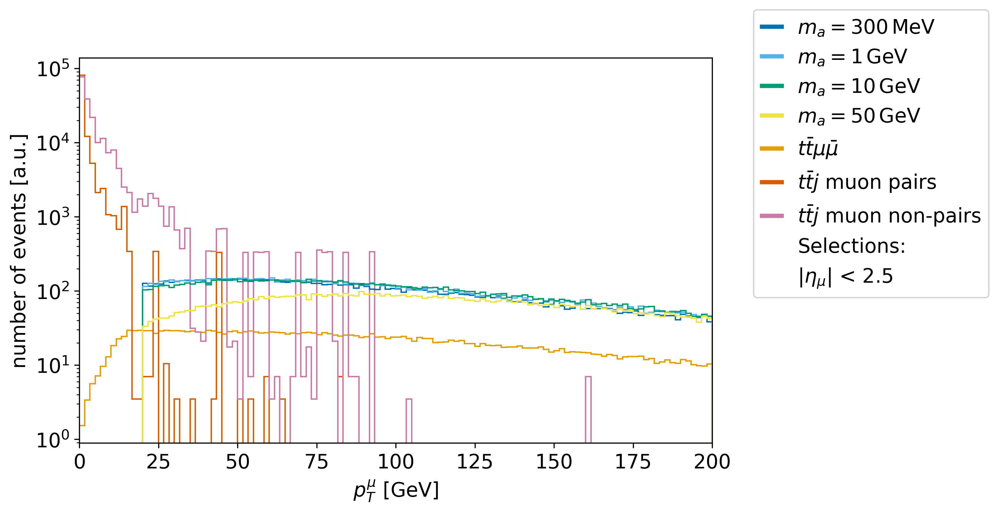

In [19]:
mypl.hist1dcross(data("inv_pt",["antimuon","muon"],"incl"),data("inv_pt",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["pT_mu"],customXlabels=labels2,nbins=120,customXlim=[0,200],log_scale=True,selLabel=selLabel)


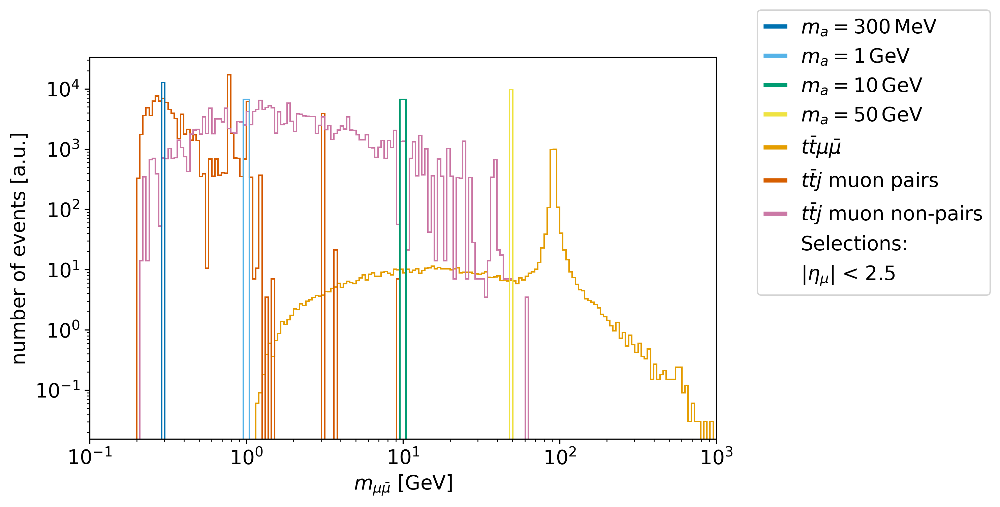

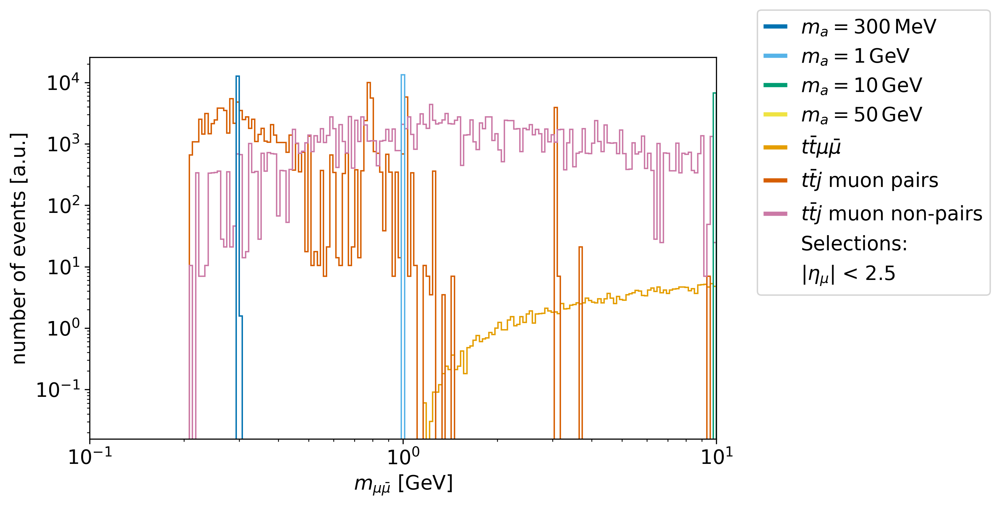

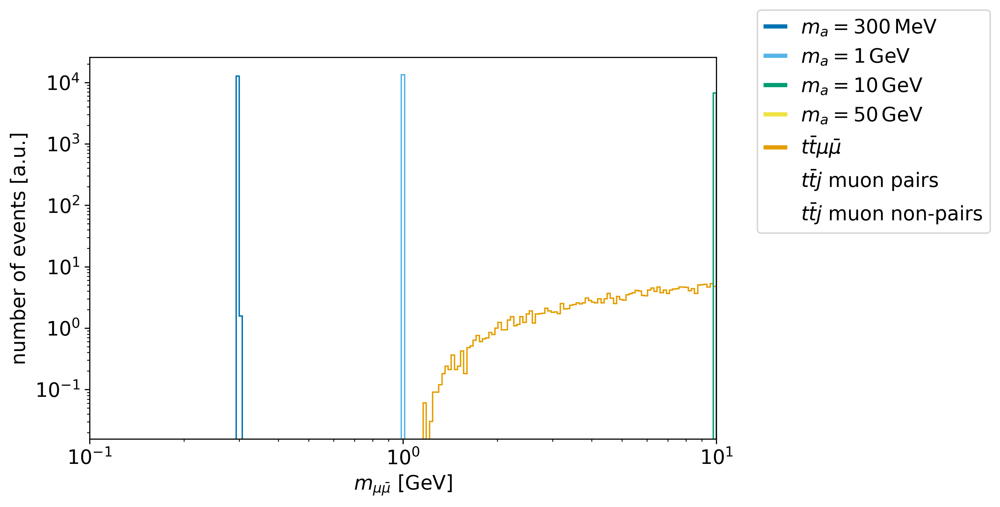

In [29]:

mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=200,
                customXlim=[0.1,1000],selLabel=selLabel)

mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=201,
                customXlim=[0.1,10],selLabel=selLabel)

mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"ttmumu"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=201,
                customXlim=[0.1,10],selLabel=selLabel)

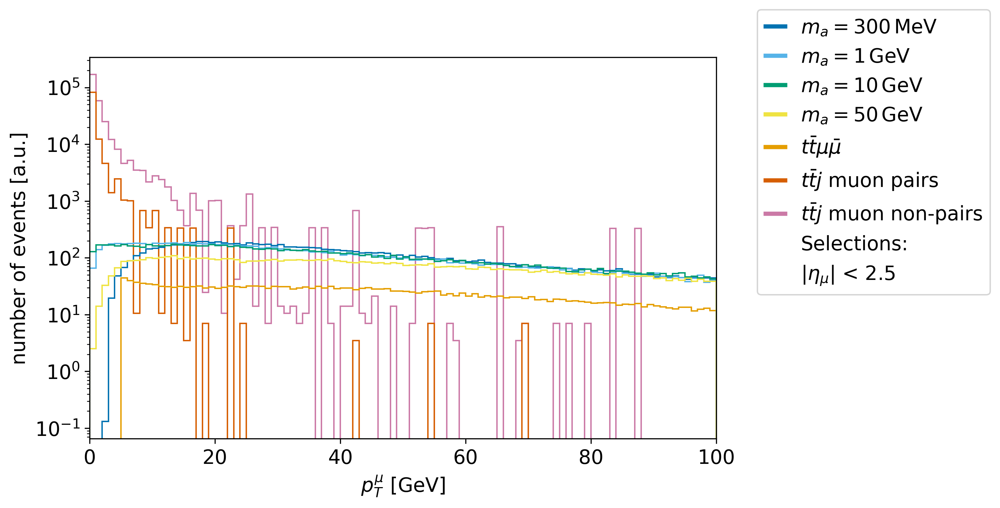

In [42]:
mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"ttmumu"),data("pT",["muon"],"ttj"),cross_incl,cross_ttmumu,cross_ttj,N_incl,N_ttmumu,N_ttj,intlumi,massLabels,dirLabel["pT_mu"],nbins=100,customXlim=[0,100],customXlabels=labels2,log_scale=True,stacked3=True,selLabel=selLabel)
mypl.hist1dcross(data("deltaR",["muon","antimuon"],"incl"),data("deltaR",["muon","antimuon"],"ttmumu"),data("deltaR",["muon","antimuon"],"ttj"),cross_incl,cross_ttmumu,cross_ttj,N_incl,N_ttmumu,N_ttj,intlumi,massLabels,dirLabel["deltaR_muons"],nbins=100,customXlim=[0,5],customXlabels=labels2,log_scale=True,stacked3=True,selLabel=selLabel,clip=True)

Different array lengths: 4, 3, 0, 4


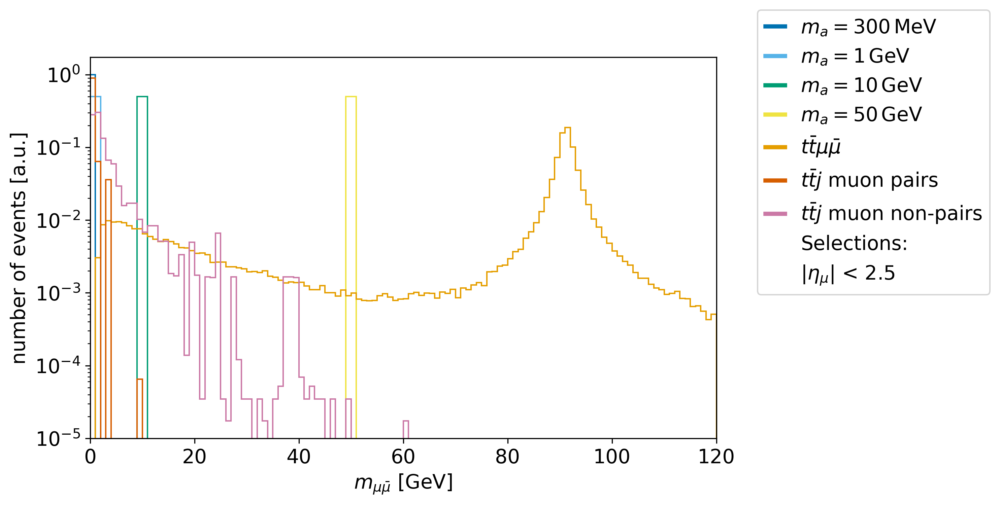

Different array lengths: 4, 3, 0, 4


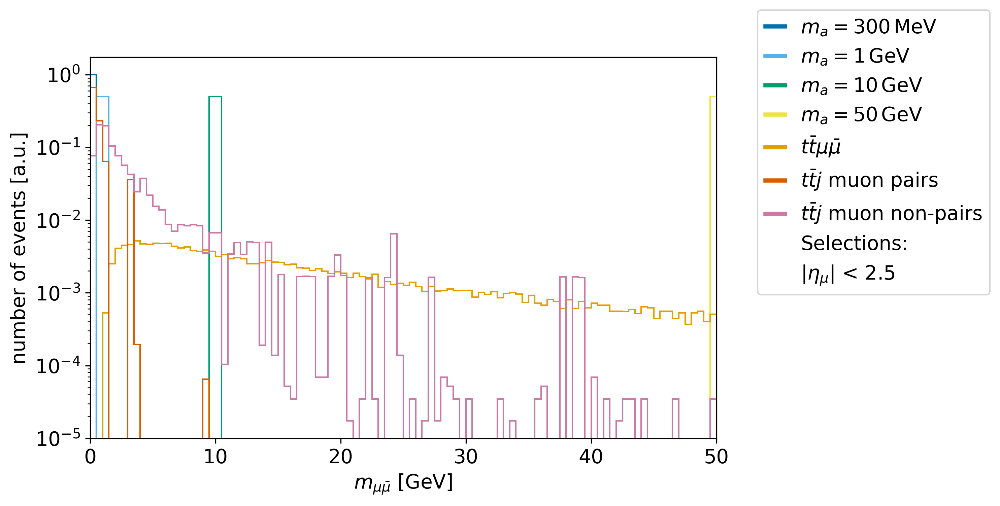

Different array lengths: 4, 1, 0, 4


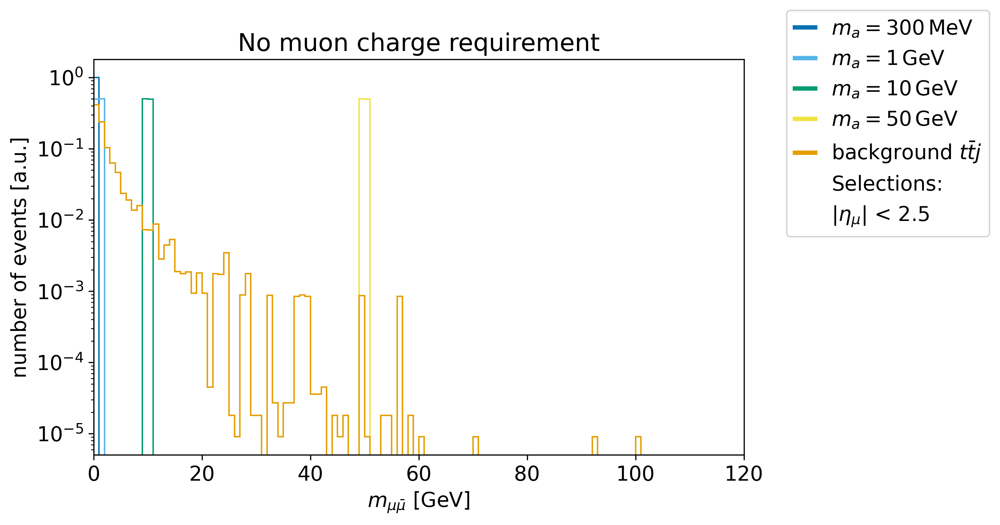

Different array lengths: 4, 3, 0, 4


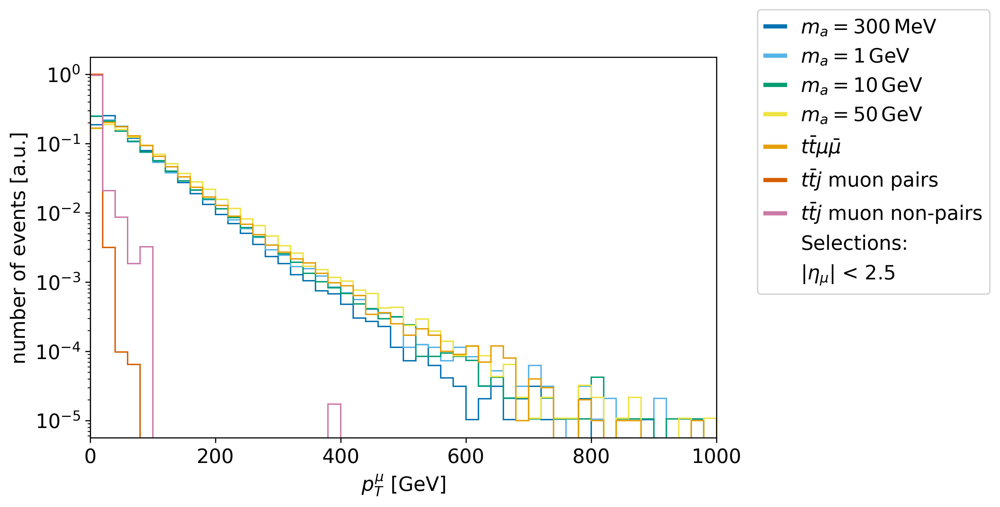

Different array lengths: 4, 3, 0, 4


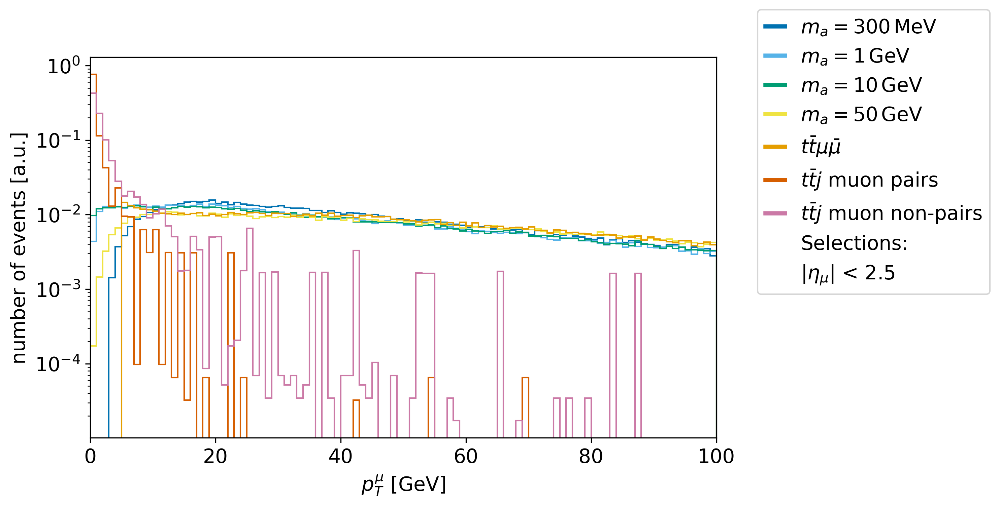

Different array lengths: 4, 1, 0, 4


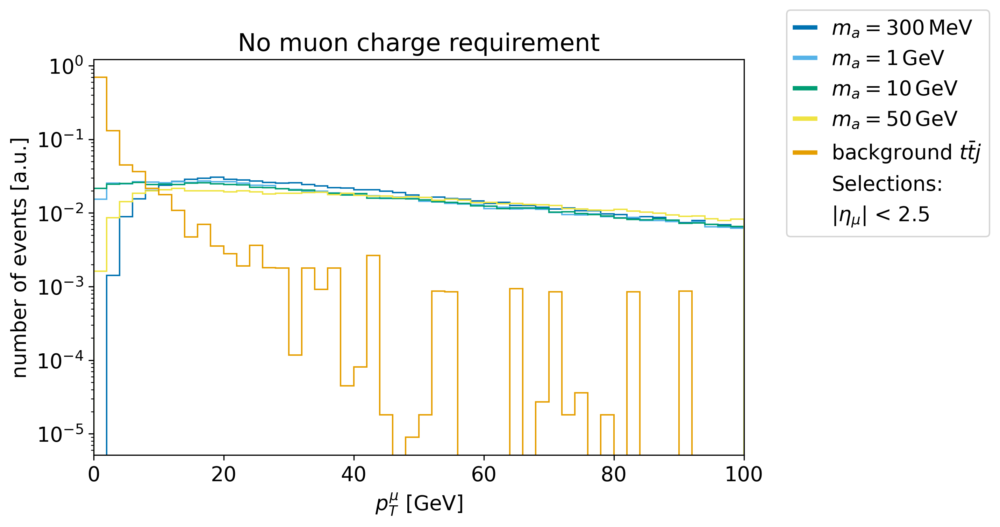

Different array lengths: 4, 3, 0, 4


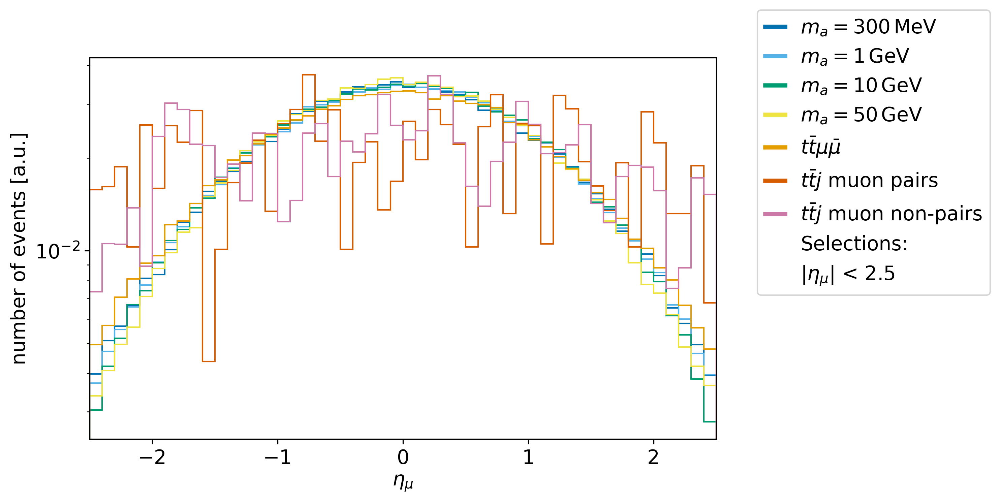

Different array lengths: 4, 1, 0, 4


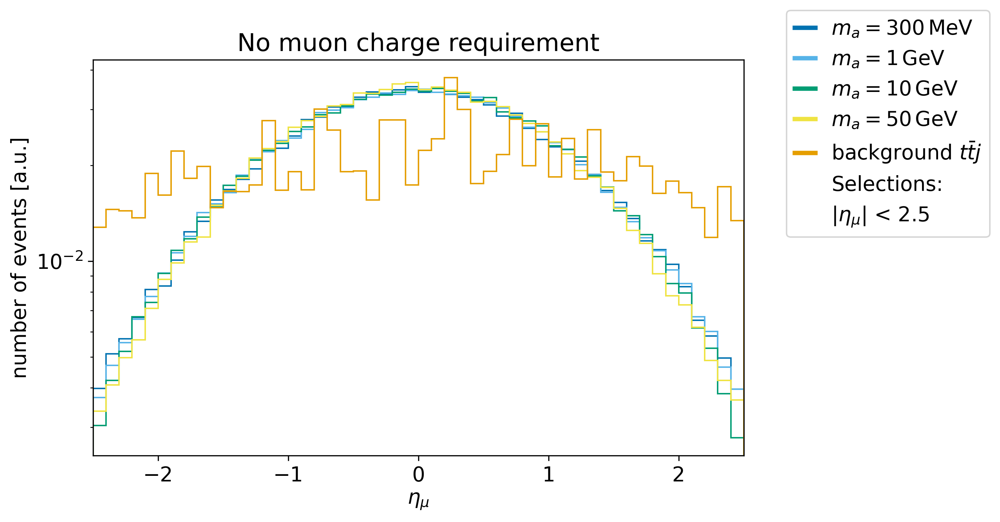

Different array lengths: 4, 3, 0, 4


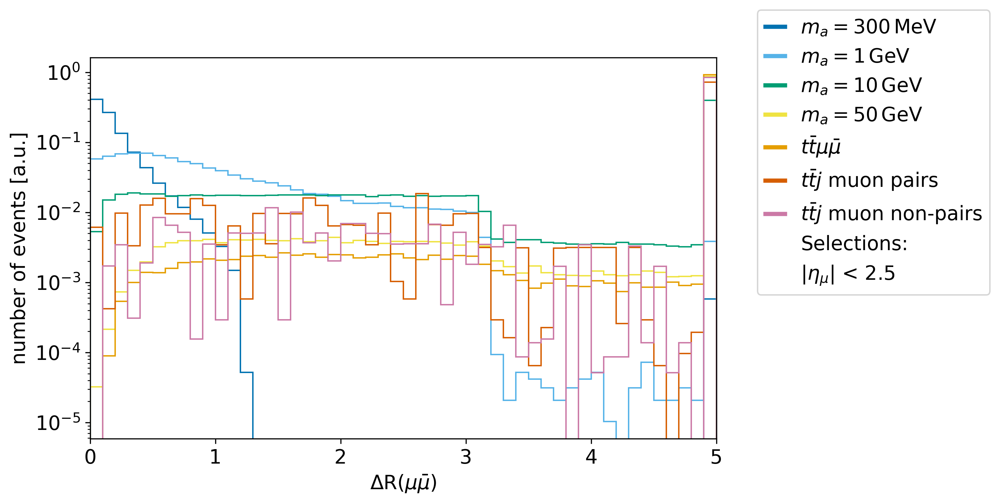

Different array lengths: 4, 1, 0, 4


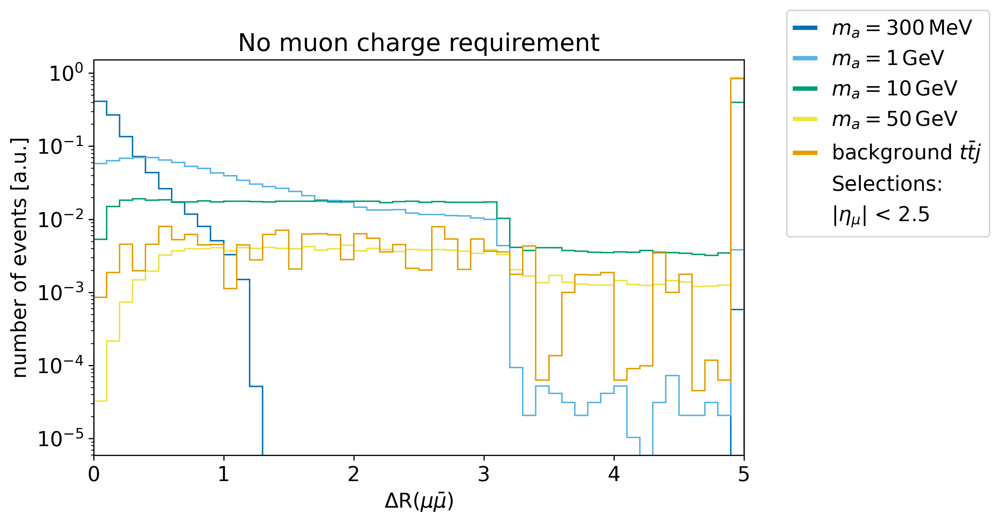

Different array lengths: 4, 3, 0, 4


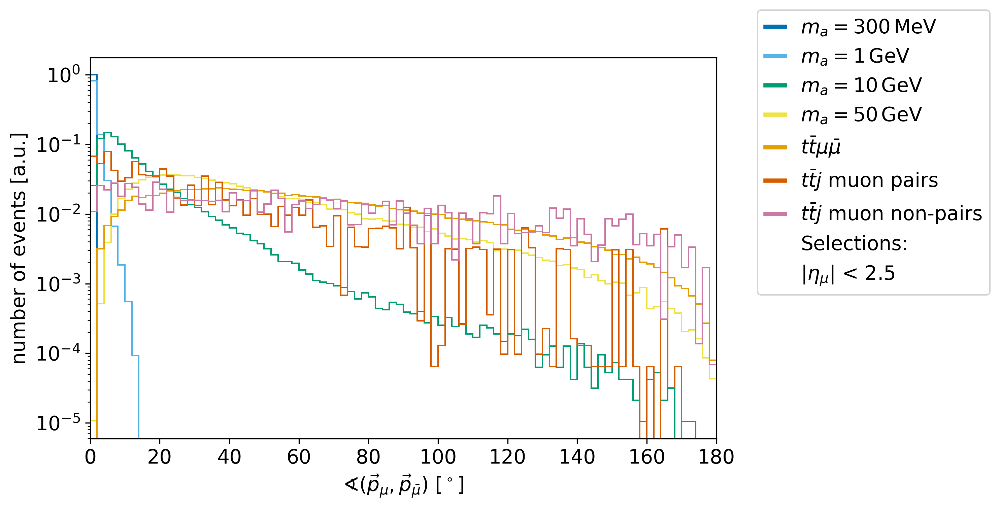

Different array lengths: 4, 1, 0, 4


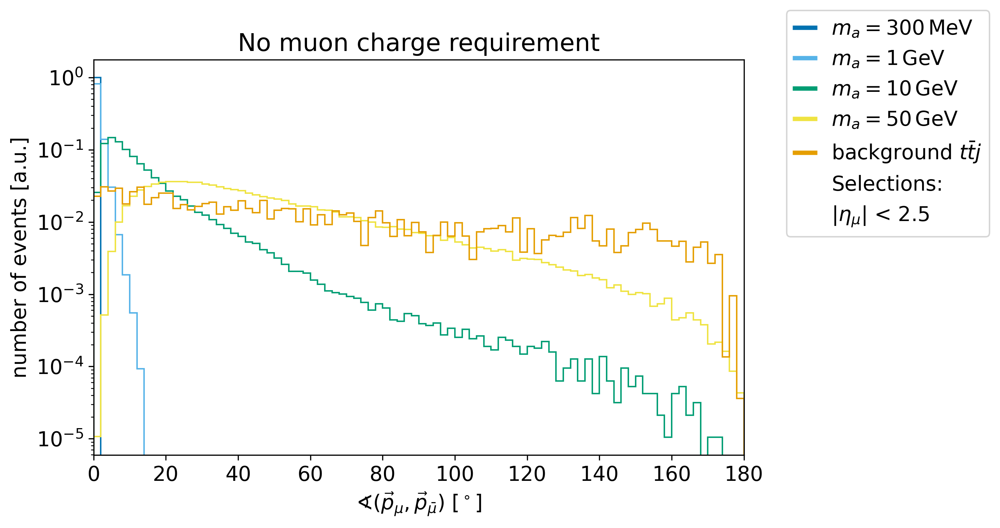

Different array lengths: 4, 3, 0, 4


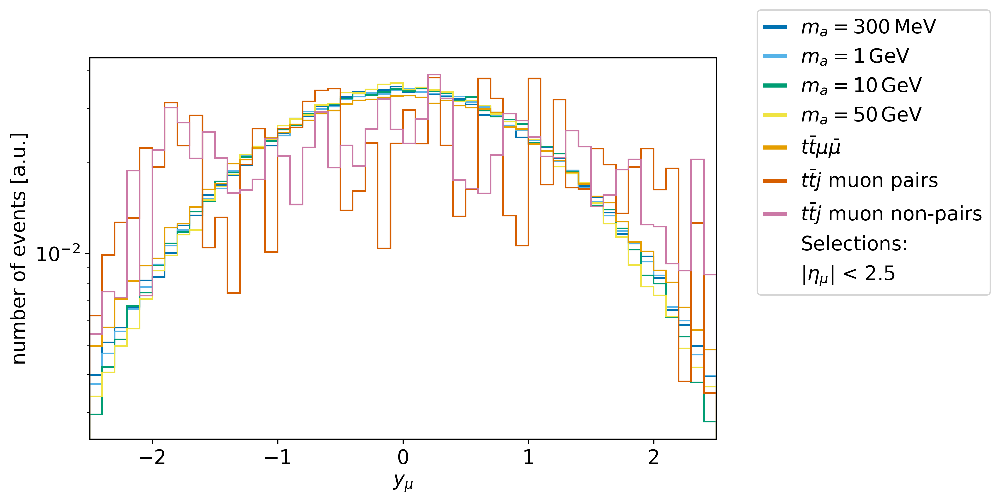

Different array lengths: 4, 1, 0, 4


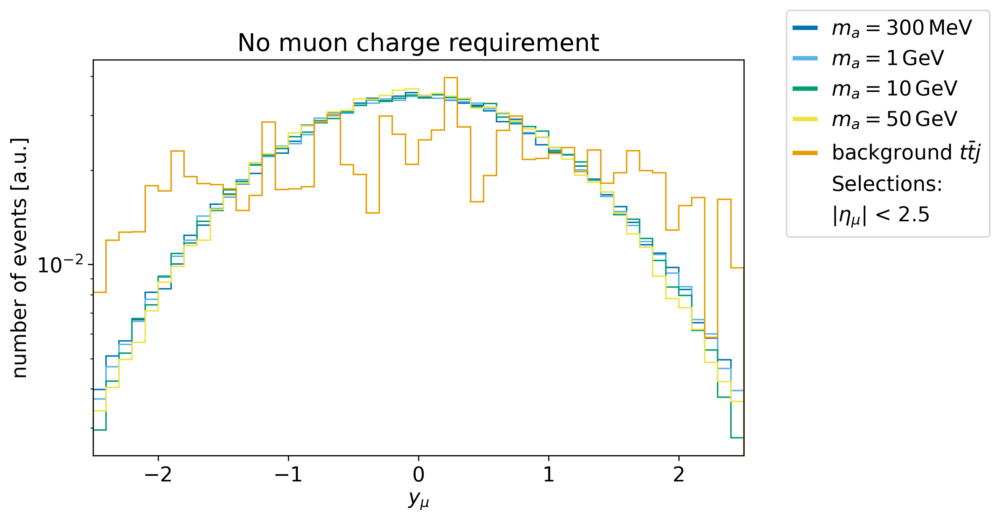

In [19]:
plot_raw_events(massLabels2, labels2, labels_ttj, selLabel)

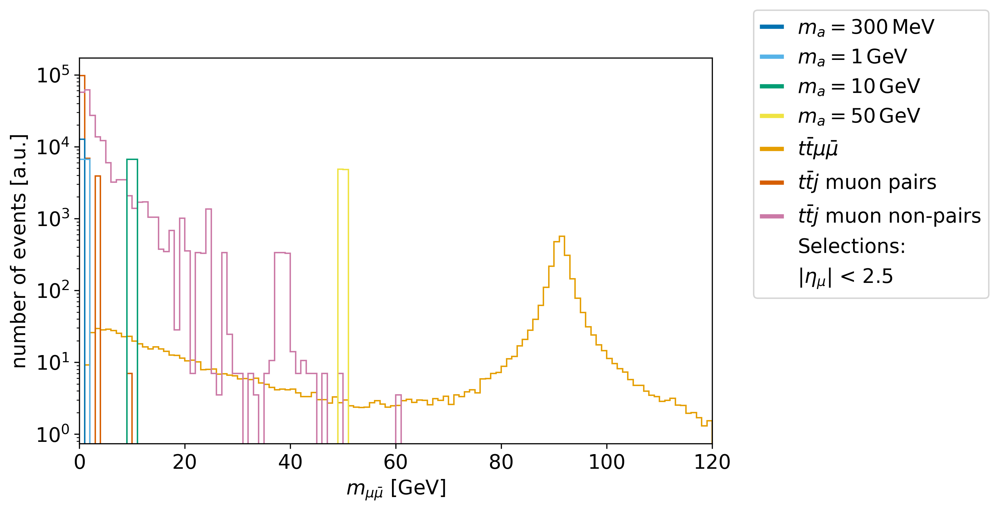

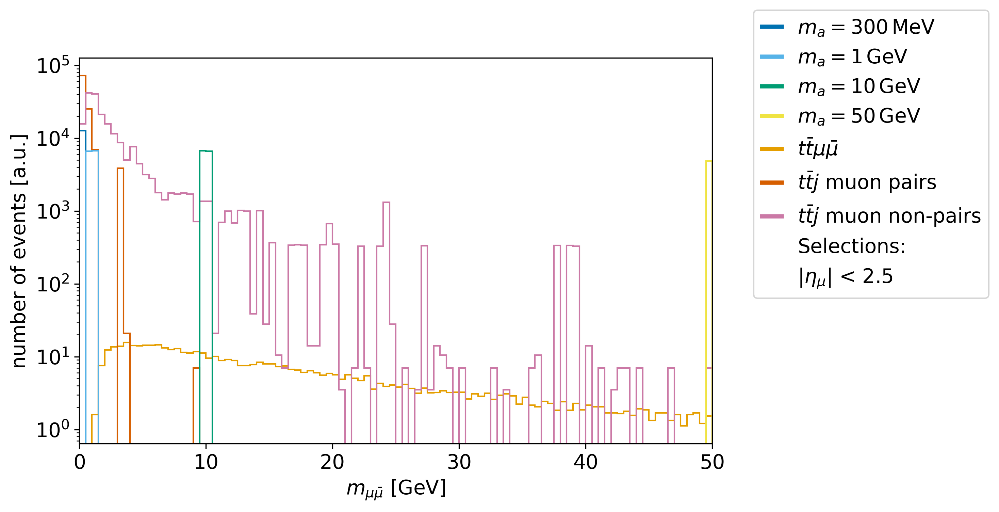

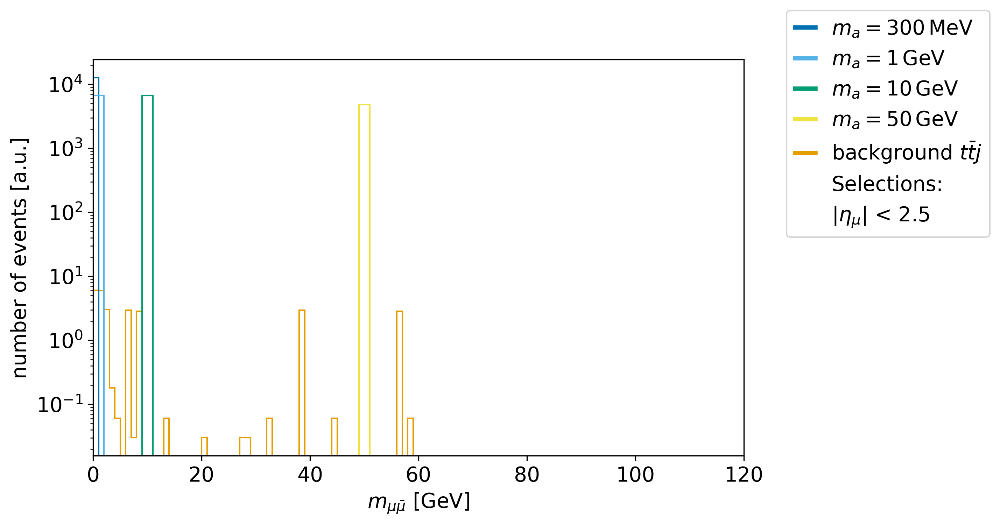

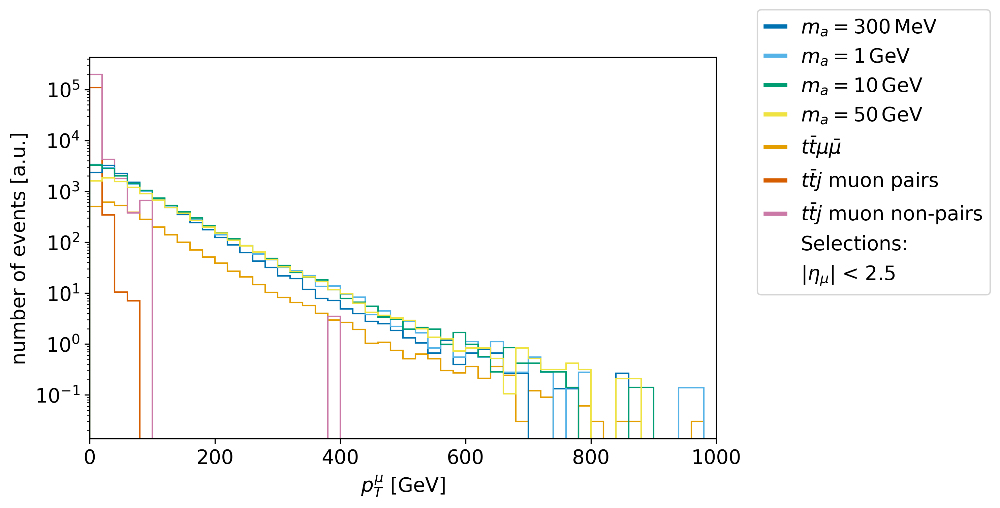

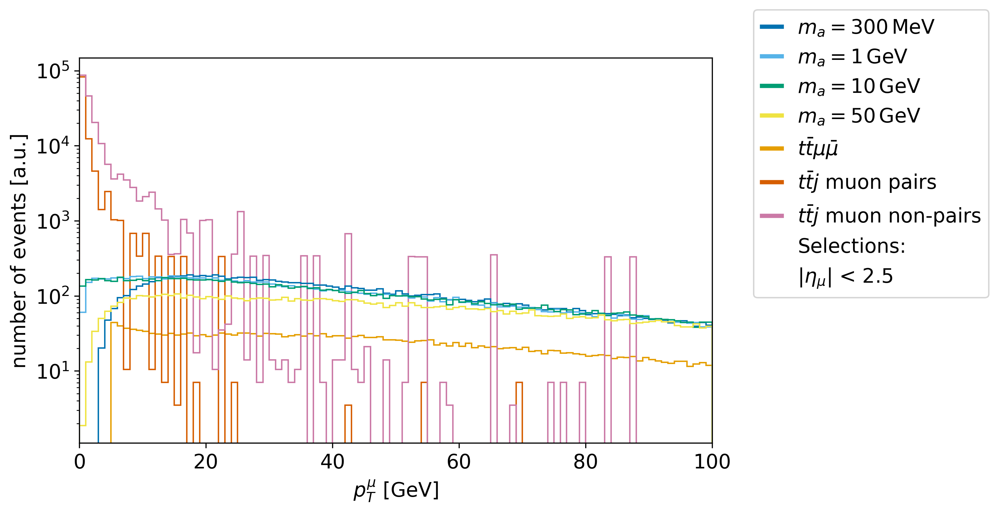

...

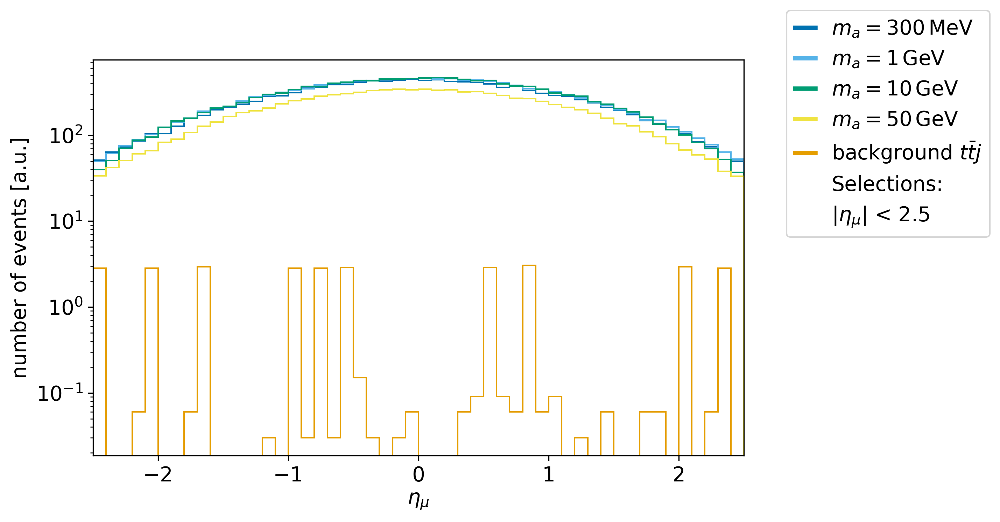

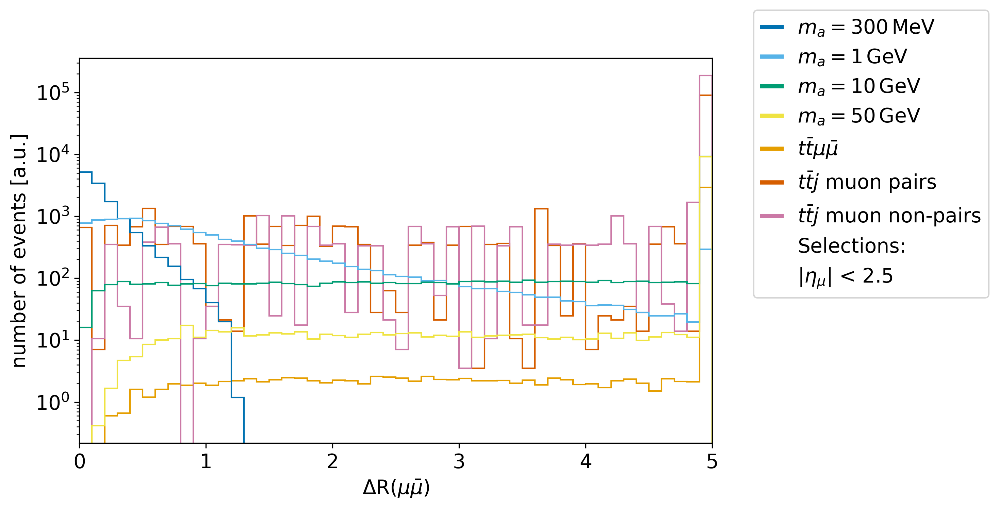

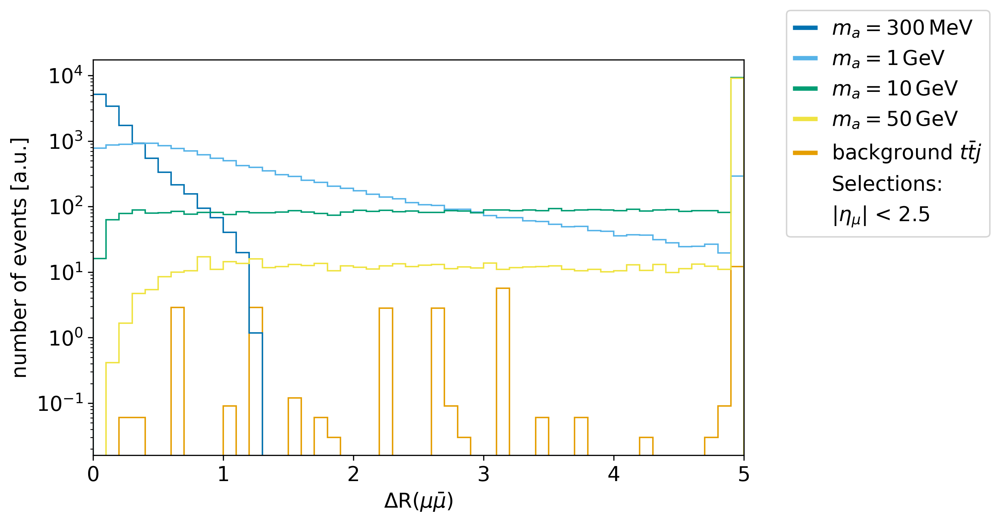

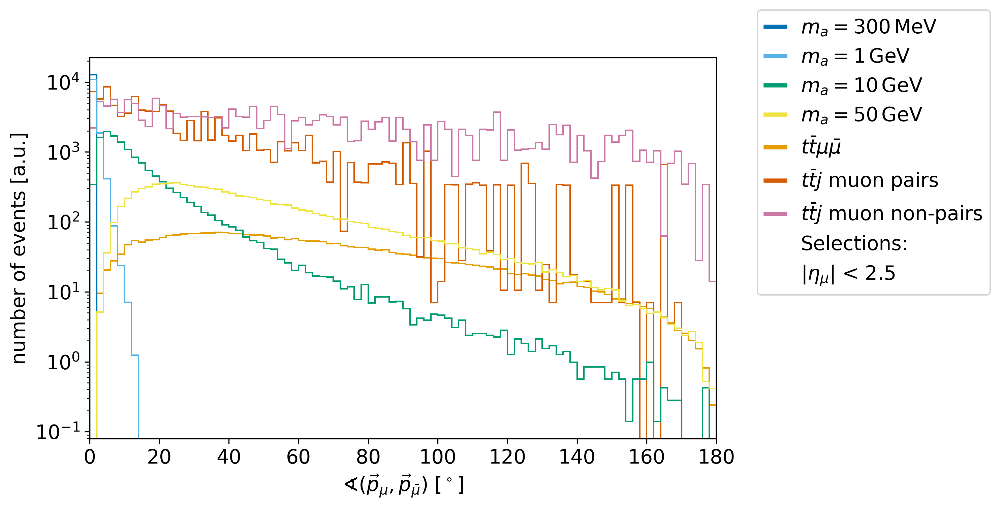

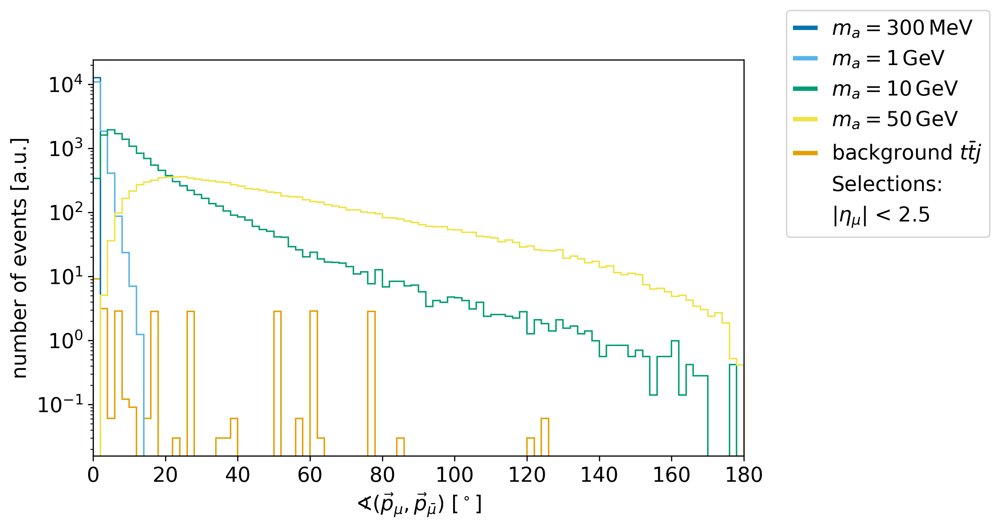

In [25]:
plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels2,labels2,labels_ttj,selLabel)

Different array lengths: 4, 3, 0, 4


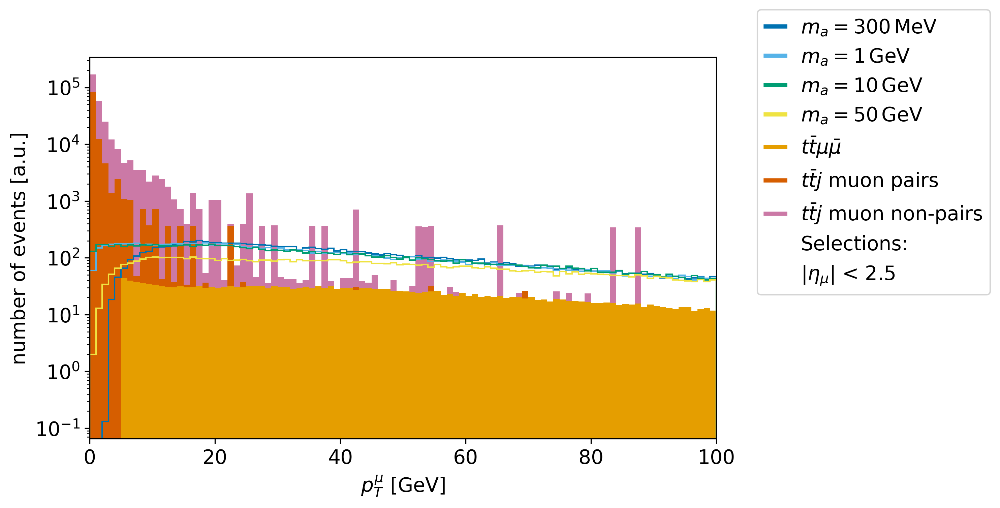

Different array lengths: 4, 3, 0, 4


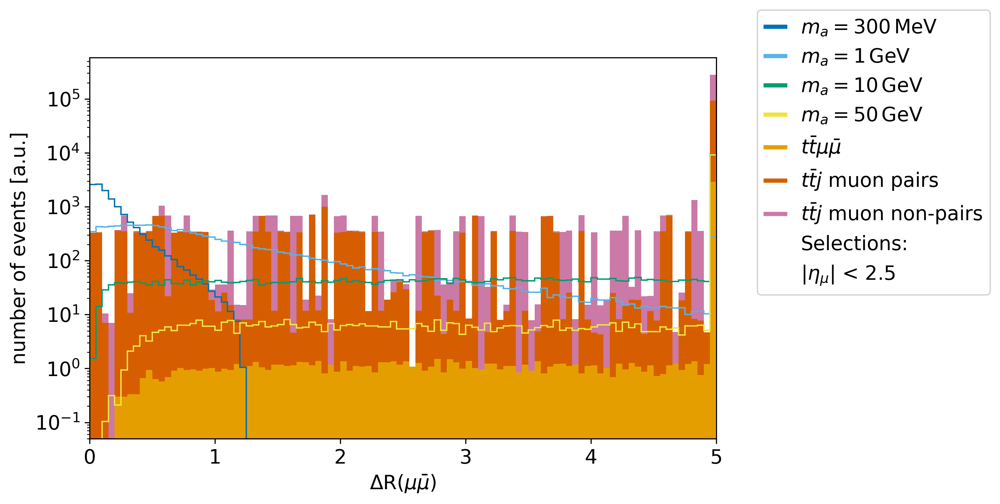

In [18]:
mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels2,dirLabel["pT_mu"],customXlabels=labels2,nbins=100,customXlim=[0,100],log_scale=True,stacked2=True,selLabel=selLabel)
mypl.hist1dcross(data("deltaR",["muon","antimuon"],"incl"),data("deltaR",["muon","antimuon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels2,dirLabel["deltaR_muons"],customXlabels=labels2,nbins=100,customXlim=[0,5],log_scale=True,selLabel=selLabel,clip=True,stacked2=True)


# Starting to make selections

### Muon pT > 10 GeV

In [43]:
selLabel += [r"$p_T^{\mu}$ > 10 GeV"]
sel = ((lambda x: x>10),"pT", ["muon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
data_ttj_charge = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]
sel = ((lambda x: x>10),"pT", ["antimuon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
data_ttj_charge = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]
print(data_inclusive)
print(data_bkg)

print("signal")
get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
print("background")
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)
s = get_figure_of_merit(data_inclusive[0],cross_incl[0],N_incl[0],[data_bkg[1]],[cross_bkg[1]],[N_bkg[1]],intlumi)
print("Figure of merit:   ", s)

[This Dataset contains 87399 events., This Dataset contains 73126 events., This Dataset contains 71789 events., This Dataset contains 80821 events.]
[This Dataset contains 89137 events., This Dataset contains 105 events., This Dataset contains 509 events.]
signal
Expected number of events:  11517.999573599998  +-  38.960437613125954
Expected number of events:  10124.4811713  +-  37.44008861626094
Expected number of events:  10098.920446559998  +-  37.69172373050409
Expected number of events:  8427.743533755001  +-  29.644846177672292
background
Expected number of events:  2685.7076150699995  +-  8.995591468597091
Expected number of events:  368.429825925  +-  35.955069399662285
Expected number of events:  1786.0074418649997  +-  79.16338805684623
Figure of merit:    105.48616333263034


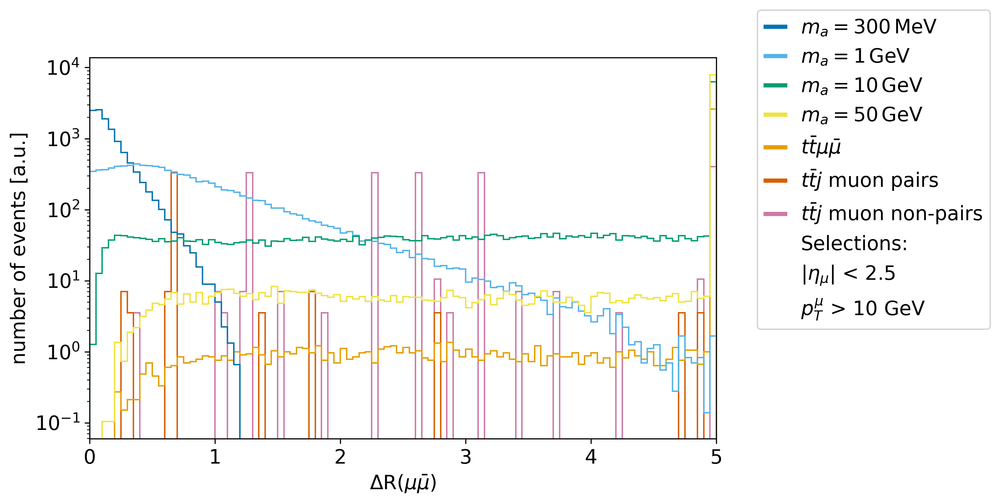

In [45]:
data_ttmumu = [data_bkg[0]]
data_ttj = [data_bkg[1],data_bkg[2]]
mypl.hist1dcross(data("deltaR",["muon","antimuon"],"incl"),data("deltaR",["muon","antimuon"],"ttmumu"),data("deltaR",["muon","antimuon"],"ttj"),cross_incl,cross_ttmumu,cross_ttj,N_incl,N_ttmumu,N_ttj,intlumi,massLabels,dirLabel["deltaR_muons"],nbins=100,customXlim=[0,5],customXlabels=labels2,log_scale=True,stacked3=True,selLabel=selLabel,clip=True)

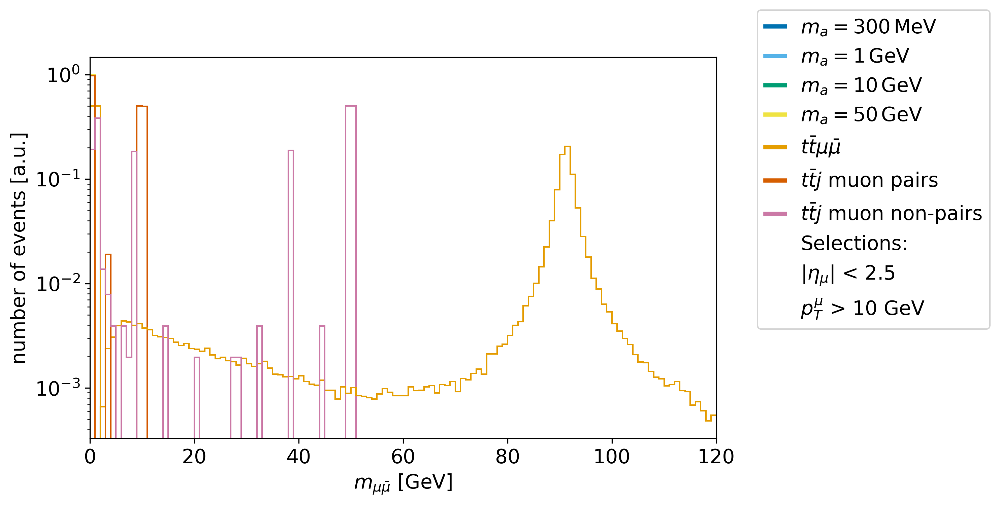

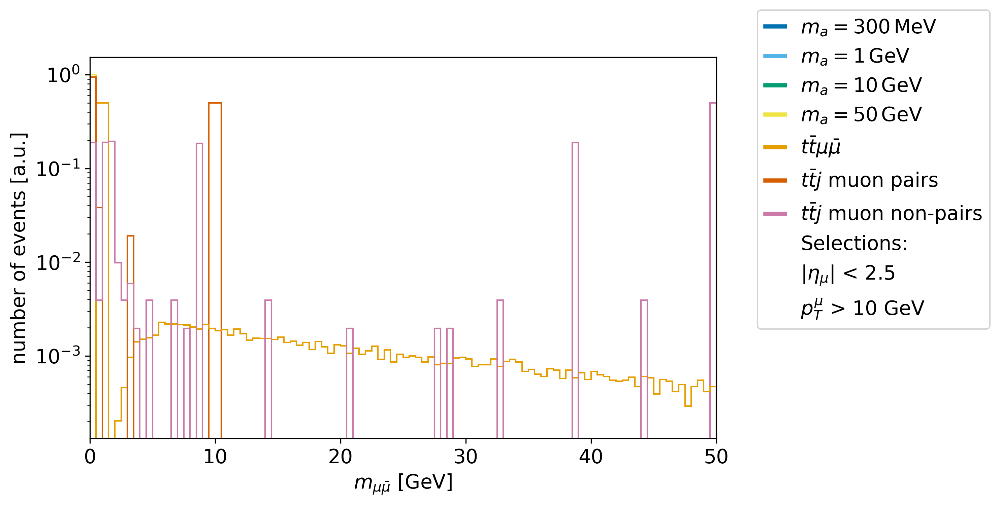

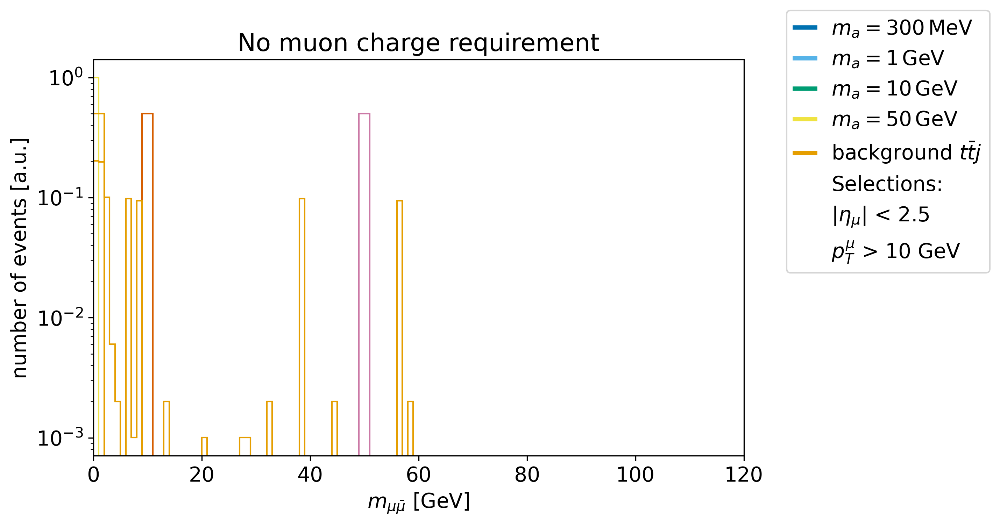

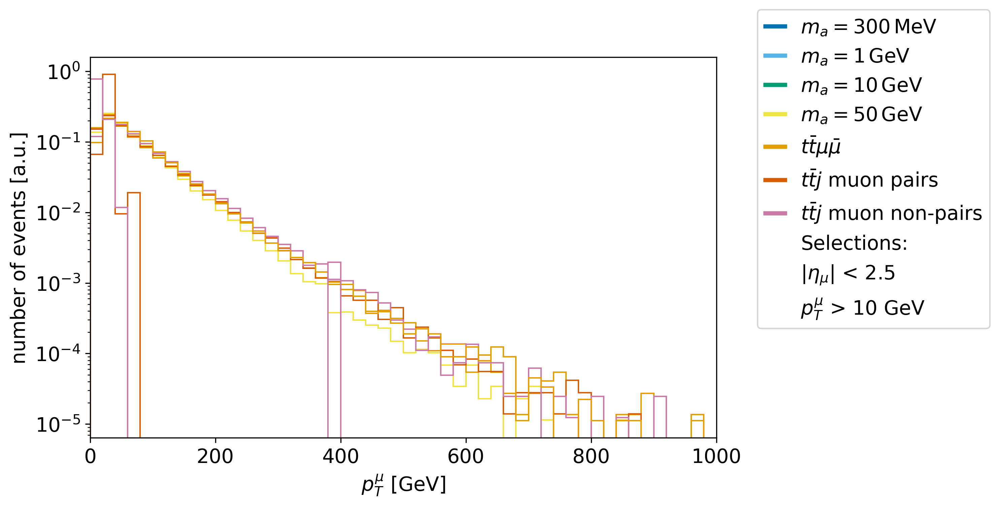

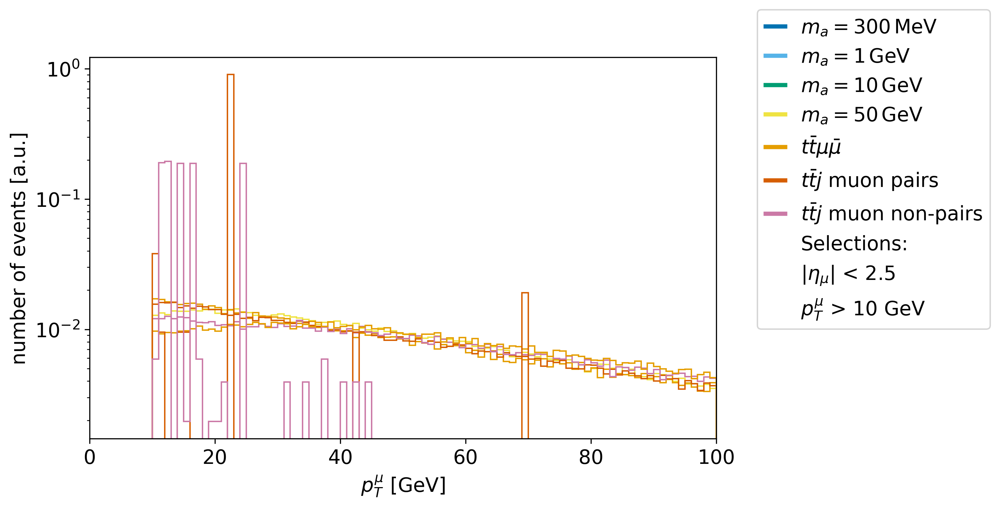

...

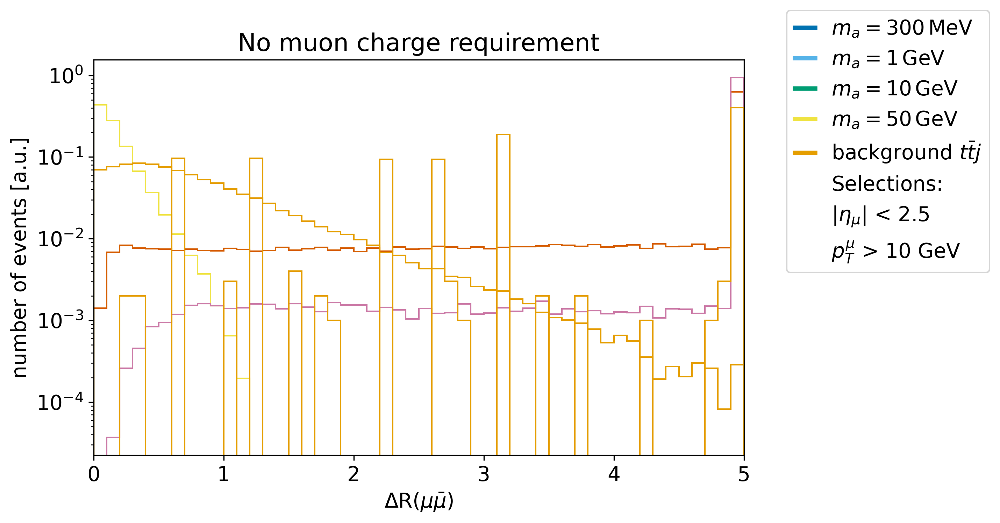

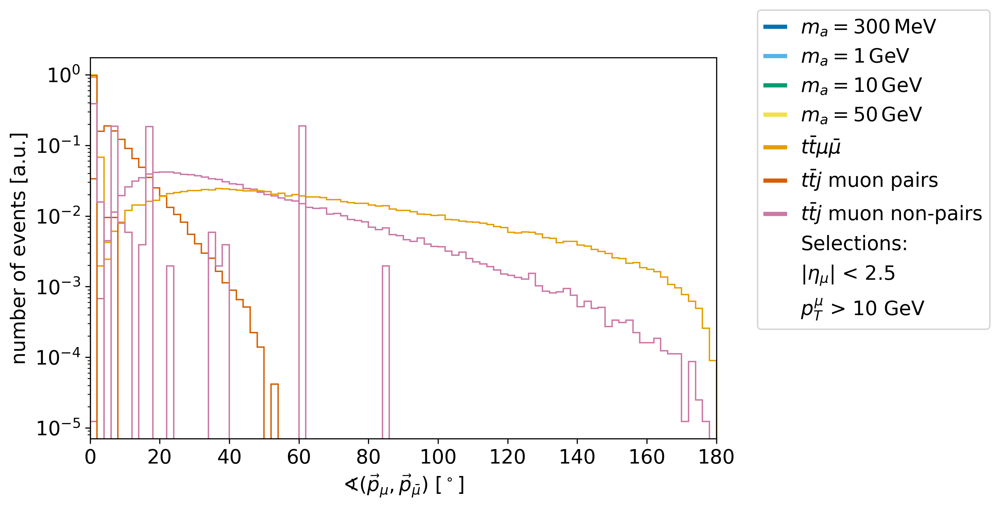

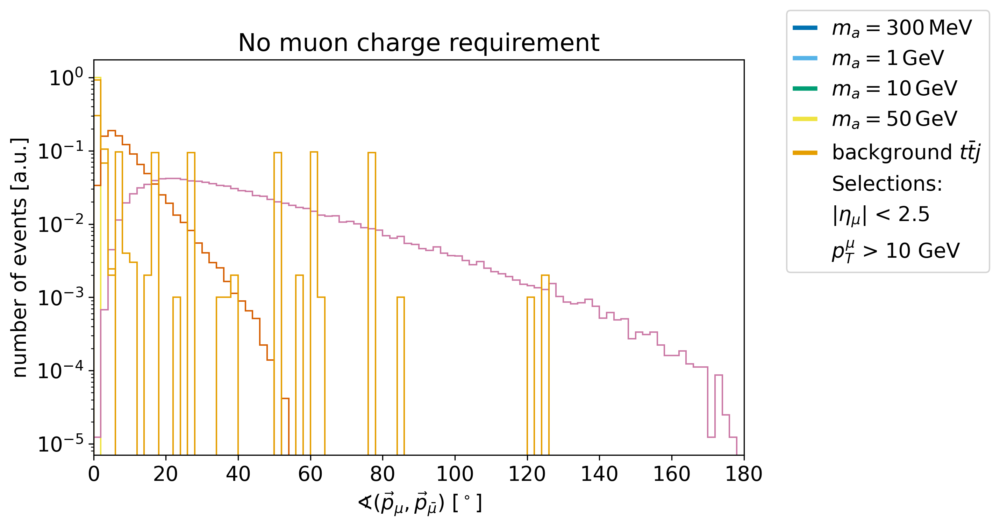

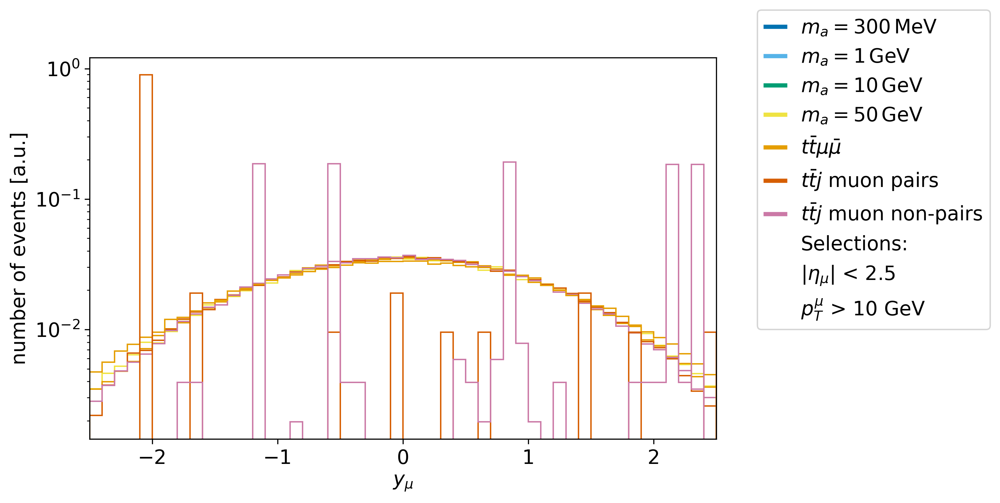

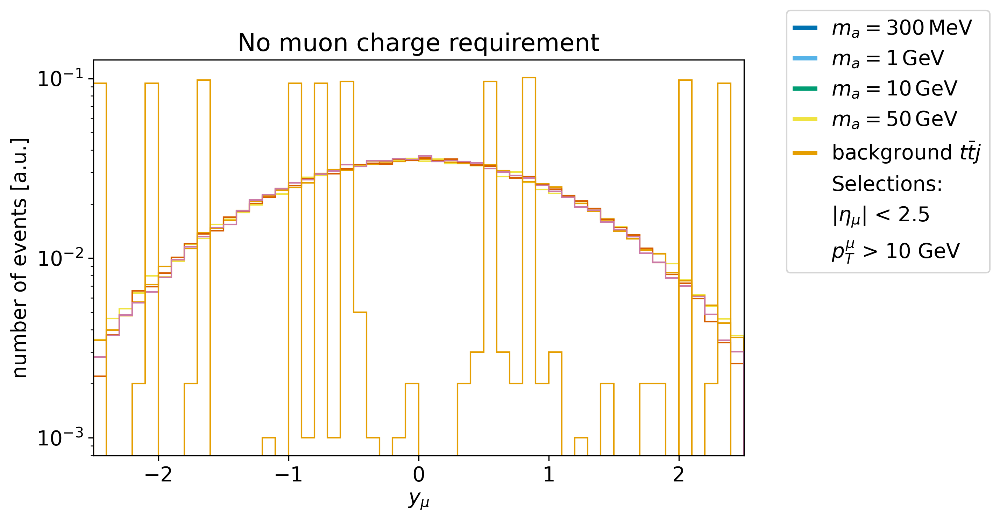

In [21]:
plot_raw_events(massLabels2, labels2, labels_ttj, selLabel)

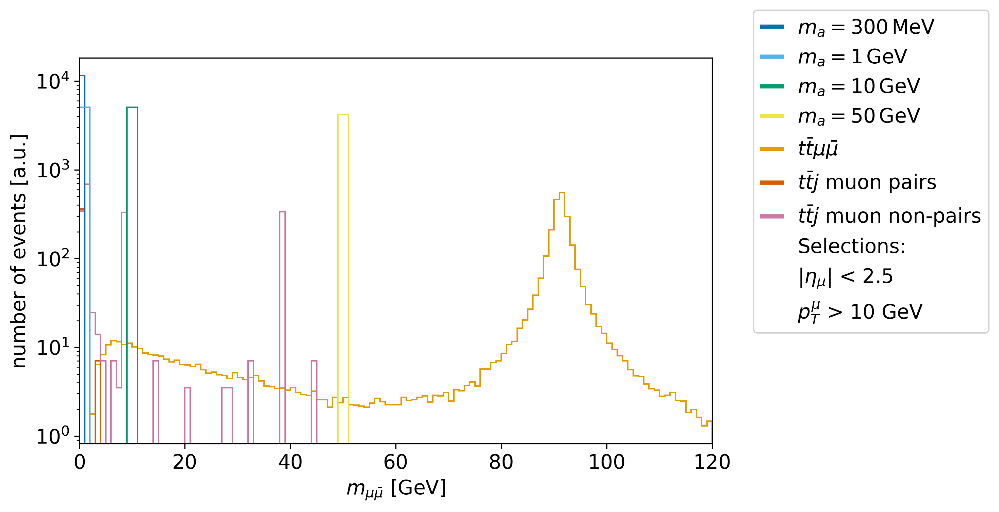

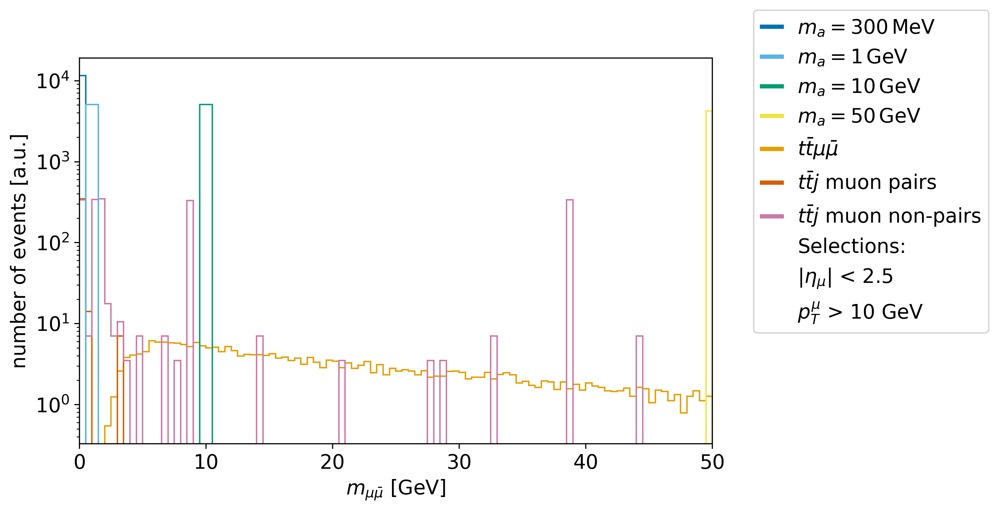

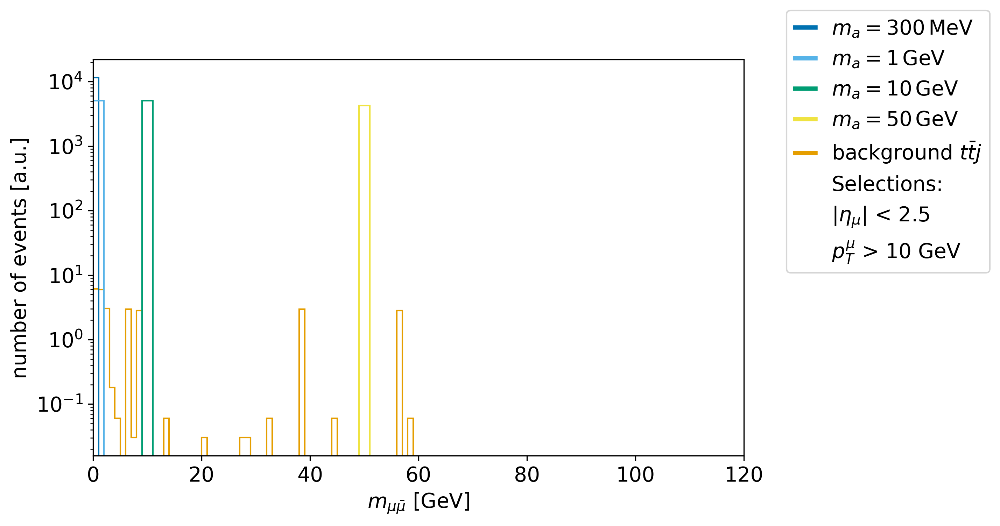

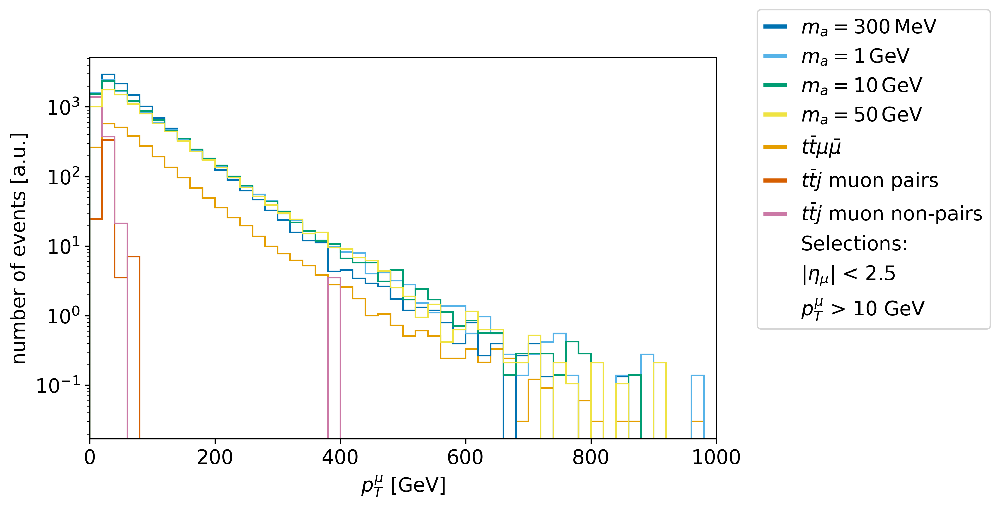

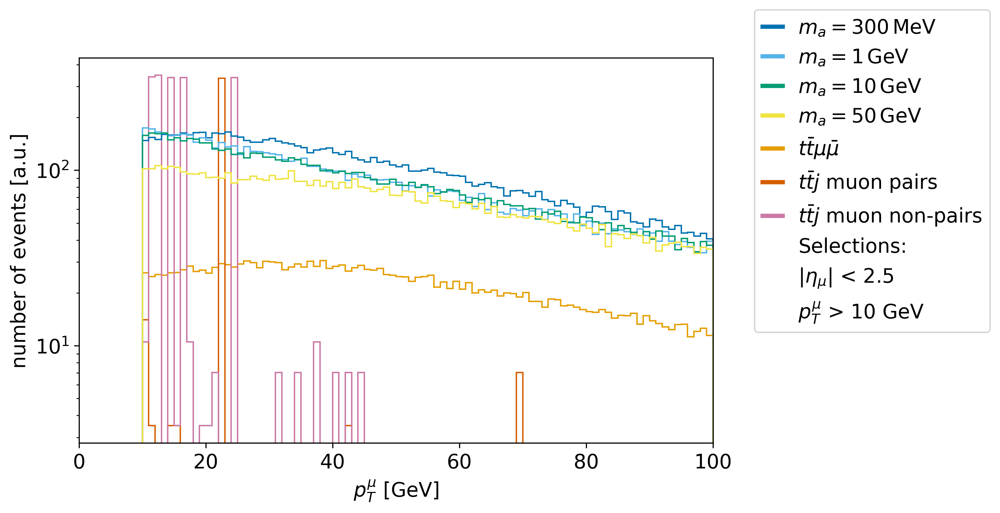

...

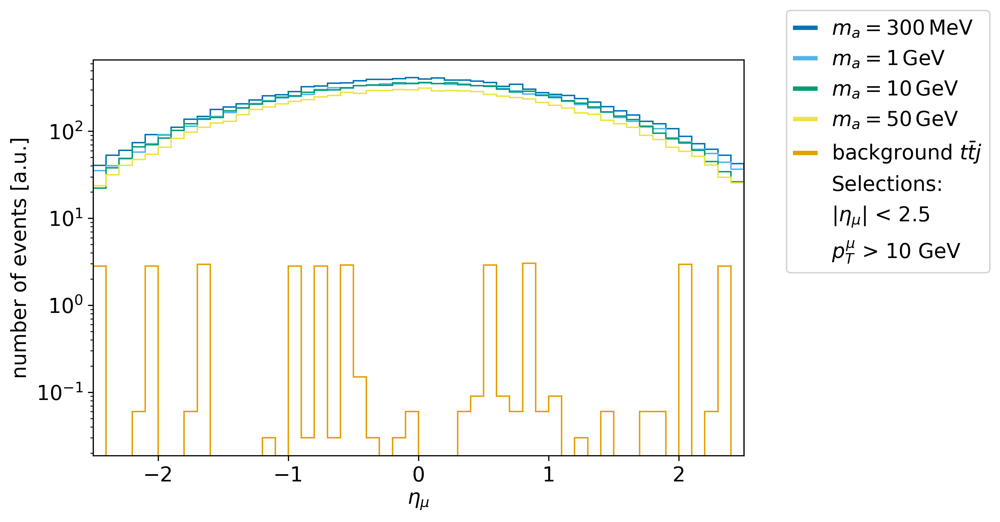

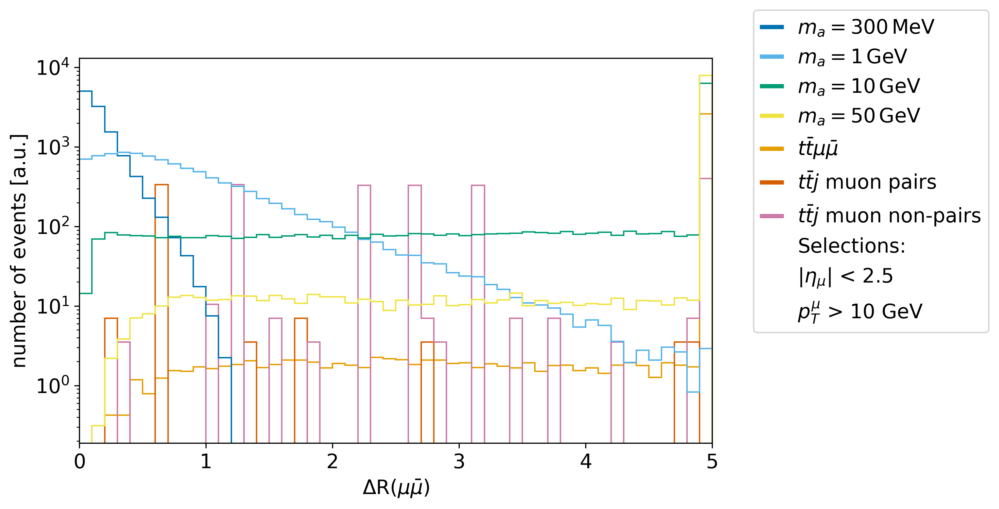

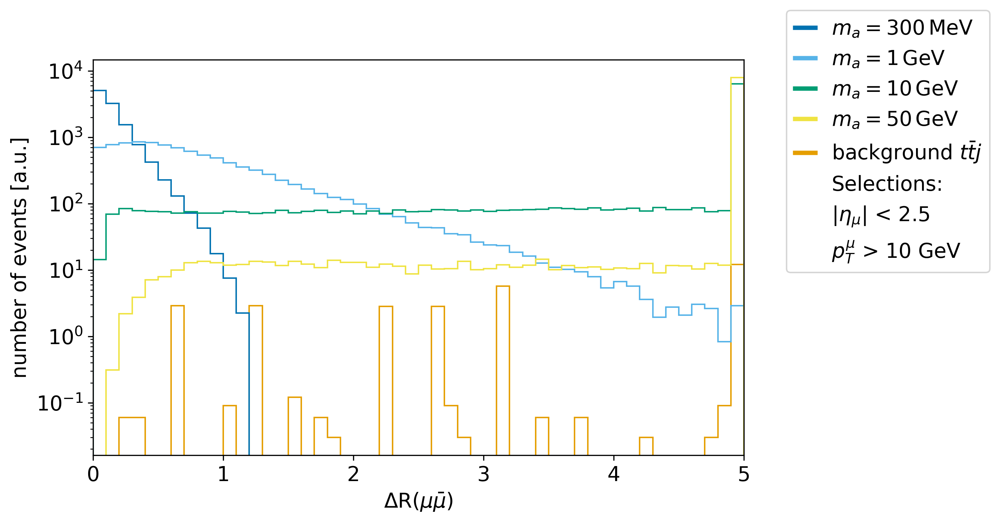

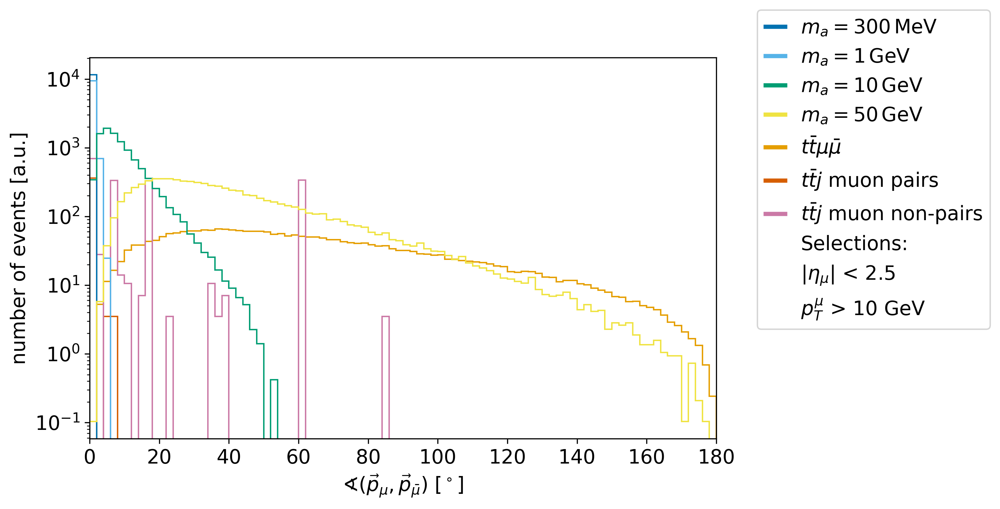

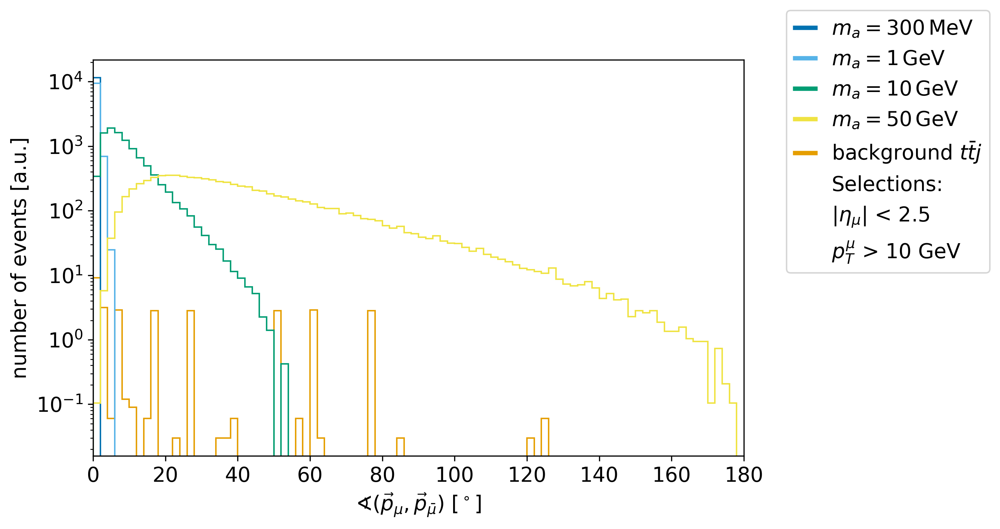

In [22]:
plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels2,labels2,labels_ttj,selLabel)

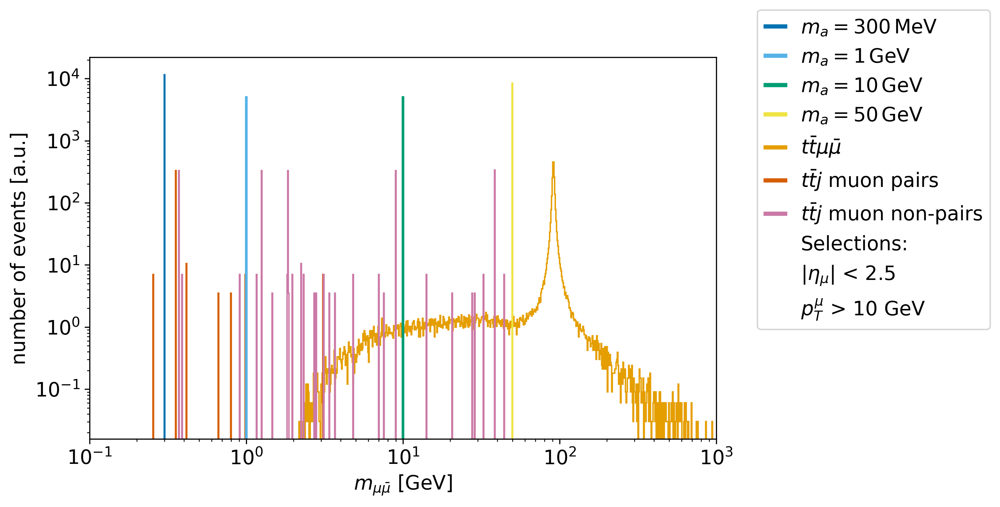

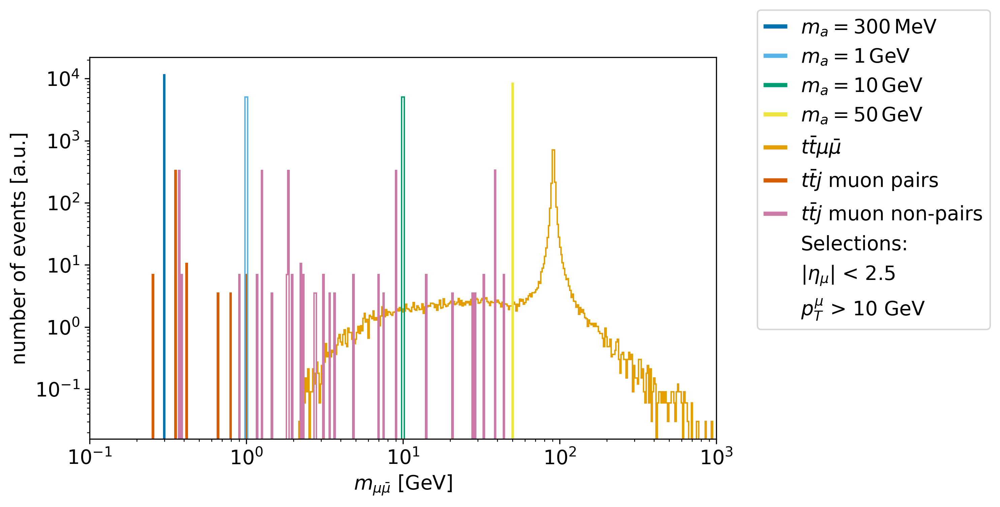

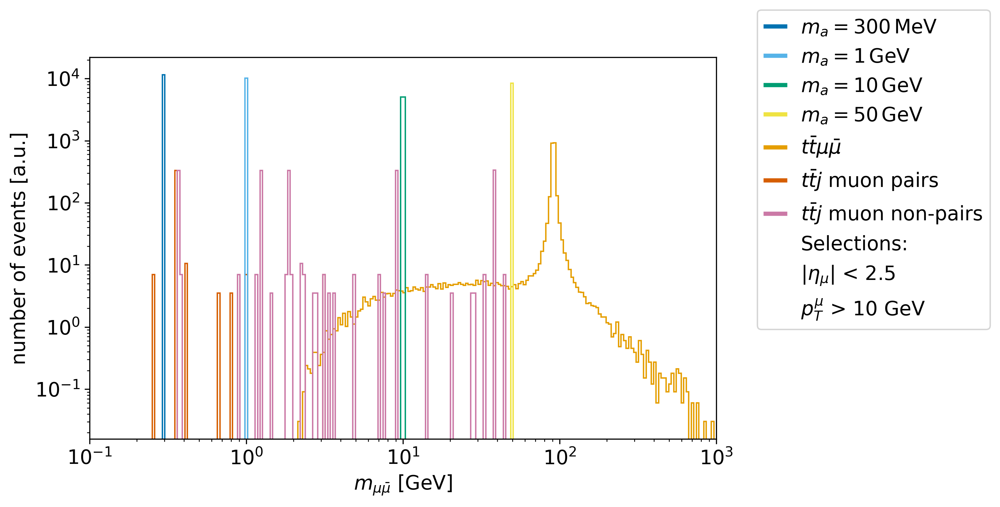

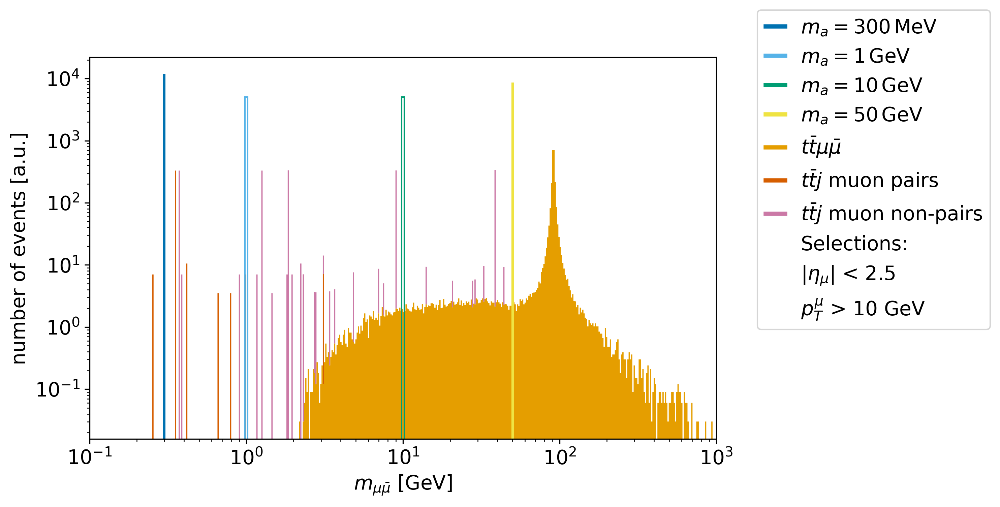

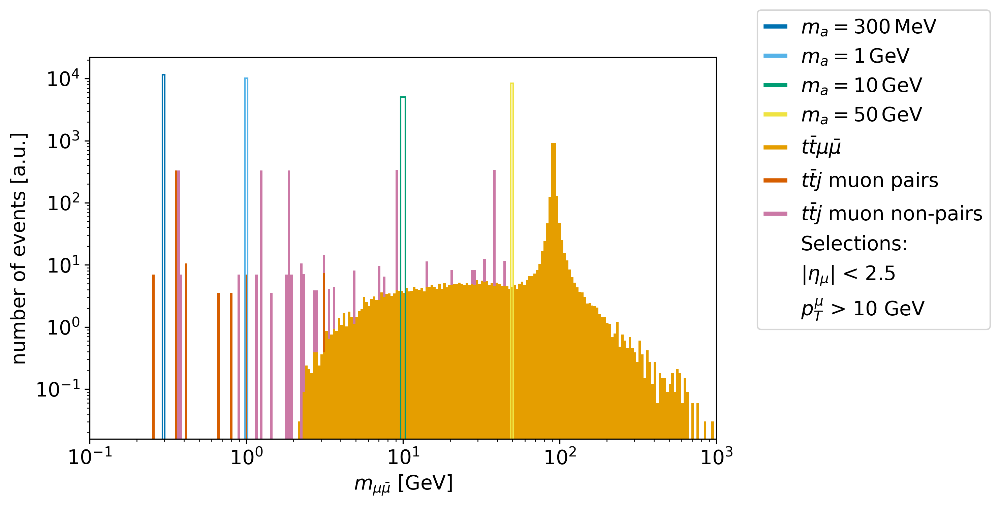

In [23]:
mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=1000,
                customXlim=[0.1,1000],selLabel=selLabel)
mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=500,
                customXlim=[0.1,1000],selLabel=selLabel)
mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=250,
                customXlim=[0.1,1000],selLabel=selLabel)
mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=500,
                customXlim=[0.1,1000],selLabel=selLabel,stacked2=True)
mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=250,
                customXlim=[0.1,1000],selLabel=selLabel,stacked2=True)

### Muon DeltaR > 0.2
To accomodate requirement for ttmumu background

In [33]:
selLabel += [r"$\Delta$R($\mu\bar{\mu}$) > 0.2"]
sel = ((lambda x: x>0.2),"deltaR", ["muon","antimuon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
#data_boosted = [dc.Dataset.event_selection(ds,sel) for ds in data_boosted]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
data_ttj_charge = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]
print(data_inclusive)
#print(data_boosted)
print(data_bkg)
print(data_ttj_charge)

get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)
get_expected_events(data_ttj_charge, cross_ttj_charge, intlumi, N_ttj_charge)
s = get_figure_of_merit(data_inclusive[0],cross_incl[0],N_incl[0],data_bkg,cross_bkg,N_bkg,intlumi)
print("Figure of merit:   ", s)

[This Dataset contains 24611 events., This Dataset contains 62144 events., This Dataset contains 71323 events., This Dataset contains 81188 events.]
[This Dataset contains 89137 events., This Dataset contains 105 events., This Dataset contains 509 events.]
[This Dataset contains 999 events.]
Expected number of events:  3243.3950904  +-  20.674509975849258
Expected number of events:  8603.9952672  +-  34.51441850780296
Expected number of events:  10033.365877919998  +-  37.56919145005692
Expected number of events:  8466.013066140004  +-  29.71207706848132
Expected number of events:  2685.7076150699995  +-  8.995591468597091
Expected number of events:  368.429825925  +-  35.955069399662285
Expected number of events:  1786.0074418649997  +-  79.16338805684623
Expected number of events:  3505.346629515  +-  110.9042593762745
Figure of merit:    35.880920490621044


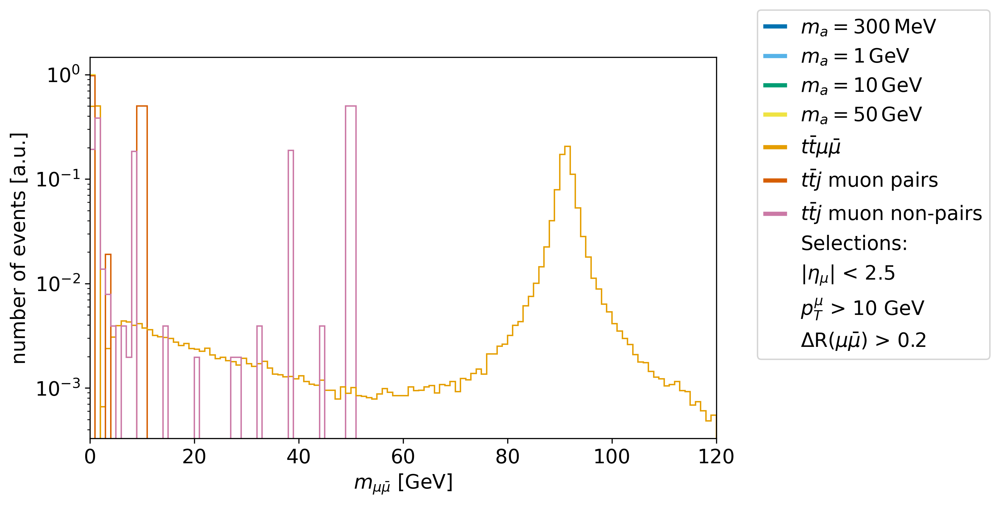

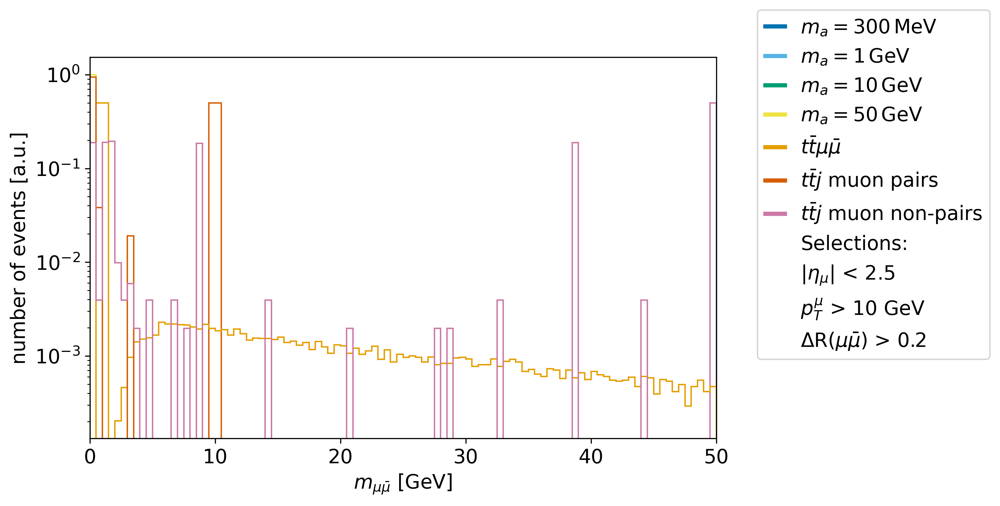

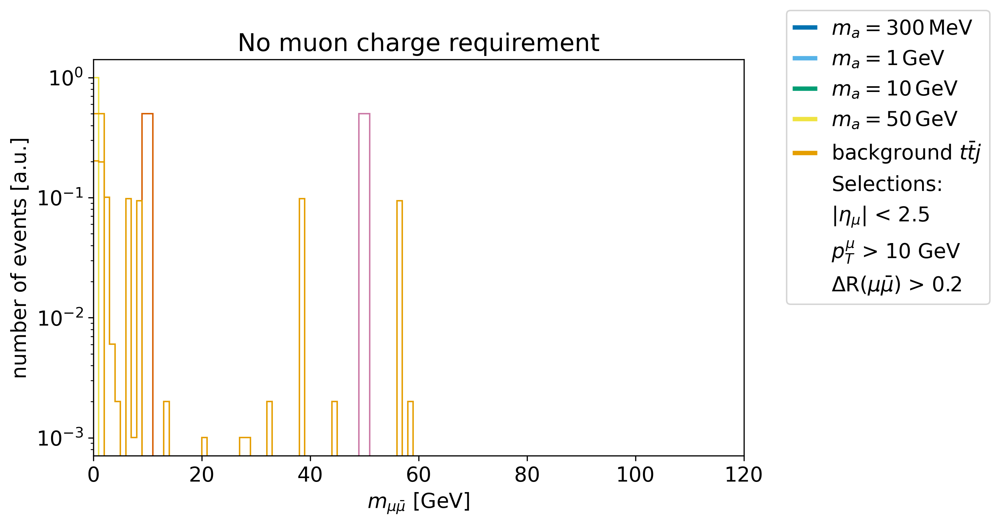

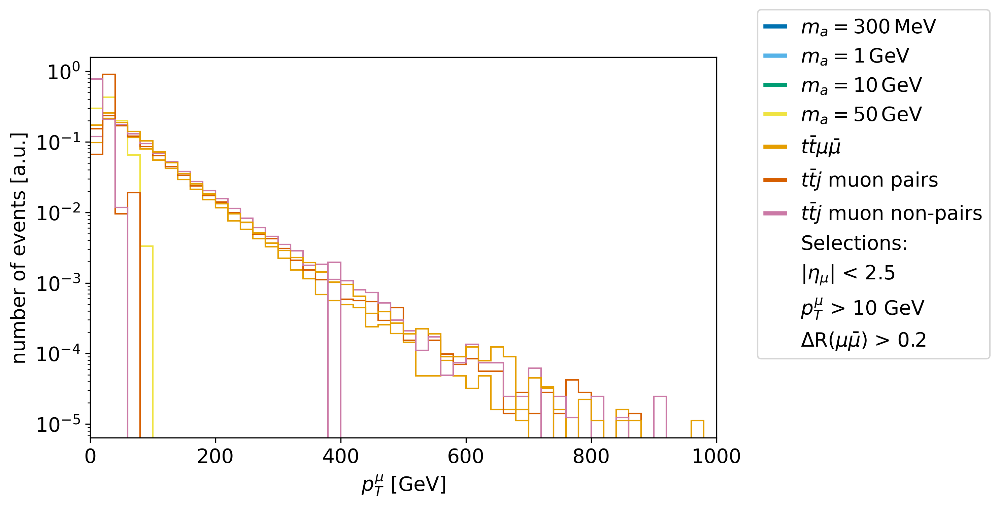

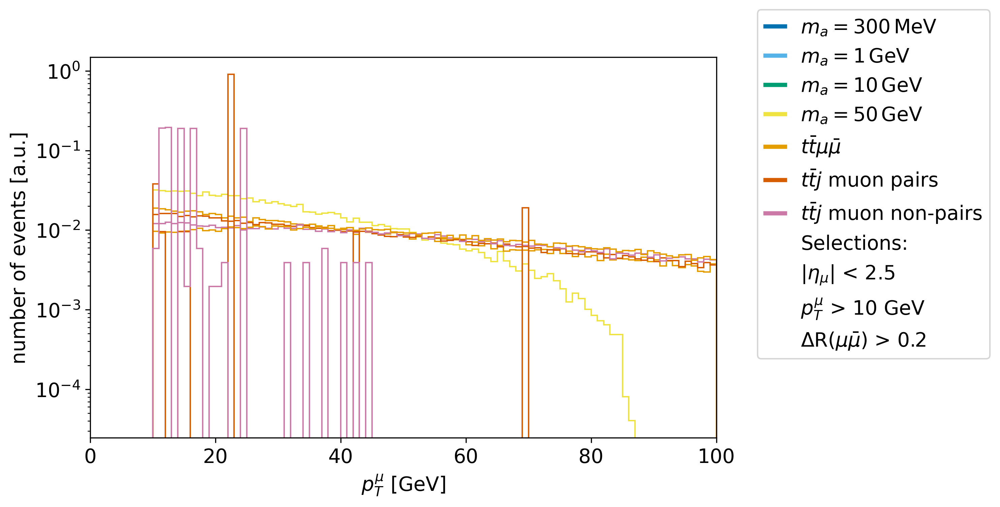

...

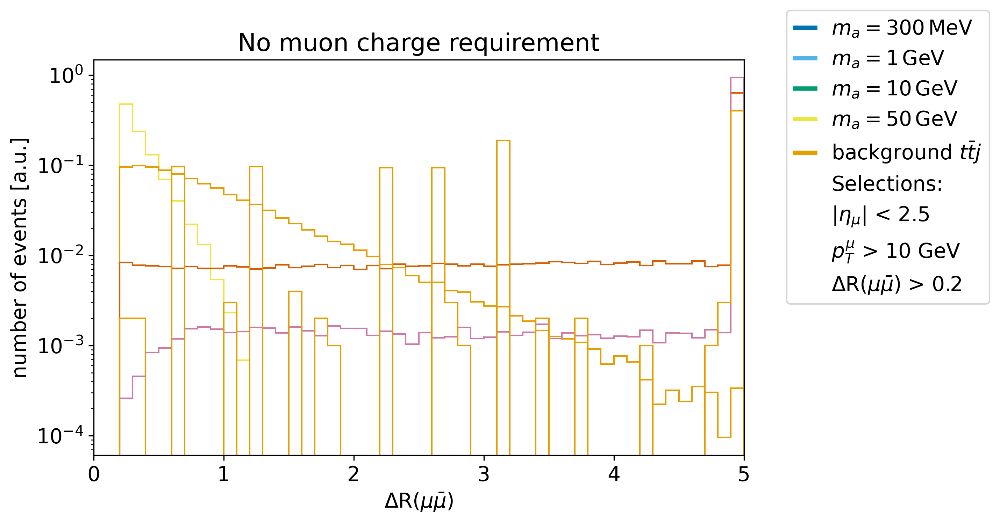

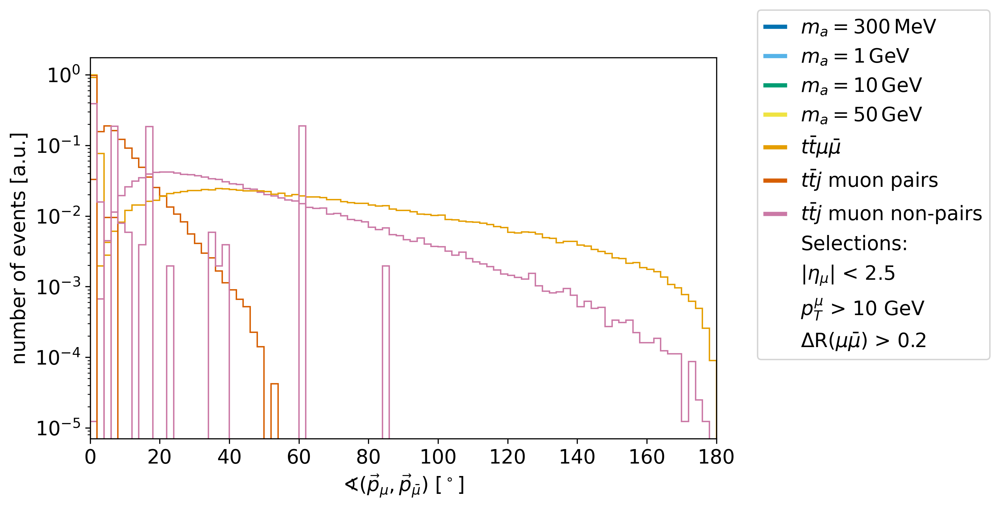

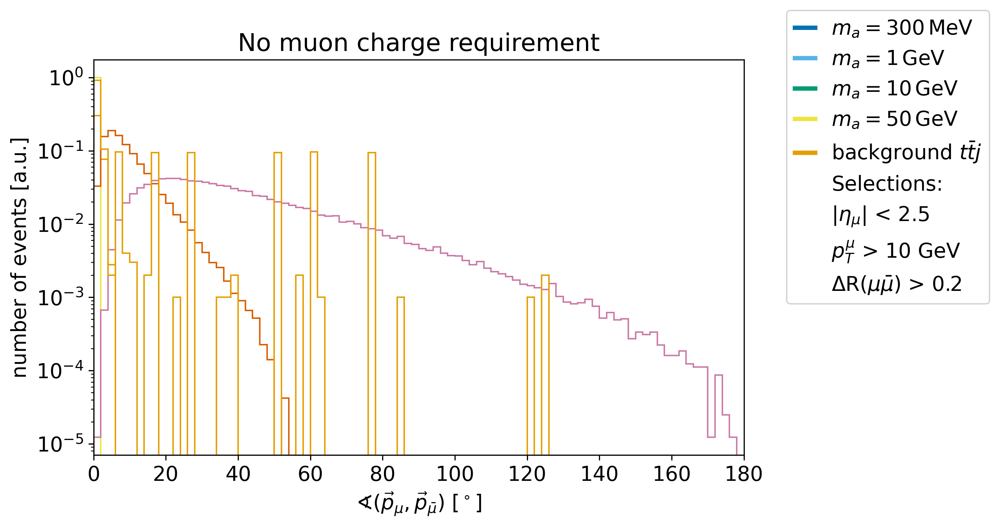

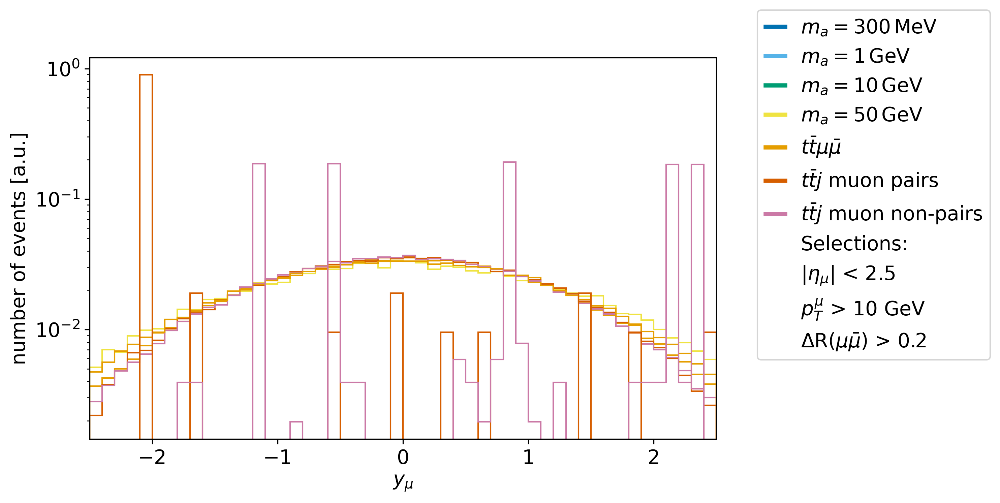

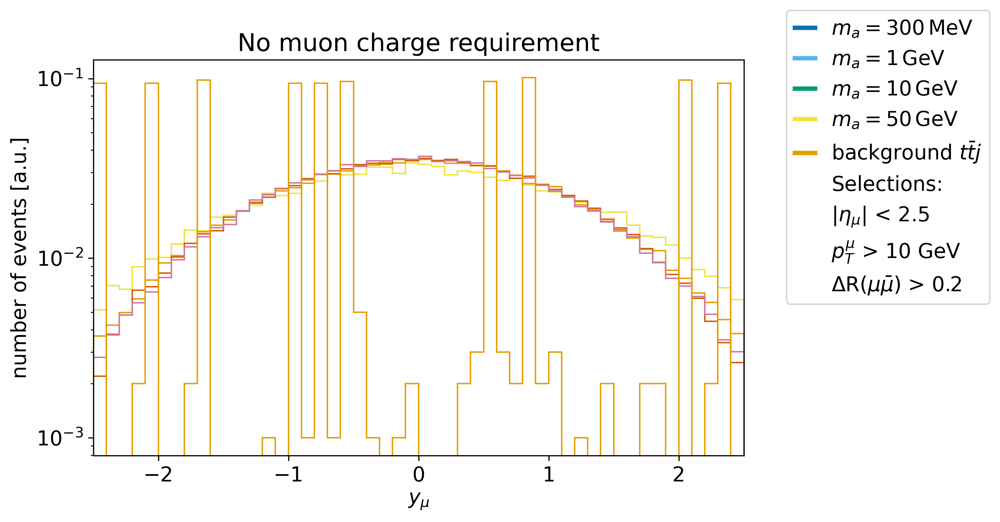

In [25]:
plot_raw_events(massLabels2, labels2, labels_ttj, selLabel)

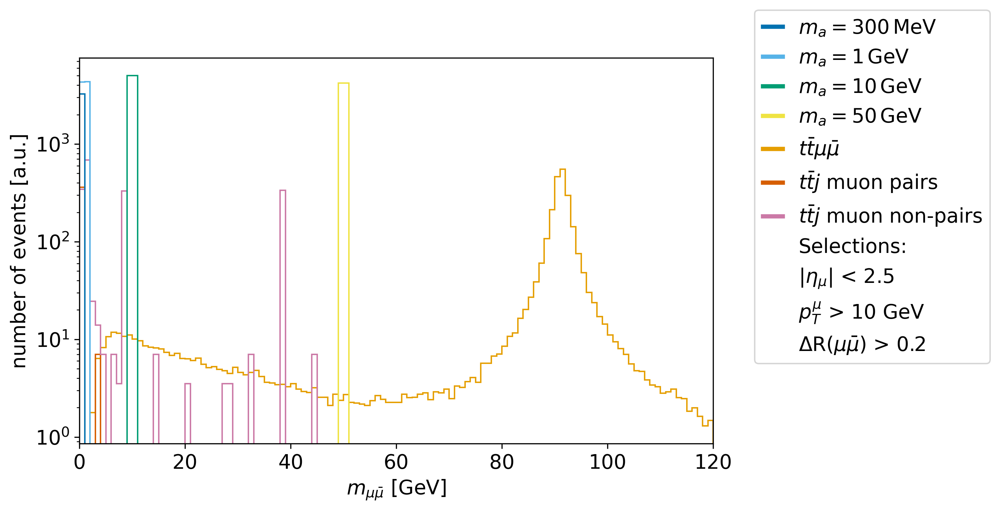

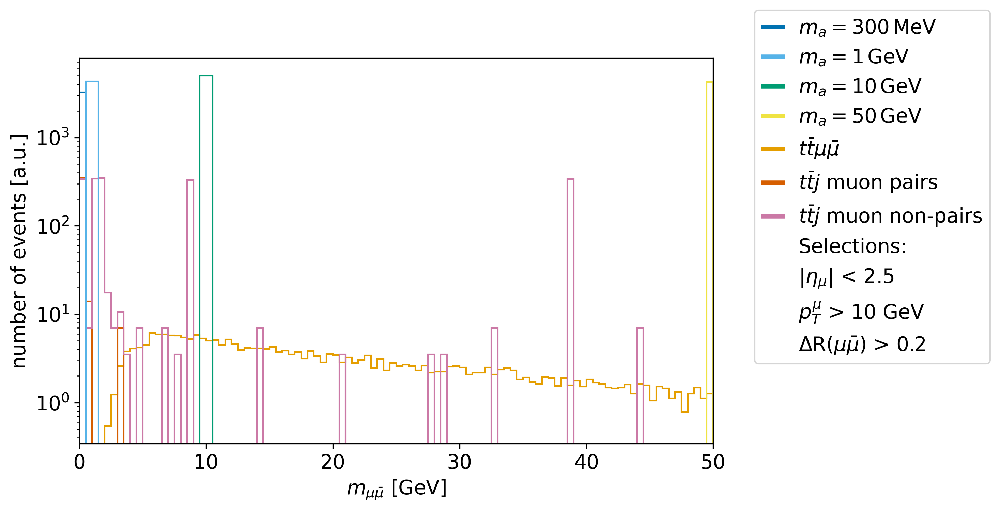

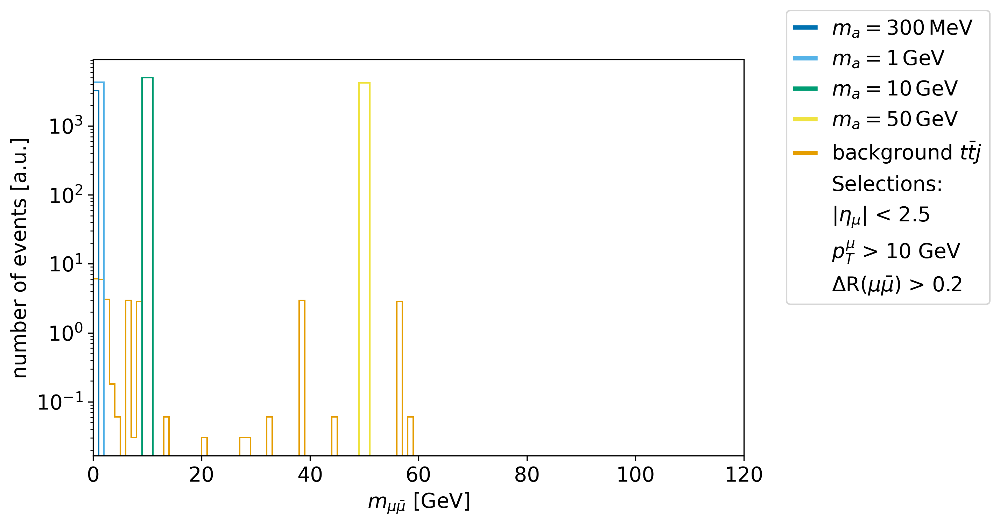

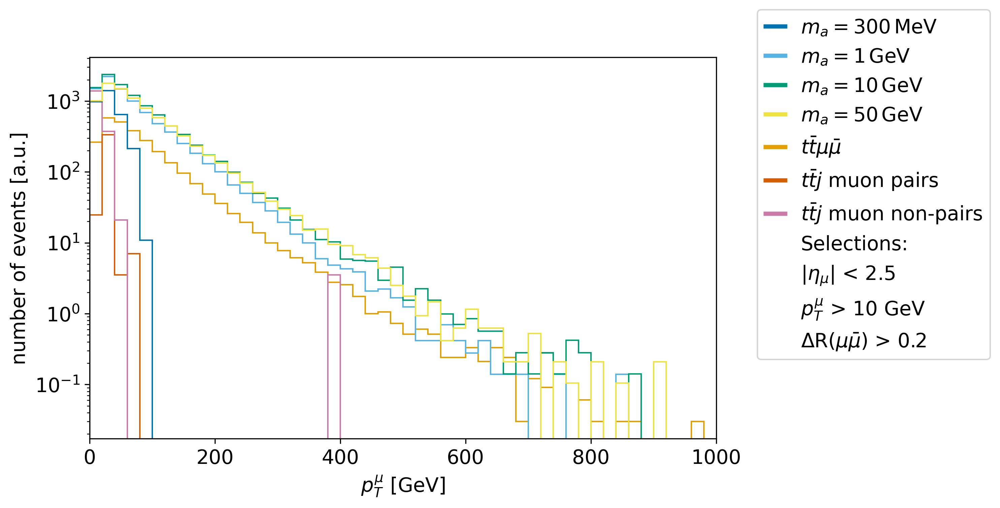

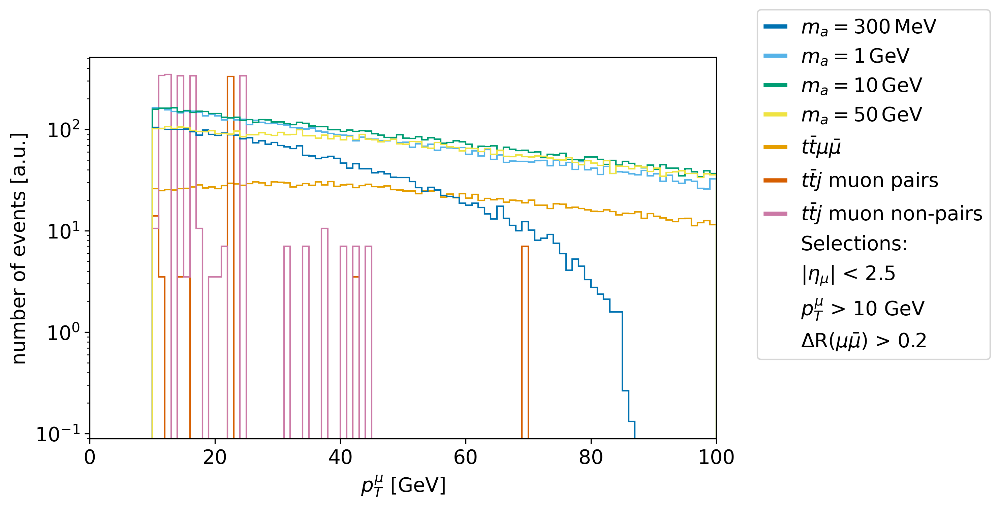

...

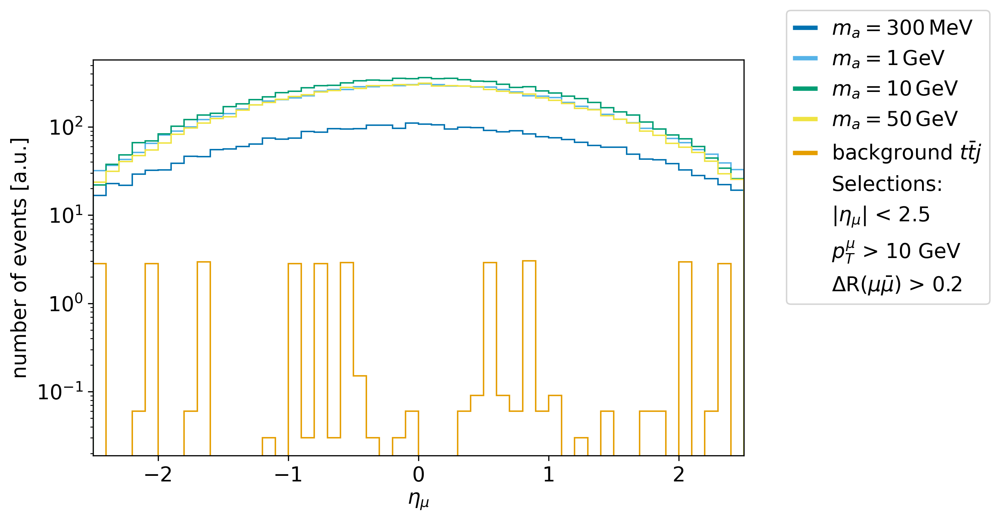

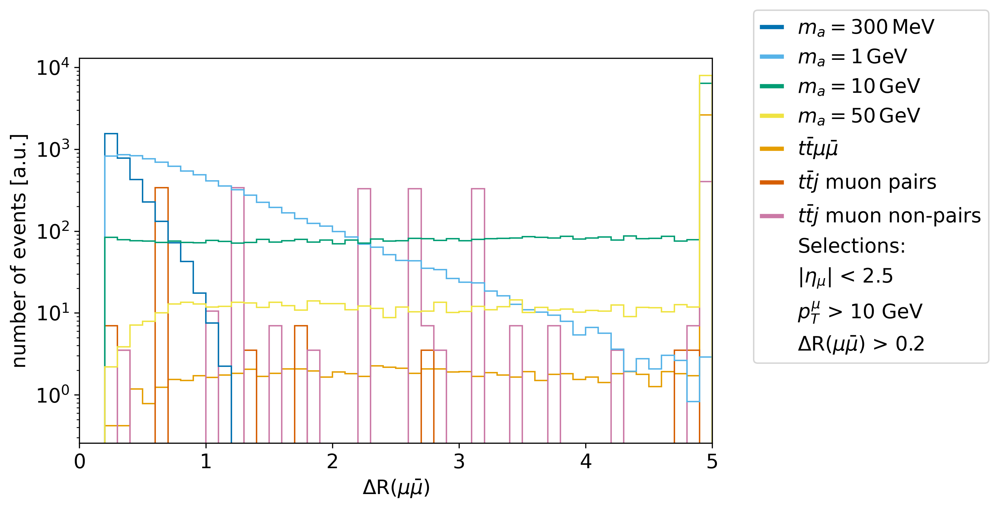

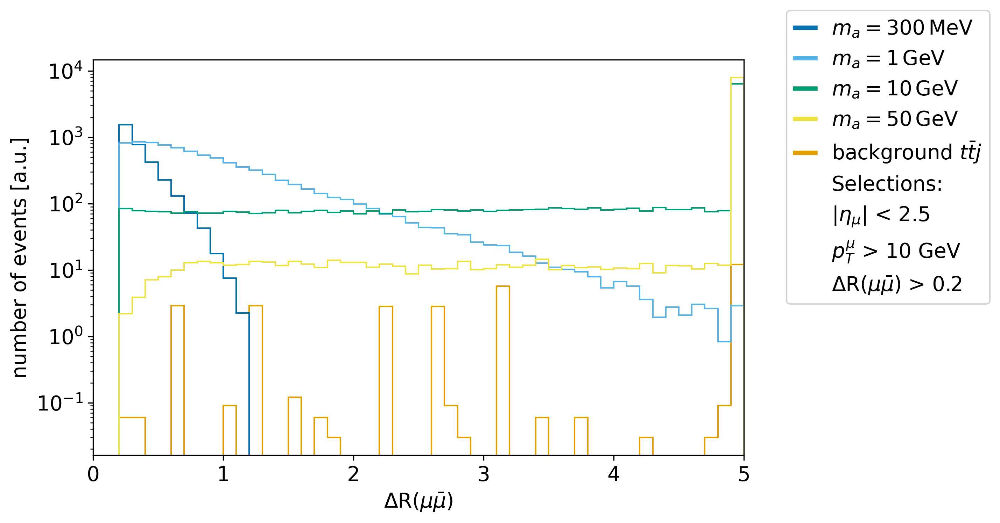

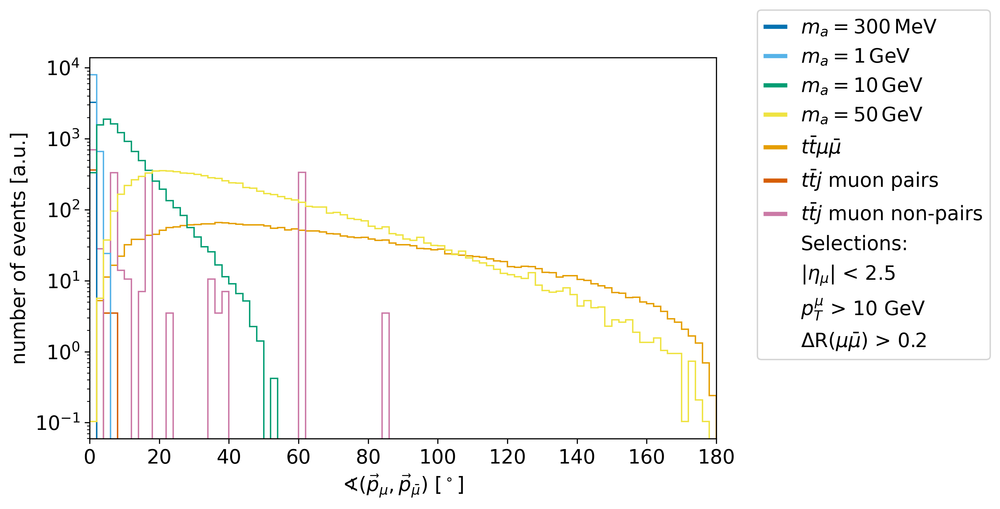

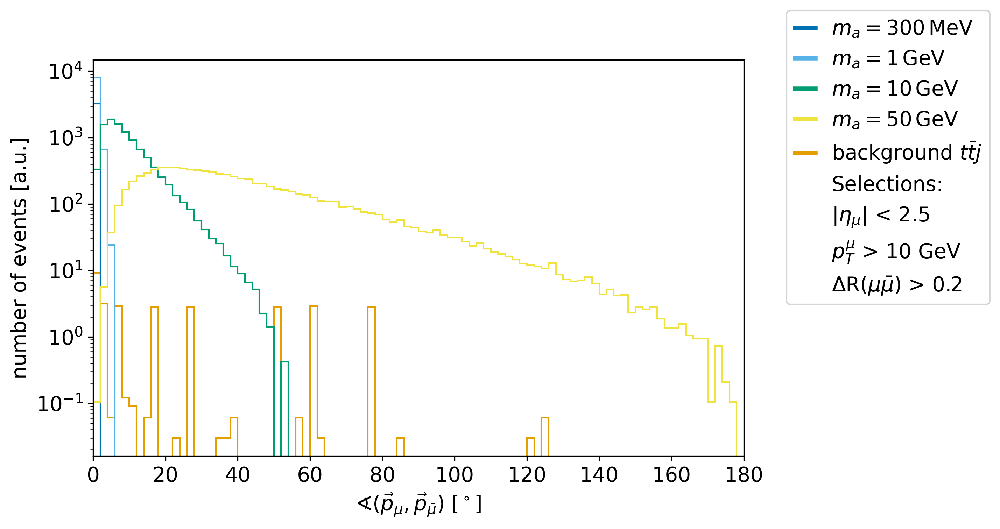

In [26]:
plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels2,labels2,labels_ttj,selLabel)

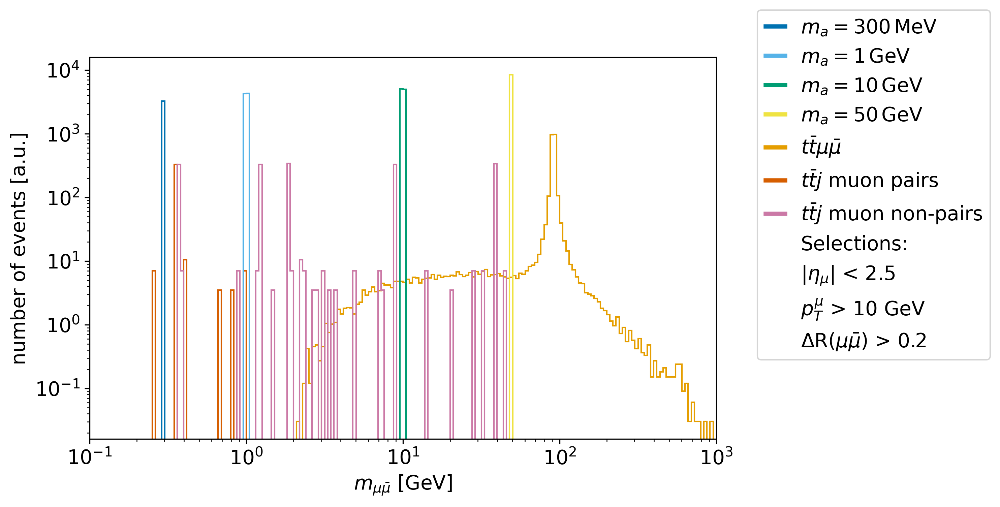

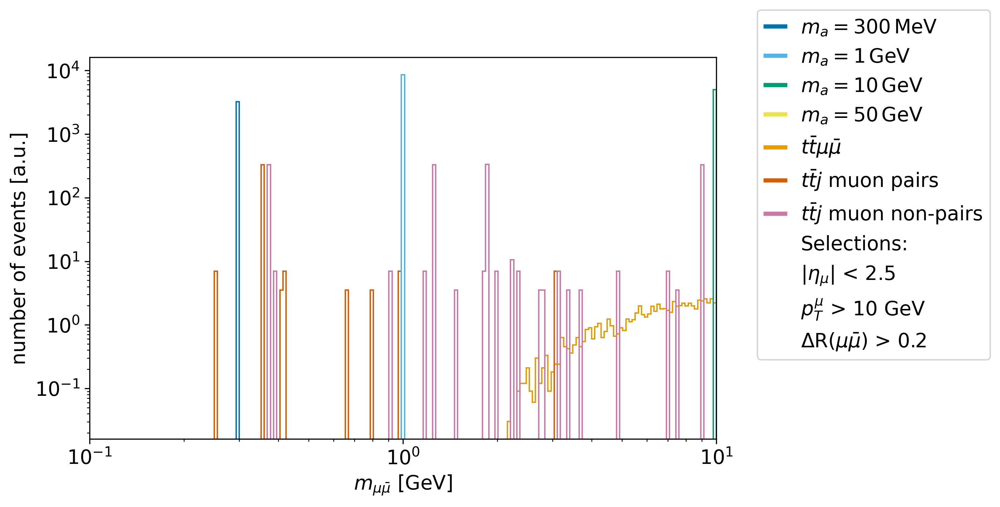

In [36]:

mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=200,
                customXlim=[0.1,1000],selLabel=selLabel)

mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels2,nbins=201,
                customXlim=[0.1,10],selLabel=selLabel)

# Testing new ttmumu samples

In [15]:
data_ttmumu1_input = [dc.Dataset.from_lhe_alp("/eos/user/l/lrygaard/ttalp/ttmumu/Events/run_01/unweighted_events.lhe")]
data_ttmumu2_input = [dc.Dataset.from_lhe_alp("/eos/user/l/lrygaard/ttalp/ttmumu_MT172/Events/run_01/unweighted_events.lhe")]

/eos/user/l/lrygaard/ttalp/ttmumu/Events/run_01/unweighted_events.lhe read with [top, antitop, muon, antimuon] in 100000 Events.
/eos/user/l/lrygaard/ttalp/ttmumu_MT172/Events/run_01/unweighted_events.lhe read with [top, antitop, muon, antimuon] in 1120 Events.


In [16]:
sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_ttmumu1 =[dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu1_input]
data_ttmumu2 =[dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu2_input]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_ttmumu1 = [dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu1]
data_ttmumu2 = [dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu2]
print(data_ttmumu1)
print(data_ttmumu2)

data_ttmumu1_org = data_ttmumu1.copy()
data_ttmumu2_org = data_ttmumu2.copy()
data_bkg = []
data_bkg.append(data_bkg_org[2]) # ttmumu Bkg_3
#data_bkg.append(data_bkg_org[4]) # ttj

data_ttmumu_check = data_ttmumu1 + data_ttmumu2

ttmumuoldLabel = [r'background $t\bar{t}\mu\bar{\mu}$ old $m_t$ = 173 GeV']
ttmumuLabel = [r'background $t\bar{t}\mu\bar{\mu}$ new $m_t$ = 173 GeV', r'background $t\bar{t}\mu\bar{\mu}$ new $m_t$ = 172 GeV']

[This Dataset contains 91067 events.]
[This Dataset contains 1031 events.]


NameError: name 'data_bkg_org' is not defined

Different array lengths: 2, 1, 1, 2


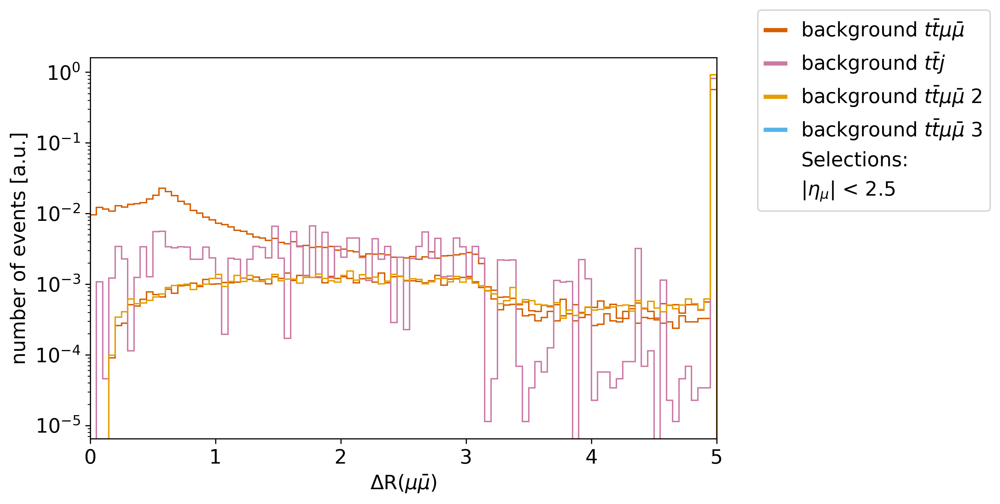

Different array lengths: 2, 1, 1, 2


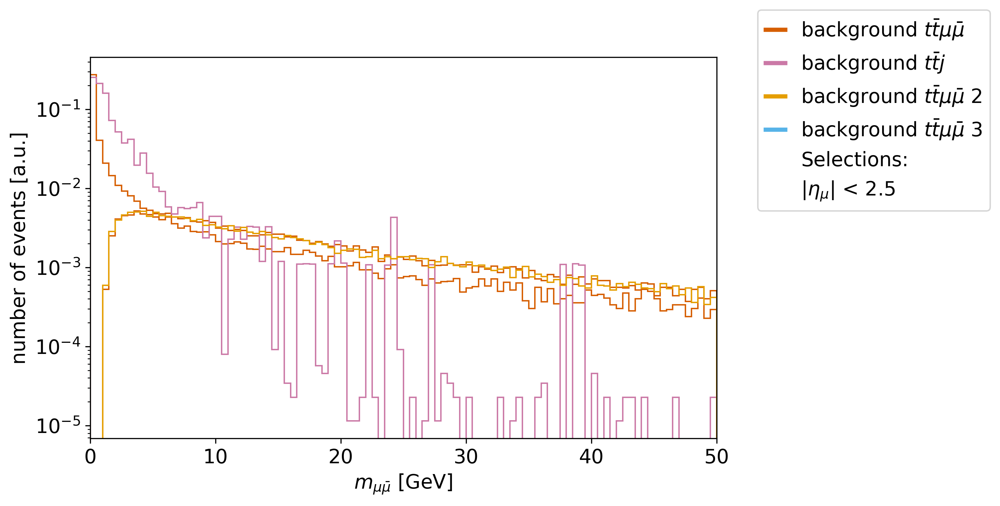

Different array lengths: 2, 1, 1, 2


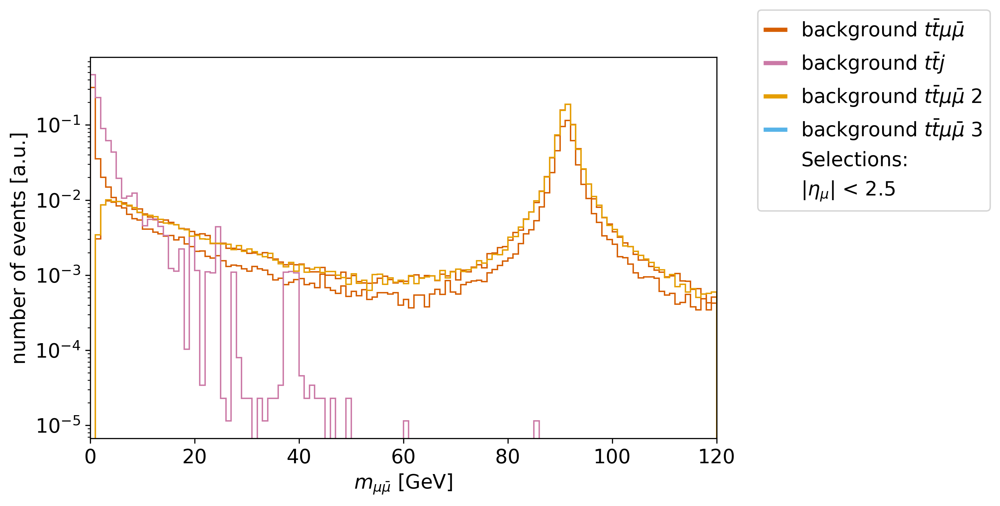

In [25]:
#mypl.hist1dcomp2(data("deltaR",["antimuon","muon"],"bkg"),data("deltaR",["antimuon","muon"],"ttmumu"),data("deltaR",["antimuon","muon"],"ttmumu2"),labels2,dirLabel["deltaR_muons"],customXlabels=ttmumuLabel,nbins=100,customXlim=[0,5],log_scale=True,selLabel=selLabel,clip=True)
mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"bkg"),data("inv_mass",["antimuon","muon"],"ttmumu_check"),[],ttmumuoldLabel,dirLabel["mmumu"],customXlabels=ttmumuLabel,nbins=100,customXlim=[0,50],log_scale=True,selLabel=selLabel)
mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"bkg"),data("inv_mass",["antimuon","muon"],"ttmumu_check"),[],ttmumuoldLabel,dirLabel["mmumu"],customXlabels=ttmumuLabel,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel)


# Comparing 300 MeV sample to new 500 MeV sample

In [21]:
data_inclusive = [data_inclusive_org[0], data_inclusive_500_org[0], data_inclusive_org[1], data_inclusive_org[2], 
                  data_inclusive_org[3]]
data_ttmumu = data_ttmumu_org
data_ttj = data_ttj_pair_org + data_ttj_nonpair_org

cross_incl = [cross_incl_org[0], cross_incl_500_org[0], cross_incl_org[1], cross_incl_org[2], cross_incl_org[3]]
cross_ttmumu = cross_ttmumu_org
cross_ttj = cross_ttj_org + cross_ttj_org

N_incl = N_incl_org + N_incl_500_org
N_ttmumu = N_ttmumu_org
N_ttj = N_ttj_org + N_ttj_org

print(data_inclusive)
print(data_ttmumu)
print(data_ttj)
#print(data_ttj_charge)
get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_ttmumu, cross_ttmumu, intlumi, N_ttmumu)
get_expected_events(data_ttj, cross_ttj, intlumi, N_ttj)
#get_expected_events(data_ttj_charge, cross_ttj_charge, intlumi, N_ttj_charge)

data_bkg = data_ttmumu + data_ttj
cross_bkg = cross_ttmumu + cross_ttj
N_bkg = N_ttmumu + N_ttj
print(data_bkg)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

massLabels3 = [r"$m_a=300\,$MeV",r"$m_a=500\,$MeV",r"$m_a=1\,$GeV",r"$m_a=10\,$GeV",r"$m_a=50\,$GeV"]
masses3 = [0.3,0.5,1,10,50]
labels2 = [r'$t\bar{t}\mu\bar{\mu}$', r'$t\bar{t}j$ muon pairs', r'$t\bar{t}j$ muon non-pairs']
labels_ttj = [r'background $t\bar{t}j$']
title_charge = "No muon charge requirement"

selLabel = [r"$|\eta_{\mu}|$ < 2.5"]

[This Dataset contains 96389 events., This Dataset contains 96383 events., This Dataset contains 96277 events., This Dataset contains 94838 events., This Dataset contains 92688 events.]
[This Dataset contains 100000 events.]
[This Dataset contains 30883 events., This Dataset contains 57972 events.]
Expected number of events:  12702.759309599998  +-  40.91516735244608
Expected number of events:  12718.692969360001  +-  40.967764238988046
Expected number of events:  13329.796156350003  +-  42.959798286617406
Expected number of events:  13341.339443519997  +-  43.32197433024899
Expected number of events:  9665.194598640002  +-  31.746718927634827
Expected number of events:  3013.011  +-  9.527977375141589
Expected number of events:  108363.983943255  +-  616.6308129146178
Expected number of events:  203415.37017642  +-  844.8403028838271
[This Dataset contains 100000 events., This Dataset contains 30883 events., This Dataset contains 57972 events.]
Expected number of events:  3013.011  +-

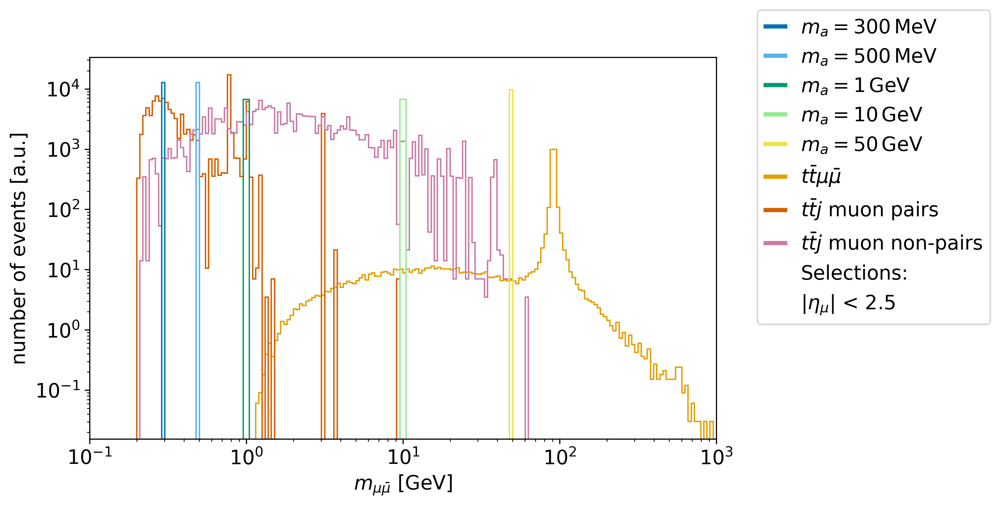

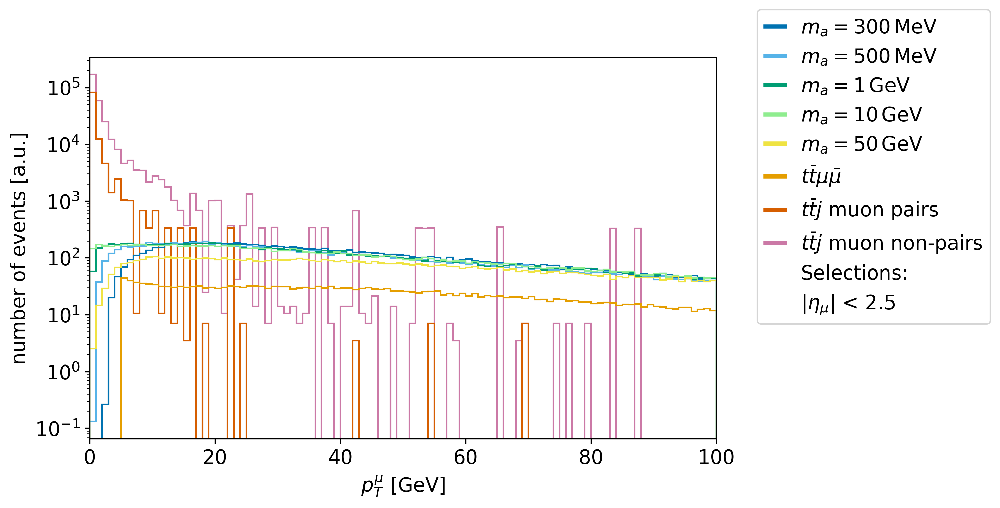

In [24]:
mypl.histloglog(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),cross_incl,
                cross_bkg,N_incl,N_bkg,intlumi,massLabels3,dirLabel["mmumu"],customXlabels=labels2,nbins=200,
                customXlim=[0.1,1000],selLabel=selLabel)

mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"ttmumu"),data("pT",["muon"],"ttj"),cross_incl,cross_ttmumu,cross_ttj,N_incl,N_ttmumu,N_ttj,intlumi,massLabels3,dirLabel["pT_mu"],nbins=100,customXlim=[0,100],customXlabels=labels2,log_scale=True,stacked3=True,selLabel=selLabel)


# Checking jet pT constraints

In [46]:
data_ttj_pTj20 = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data_pTj20.txt")]
data_ttj_pTj20_pair = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data_pTj20.txt",option_req=2)]
data_ttj_pTj20_nonpair = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data_pTj20.txt",option_req=-2)]

cross_ttj_pTj20 = 396.965289
N_ttj_pTj20 = 100000

sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_ttj_pTj20 = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20]
data_ttj_pTj20_pair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20_pair]
data_ttj_pTj20_nonpair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20_nonpair]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_ttj_pTj20 = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20]
data_ttj_pTj20_pair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20_pair]
data_ttj_pTj20_nonpair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20_nonpair]

data_bkg = data_ttj_pair_org + data_ttj_nonpair_org + data_ttj_pTj20_pair + data_ttj_pTj20_nonpair
cross_bkg = [cross_ttj, cross_ttj, cross_ttj_pTj20, cross_ttj_pTj20]
N_bkg = [100*100000,100*100000,100000,100000]

print(data_bkg)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

labels_pTj20 = [r'$t\bar{t}j$ $p_T^{j}$ > 40 GeV, muon pairs', r'$t\bar{t}j$ $p_T^{j}$ > 40 GeV, muon non-pairs', 
                r'$t\bar{t}j$ $p_T^{j}$ > 20 GeV, muon pairs', r'$t\bar{t}j$ $p_T^{j}$ > 20 GeV, muon non-pairs']
title_pTj20 = "Jet pT constraints"

selLabel = [r"$|\eta_{\mu}|$ < 2.5"]

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data_pTj20.txt read with [top, antitop, muon, antimuon] in 1936 Events.
/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data_pTj20.txt read with [top, antitop, muon, antimuon] in 727 Events.
/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data_pTj20.txt read with [top, antitop, muon, antimuon] in 1209 Events.
[This Dataset contains 30883 events., This Dataset contains 57972 events., This Dataset contains 320 events., This Dataset contains 586 events.]


MemoryError: 

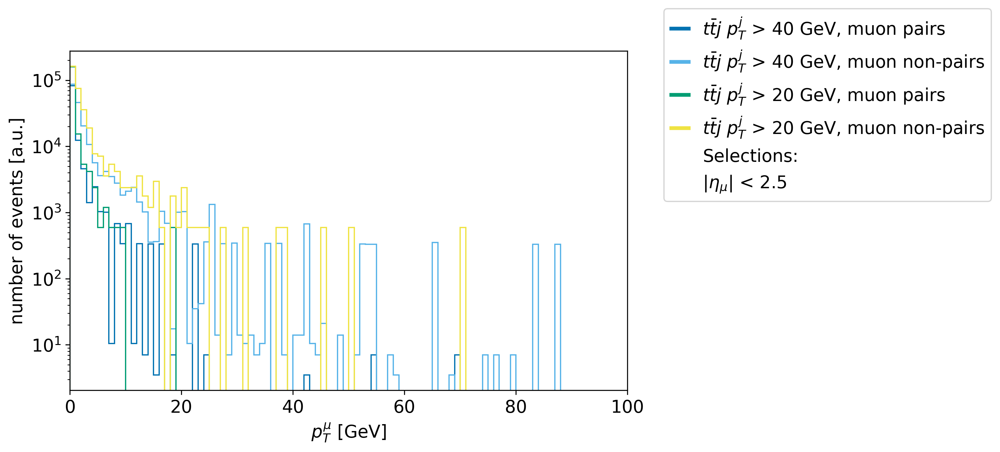

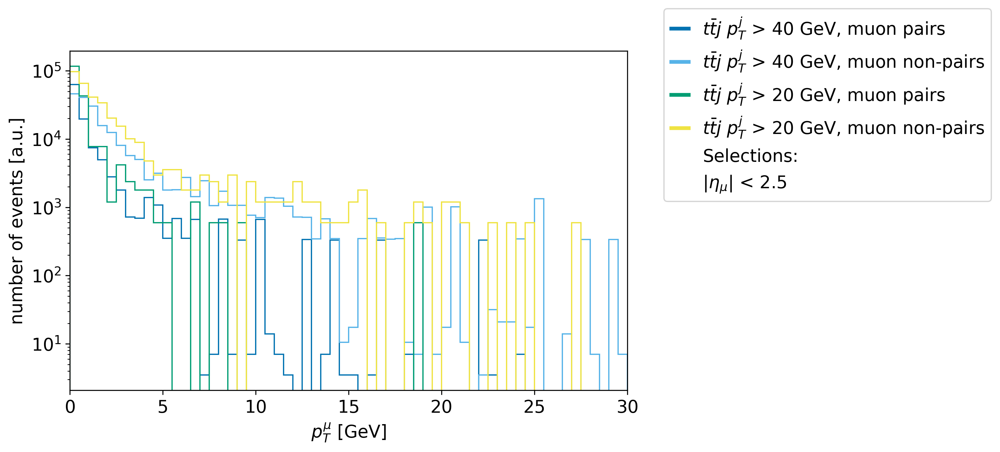

In [31]:
mypl.hist1dcross(data("pT",["muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["pT_mu"],customXlabels=[],nbins=100,customXlim=[0,100],log_scale=True,selLabel=selLabel)
mypl.hist1dcross(data("pT",["muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["pT_mu"],customXlabels=[],nbins=60,customXlim=[0,30],log_scale=True,selLabel=selLabel)

In [39]:
data_bkg = data_ttj + data_ttj_pTj20
cross_bkg = [cross_ttj,cross_ttj_pTj20]
N_bkg = [100*100000,100000]

print(data_bkg)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

labels_pTj20 = [r'$t\bar{t}j$ $p_T^{j}$ > 40 GeV', r'$t\bar{t}j$ $p_T^{j}$ > 20 GeV']
title_pTj20 = "Jet pT constraints"

selLabel = [r"$|\eta_{\mu}|$ < 2.5"]

[This Dataset contains 301 events., This Dataset contains 898 events.]
Expected number of events:  1056.1655009849999  +-  60.87636742775468
Expected number of events:  534712.244283  +-  17843.578701467355


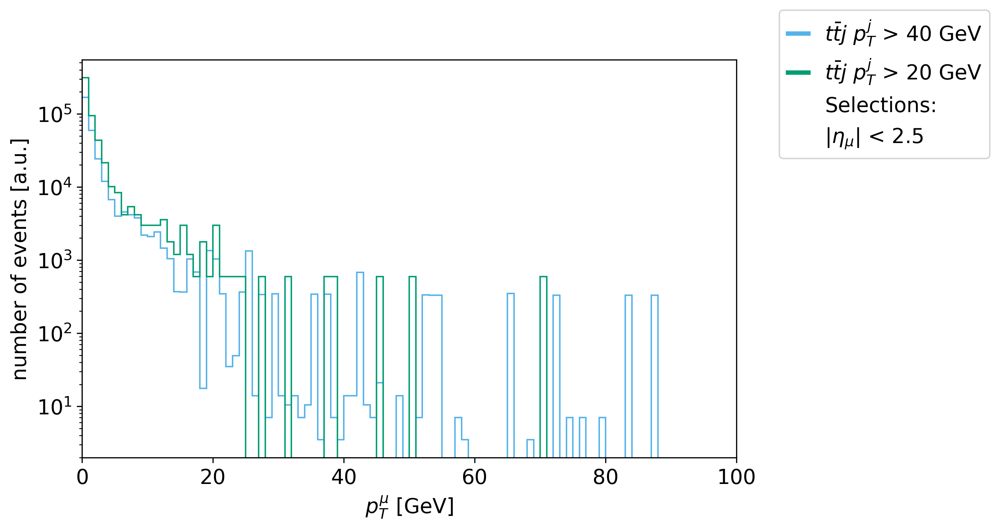

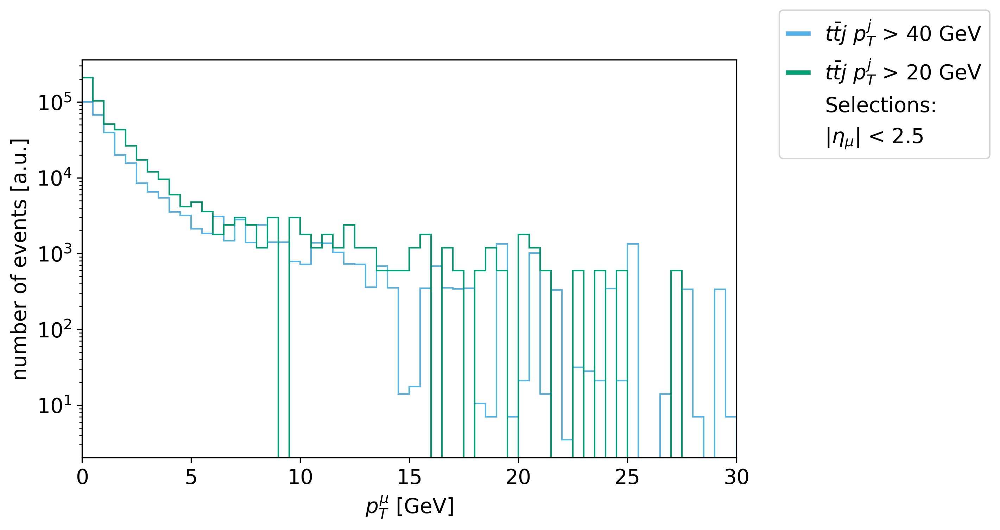

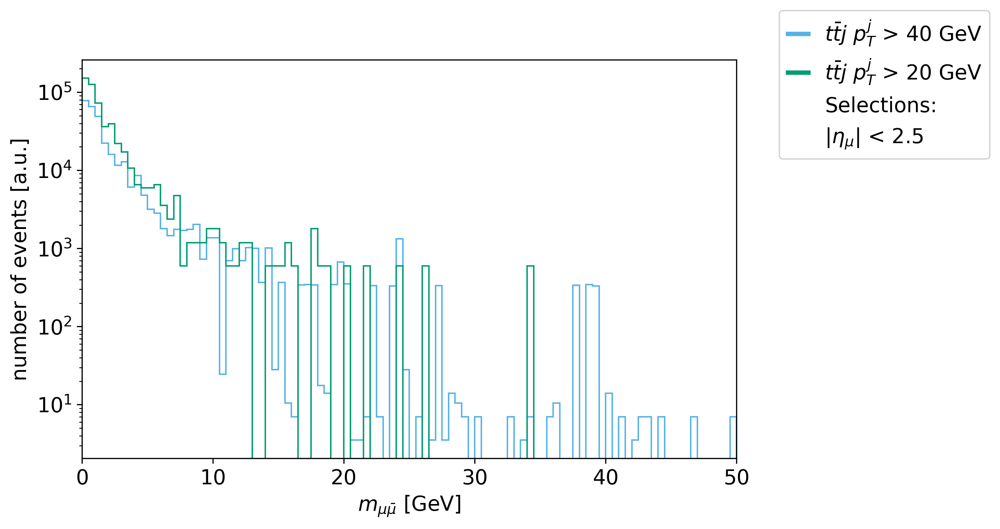

In [34]:
mypl.hist1dcross(data("pT",["muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["pT_mu"],customXlabels=[],nbins=100,customXlim=[0,100],log_scale=True,selLabel=selLabel)
mypl.hist1dcross(data("pT",["muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["pT_mu"],customXlabels=[],nbins=60,customXlim=[0,30],log_scale=True,selLabel=selLabel)
mypl.hist1dcross(data("inv_mass",["antimuon","muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["mmumu"],customXlabels=[],nbins=100,customXlim=[0,50],log_scale=True,selLabel=selLabel)


In [40]:

sel = ((lambda x: x>10),"pT", ["muon"])
data_ttj = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_org]
data_ttj_pair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pair_org]
data_ttj_nonpair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_nonpair_org]
data_ttj_pTj20 = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20]
data_ttj_pTj20_pair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20_pair]
data_ttj_pTj20_nonpair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20_nonpair]
sel = ((lambda x: x<20),"pT", ["muon"])
data_ttj = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj]
data_ttj_pair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pair]
data_ttj_nonpair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_nonpair]
data_ttj_pTj20 = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20]
data_ttj_pTj20_pair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20_pair]
data_ttj_pTj20_nonpair = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pTj20_nonpair]

data_bkg = data_ttj_pair + data_ttj_nonpair + data_ttj_pTj20_pair + data_ttj_pTj20_nonpair
cross_bkg = [cross_ttj, cross_ttj, cross_ttj_pTj20, cross_ttj_pTj20]
N_bkg = [100*100000,100*100000,100000,100000]

print(data_bkg)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

[This Dataset contains 488 events., This Dataset contains 2973 events., This Dataset contains 1 events., This Dataset contains 29 events.]
Expected number of events:  1712.32147668  +-  77.5131511779254
Expected number of events:  10431.827356905  +-  191.32112962202882
Expected number of events:  595.4479335  +-  595.4479335
Expected number of events:  17267.9900715  +-  3206.585255965166


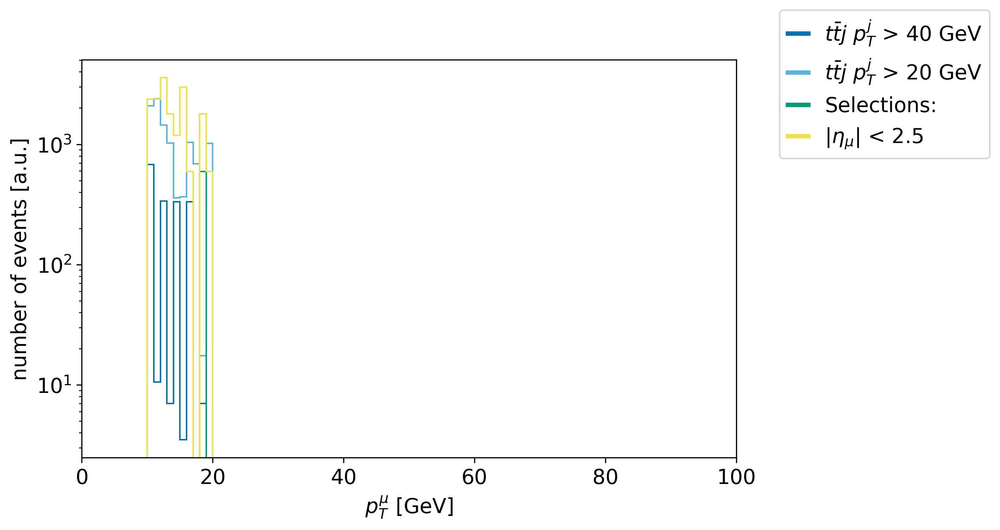

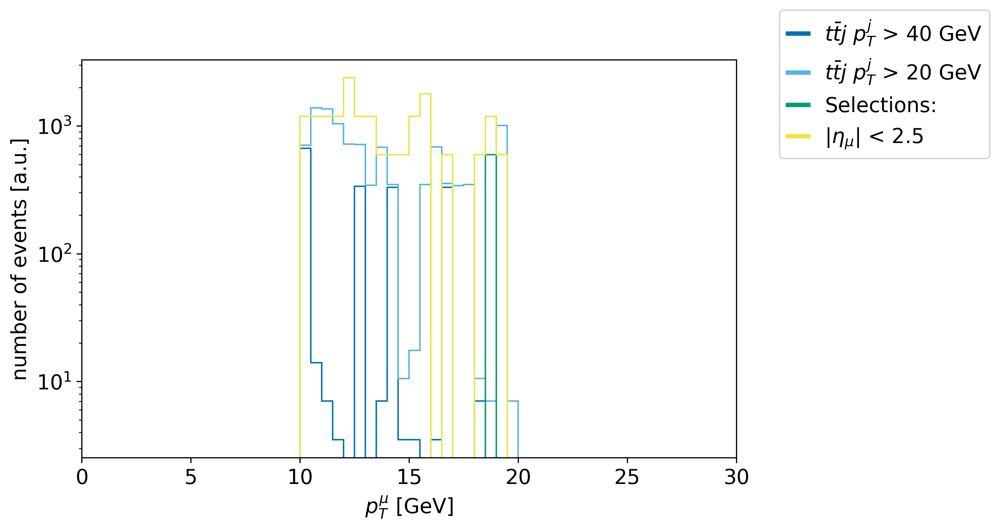

In [41]:
mypl.hist1dcross(data("pT",["muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["pT_mu"],customXlabels=[],nbins=100,customXlim=[0,100],log_scale=True,selLabel=selLabel)
mypl.hist1dcross(data("pT",["muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["pT_mu"],customXlabels=[],nbins=60,customXlim=[0,30],log_scale=True,selLabel=selLabel)

In [42]:
data_bkg = data_ttj + data_ttj_pTj20
cross_bkg = [cross_ttj,cross_ttj_pTj20]
N_bkg = [100*100000,100000]

print(data_bkg)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

labels_pTj20 = [r'$t\bar{t}j$ $p_T^{j}$ > 40 GeV', r'$t\bar{t}j$ $p_T^{j}$ > 20 GeV']
title_pTj20 = "Jet pT constraints"

selLabel = [r"$|\eta_{\mu}|$ < 2.5"]

[This Dataset contains 3088 events., This Dataset contains 33 events.]
Expected number of events:  10835.34573768  +-  194.98631316974493
Expected number of events:  19649.7818055  +-  3420.5879567423594


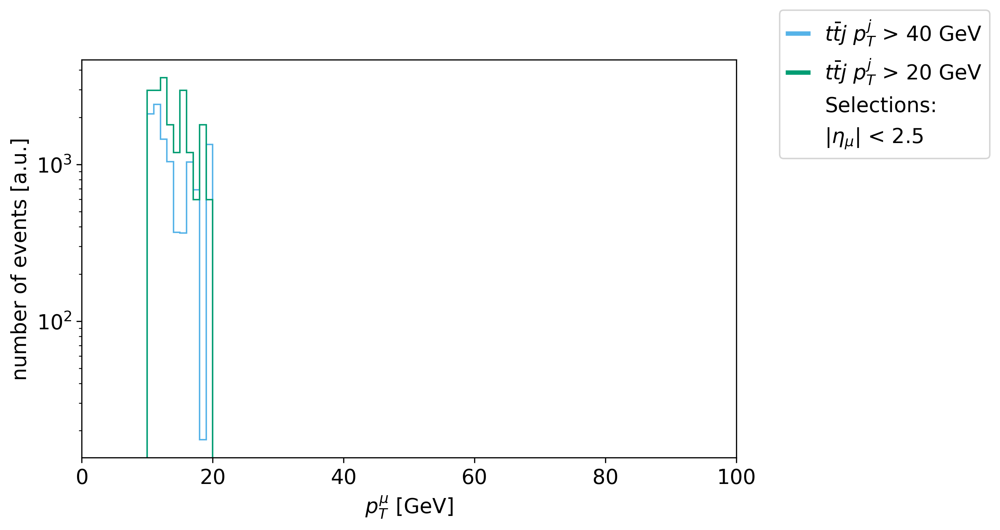

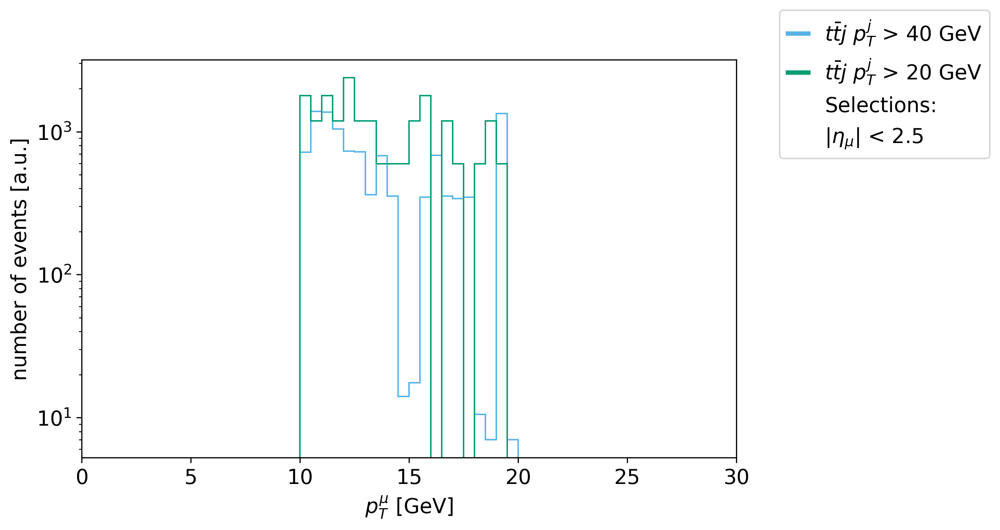

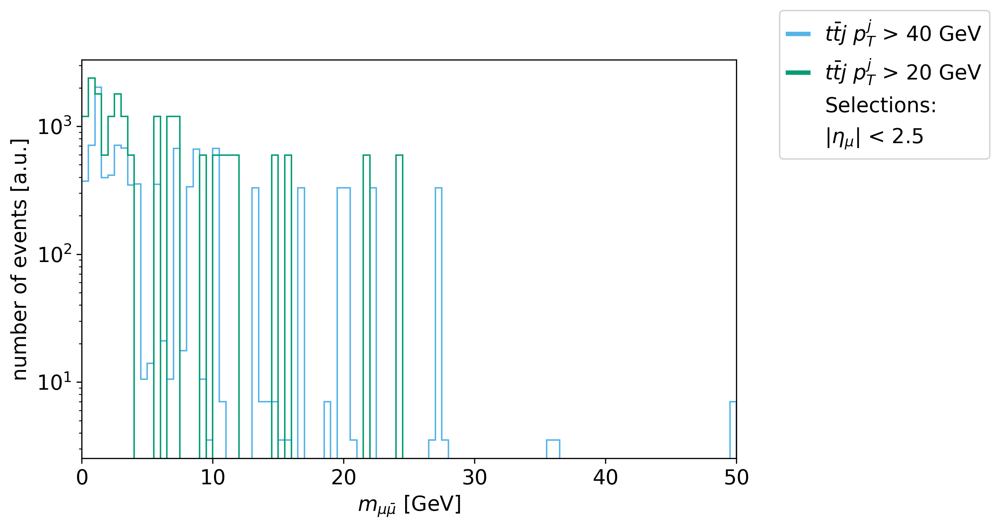

In [43]:
mypl.hist1dcross(data("pT",["muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["pT_mu"],customXlabels=[],nbins=100,customXlim=[0,100],log_scale=True,selLabel=selLabel)
mypl.hist1dcross(data("pT",["muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["pT_mu"],customXlabels=[],nbins=60,customXlim=[0,30],log_scale=True,selLabel=selLabel)
mypl.hist1dcross(data("inv_mass",["antimuon","muon"],"bkg"),[],[],cross_bkg,[],[],N_bkg,[],[],intlumi,labels_pTj20,dirLabel["mmumu"],customXlabels=[],nbins=100,customXlim=[0,50],log_scale=True,selLabel=selLabel)


# Mass error check

In [ ]:
data_ttj_masscheck = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data.txt",charge_req=0)]

data_ttj_masscheck_nocut = data_ttj_masscheck.copy()
# Make a cut for |eta|<2.5
sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_ttj_masscheck = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_masscheck_nocut]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_ttj_masscheck = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_masscheck]
print(data_ttj_masscheck)

data_ttj_masscheck_org = data_ttj_masscheck.copy()
data_bkg = []
data_bkg.append(data_bkg_org[2]) # ttmumu Bkg_3
data_bkg.append(data_bkg_org[4]) # ttj

labels_masscheck = [r'background $t\bar{t}j$']
title_masscheck = "For events with muon invariant mass error"

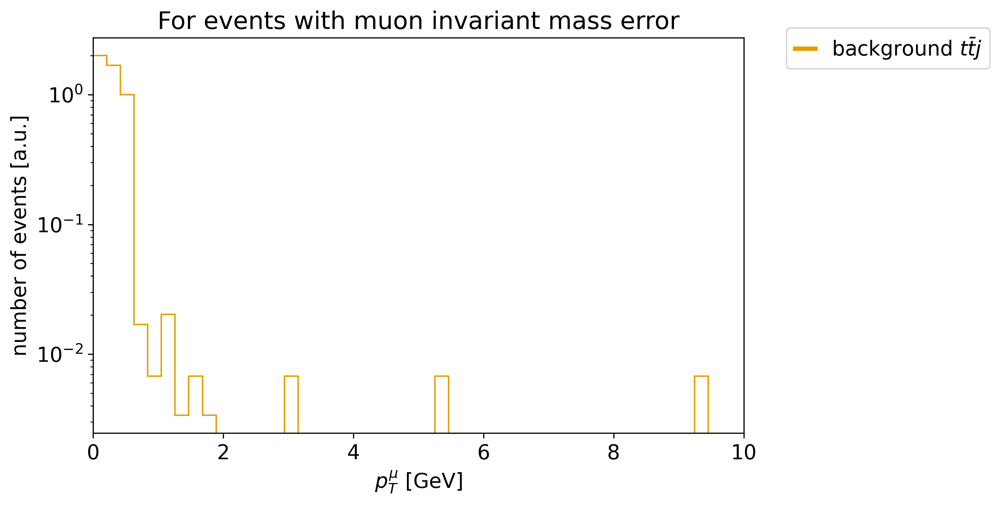

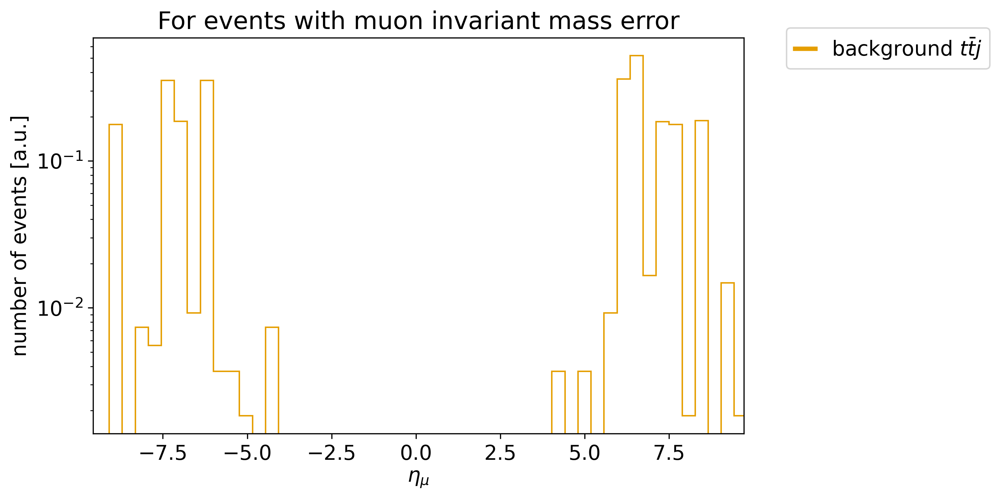

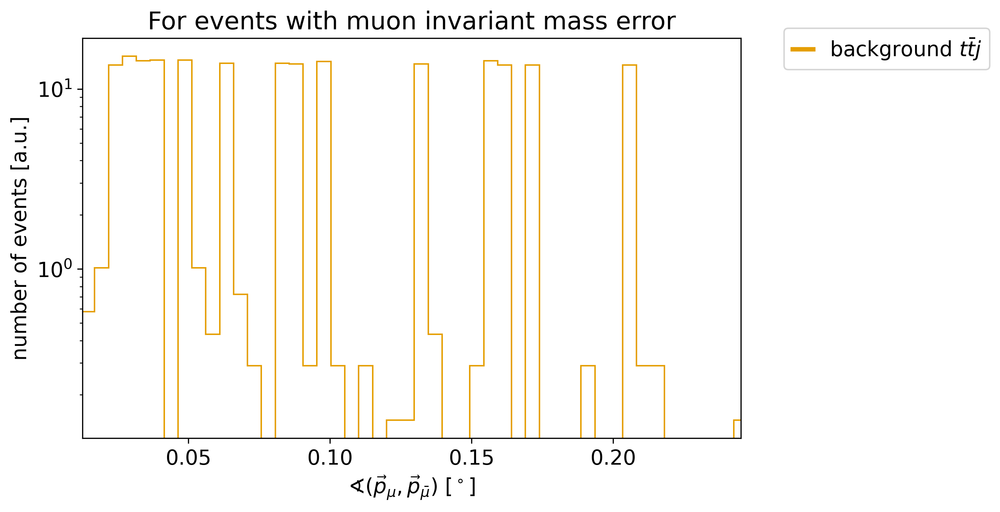

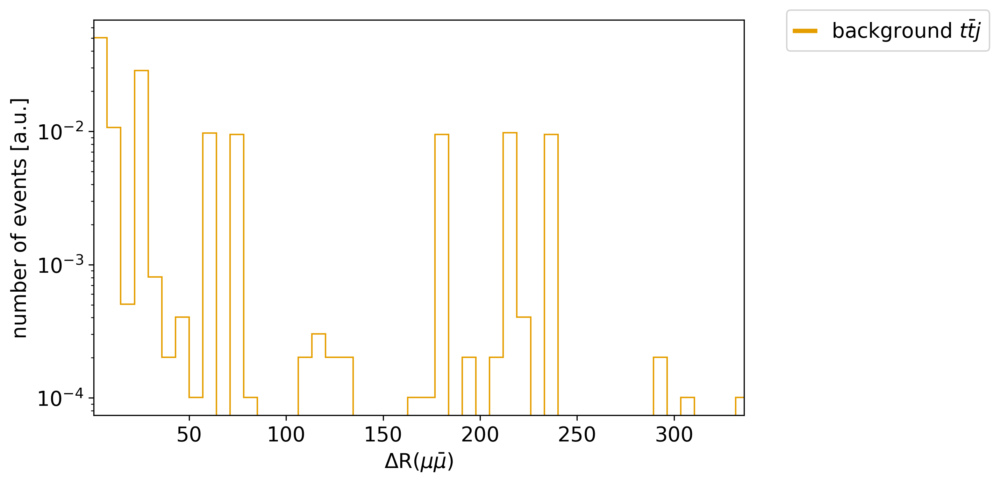

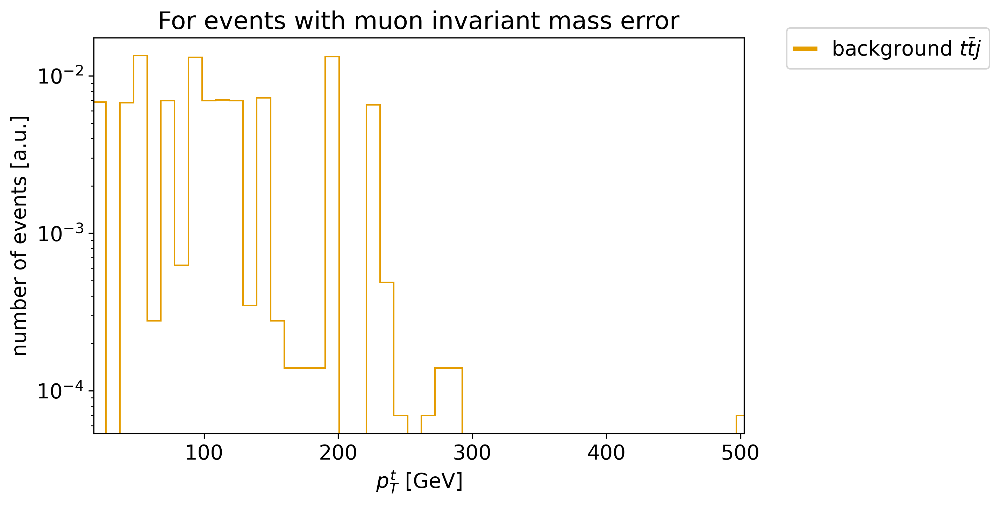

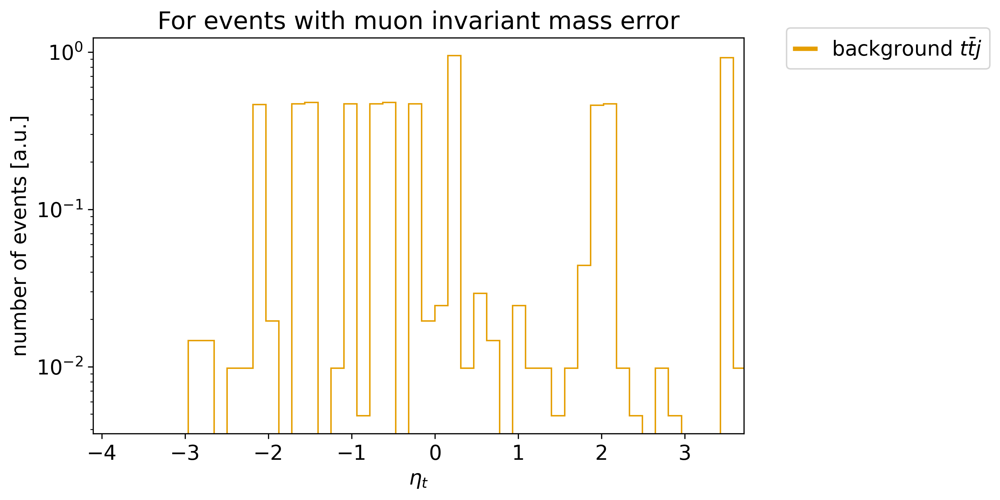

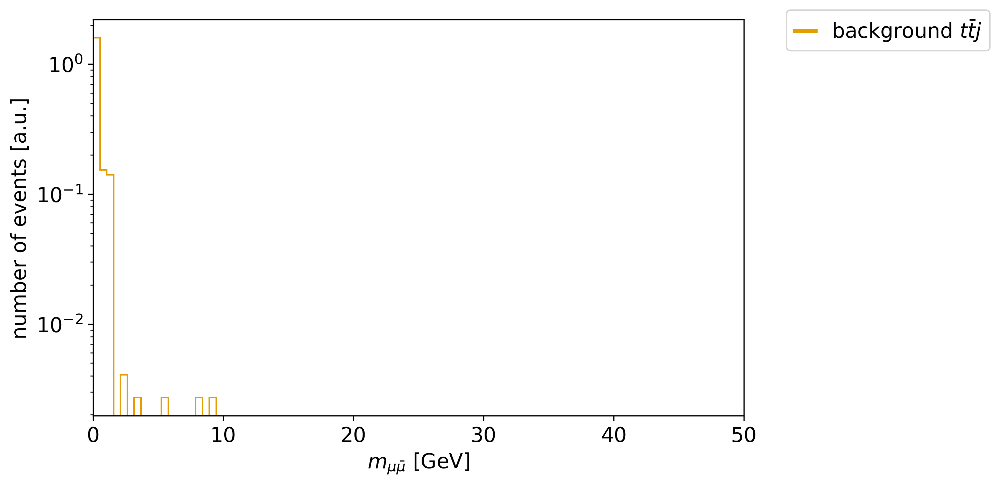

In [25]:
#mypl.hist1d(data("inv_mass",["antimuon","muon"],"ttj_masscheck"),labels_masscheck,dirLabel["mmumu"],nbins=120,customXlim=[0,120],log_scale=True)

mypl.hist1d(data("pT",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["pT_mu"],customXlim=[0,10],log_scale=True,title=title_masscheck)

mypl.hist1d(data("eta",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["eta_mu"],log_scale=True,title=title_masscheck)

mypl.hist1d(data("oA",["antimuon","muon"],"ttj_masscheck"),labels_masscheck,dirLabel["oA_muons"],log_scale = True,title=title_masscheck)

#mypl.hist1d(data("y",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["y_mu"],log_scale = True)

mypl.hist1d(data("deltaR",["antimuon","muon"],"ttj_masscheck"),labels_masscheck,dirLabel["deltaR_muons"],customXlim=[0,5],log_scale=True)

mypl.hist1d(data("pT",["top"],"ttj_masscheck"),labels_masscheck,dirLabel["pT_t"],log_scale=True,title=title_masscheck)

mypl.hist1d(data("eta",["top"],"ttj_masscheck"),labels_masscheck,dirLabel["eta_t"],log_scale=True,title=title_masscheck)

mypl.hist1d(data("inv_mass_from_angle",["antimuon","muon"],"ttj_masscheck"),labels_masscheck,dirLabel["mmumu"],nbins=100,customXlim=[0,50],log_scale=True)


# Muon Pair data

In [25]:
data_ttj_pairs2 = [dc.Dataset.from_txt_bkg("/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data.txt",option_req=2)]

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data.txt read with [top, antitop, muon, antimuon] in 70090 Events.


In [27]:
data_ttj_pairs_nocut = data_ttj_pairs2.copy()
# Make a cut for |eta|<2.5
sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_ttj_pairs = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pairs_nocut]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_ttj_pairs = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pairs]

print(data_ttj_pairs)

labels_masscheck = [r'$t\bar{t}j muon pair$', r'background $t\bar{t}j$']
title_pairs = "For events with muon pairs"

[This Dataset contains 30883 events.]


Different array lengths


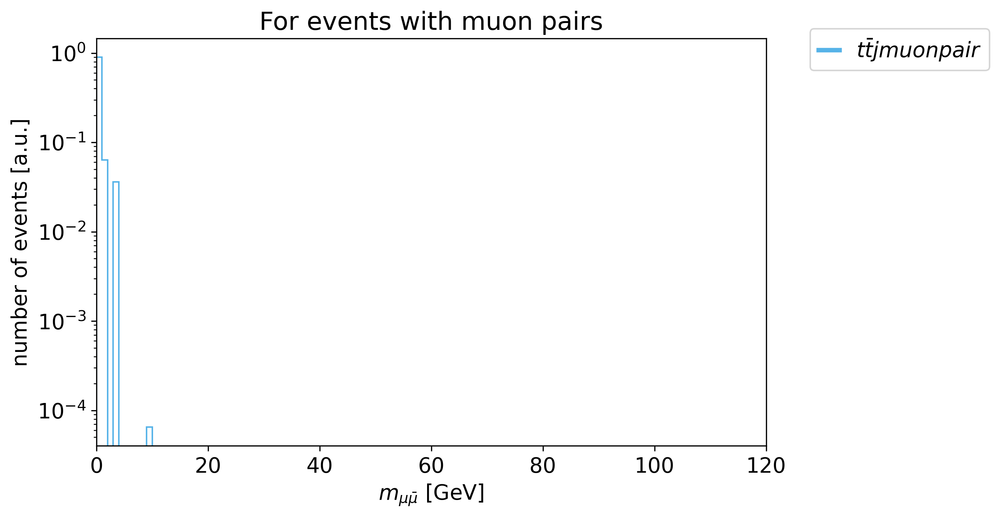

Different array lengths


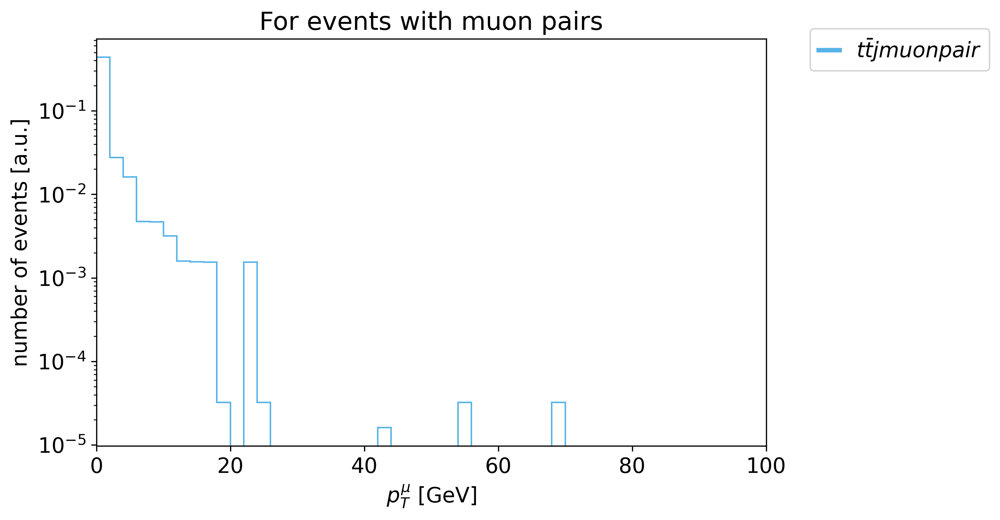

Different array lengths


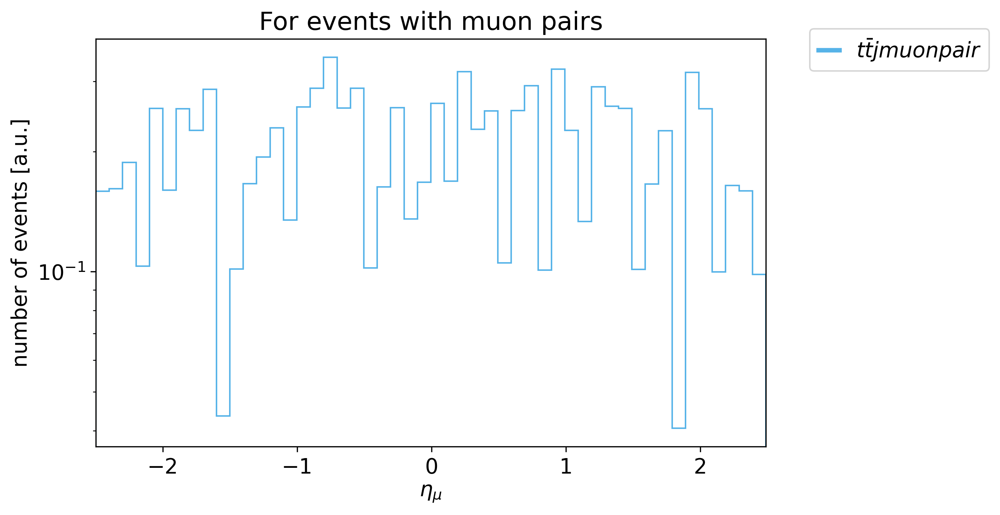

Different array lengths


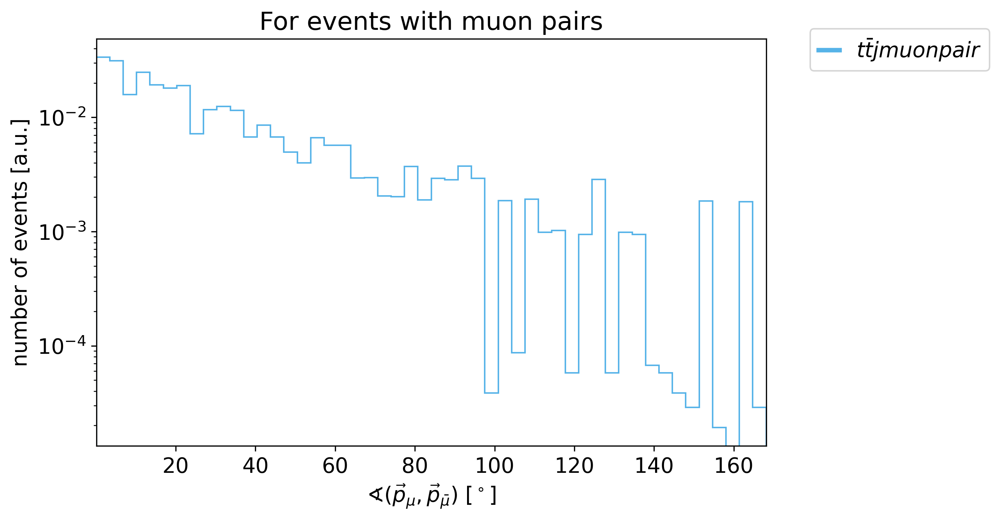

Different array lengths


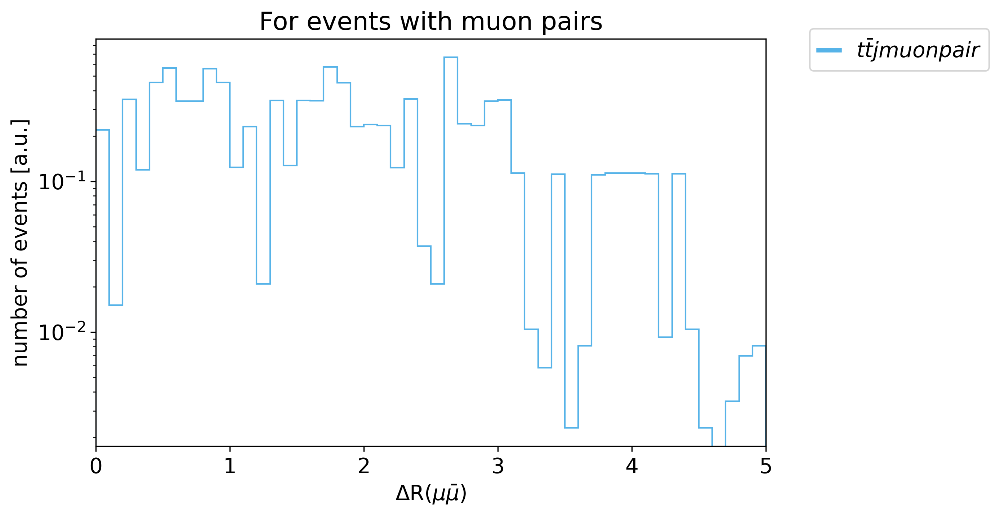

Different array lengths


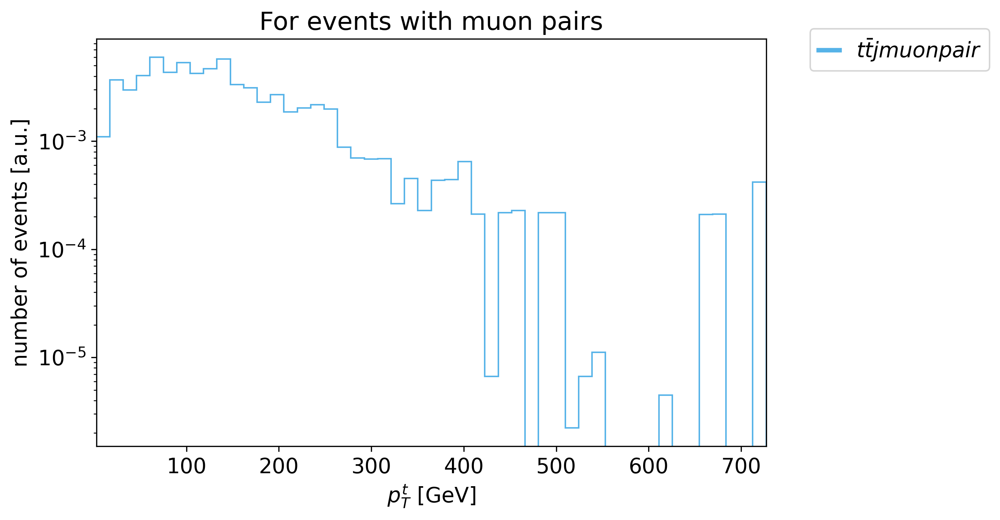

Different array lengths


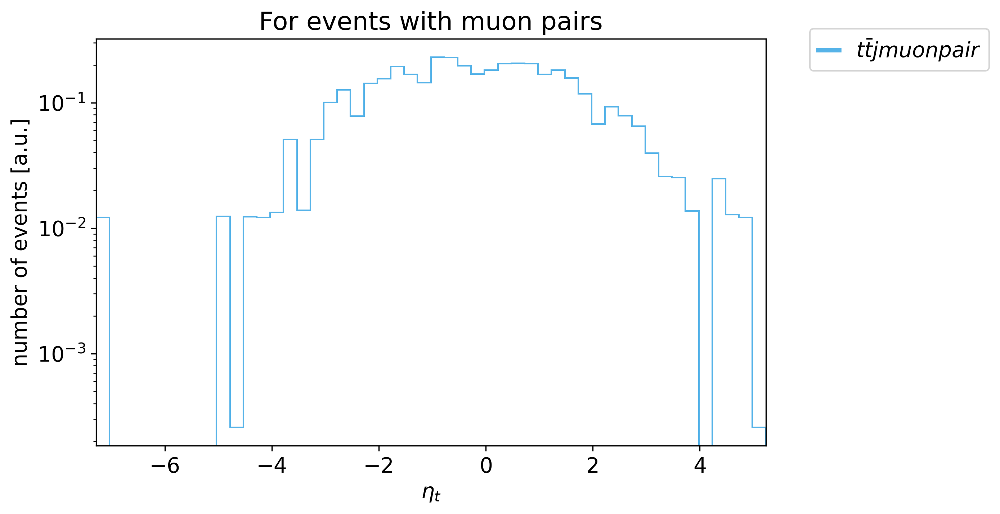

Different array lengths


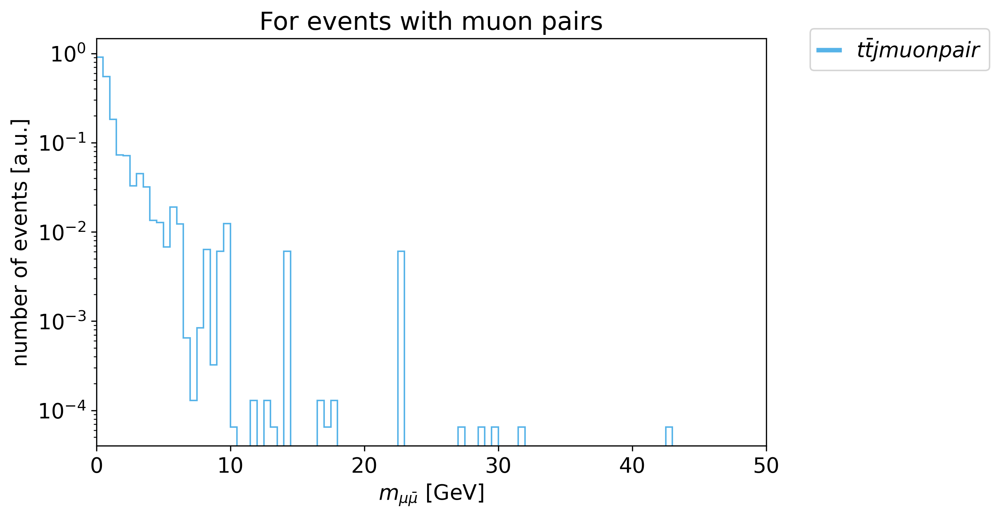

In [29]:
mypl.hist1d(data("inv_mass",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["mmumu"],nbins=120,customXlim=[0,120],log_scale=True,title=title_pairs)

mypl.hist1d(data("pT",["muon"],"ttj_pairs"),labels_masscheck,dirLabel["pT_mu"],customXlim=[0,100],log_scale=True,title=title_pairs)

mypl.hist1d(data("eta",["muon"],"ttj_pairs"),labels_masscheck,dirLabel["eta_mu"],log_scale=True,title=title_pairs)

mypl.hist1d(data("oA",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["oA_muons"],log_scale =True,title=title_pairs)

#mypl.hist1d(data("y",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["y_mu"],log_scale = True,title=title_pairs)

mypl.hist1d(data("deltaR",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["deltaR_muons"],log_scale=True,customXlim=[0,5],title=title_pairs)

mypl.hist1d(data("pT",["top"],"ttj_pairs"),labels_masscheck,dirLabel["pT_t"],log_scale=True,title=title_pairs)

mypl.hist1d(data("eta",["top"],"ttj_pairs"),labels_masscheck,dirLabel["eta_t"],log_scale=True,title=title_pairs)

mypl.hist1d(data("inv_mass_from_angle",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["mmumu"],nbins=100,customXlim=[0,50],log_scale=True,title=title_pairs)


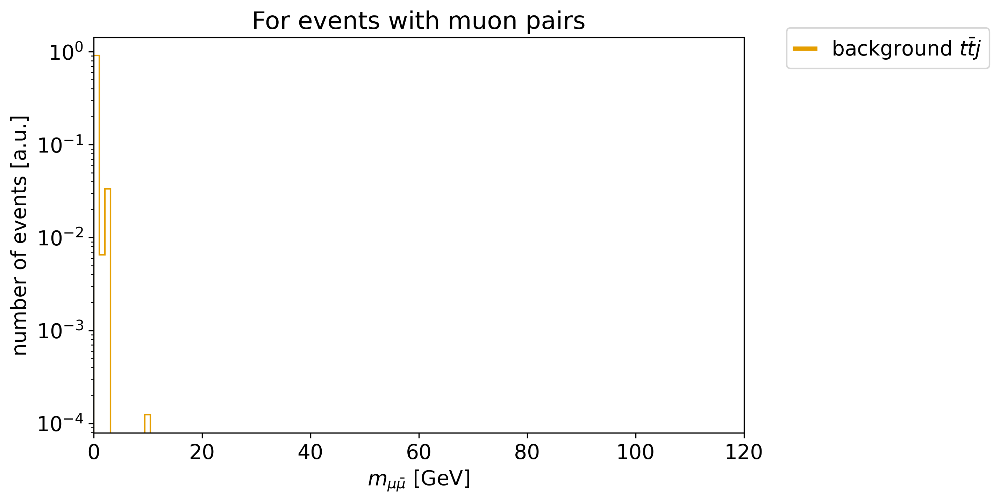

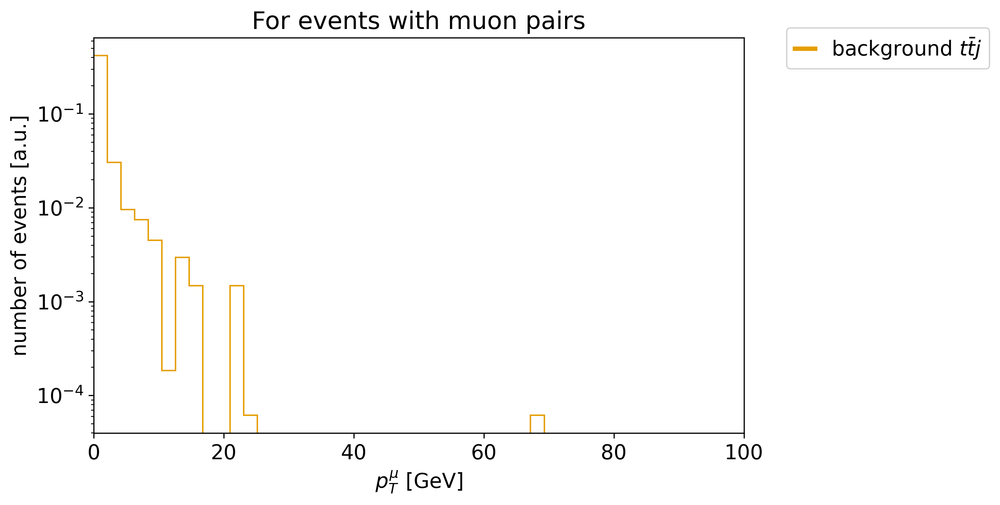

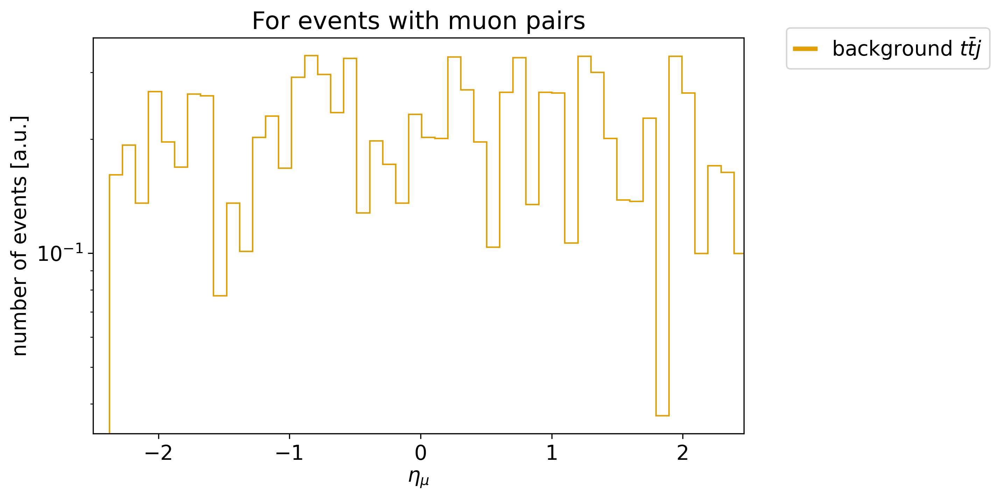

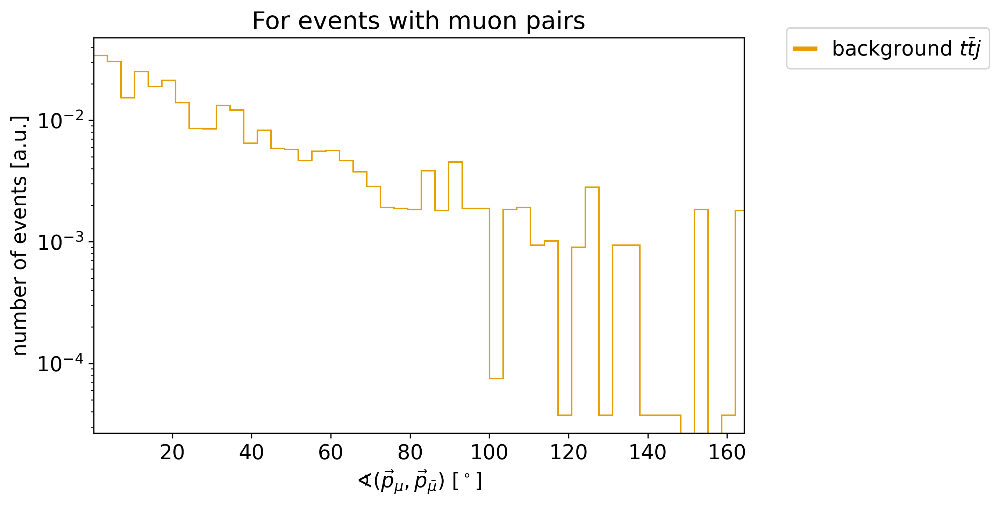

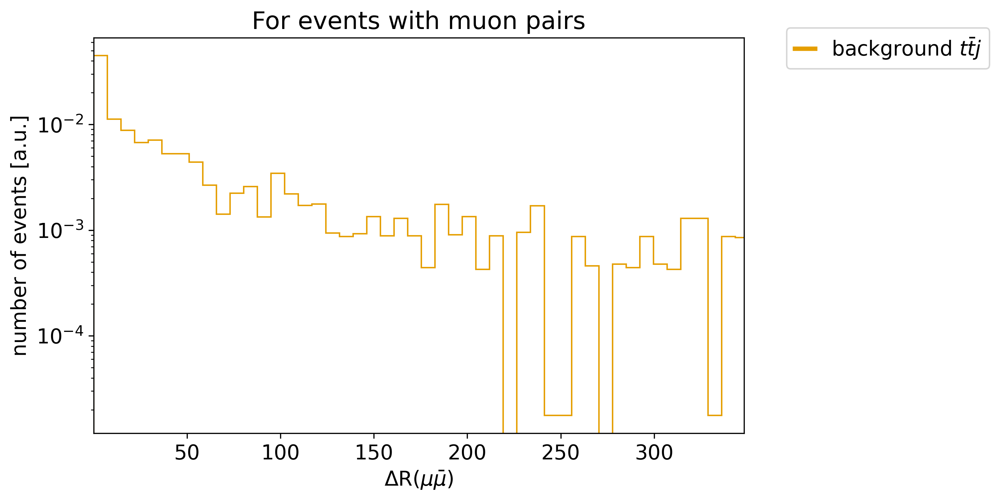

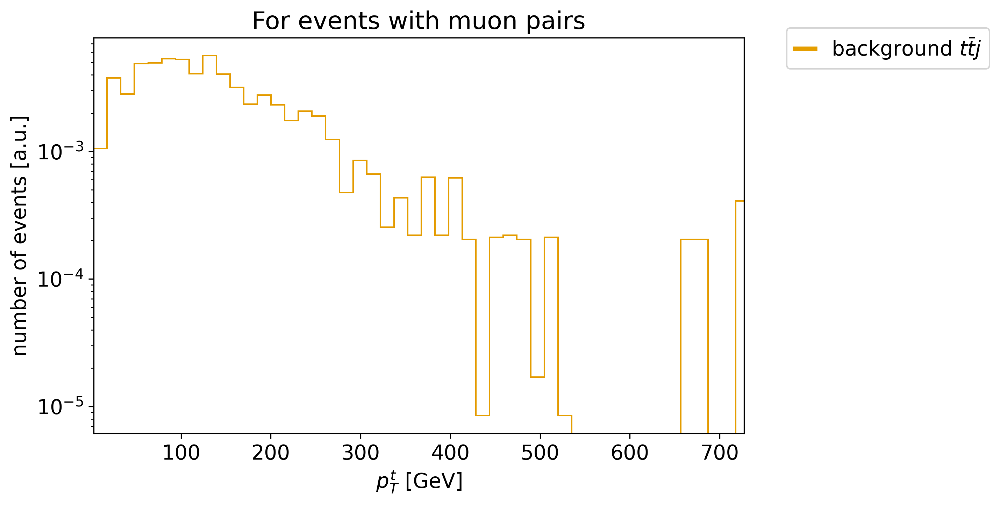

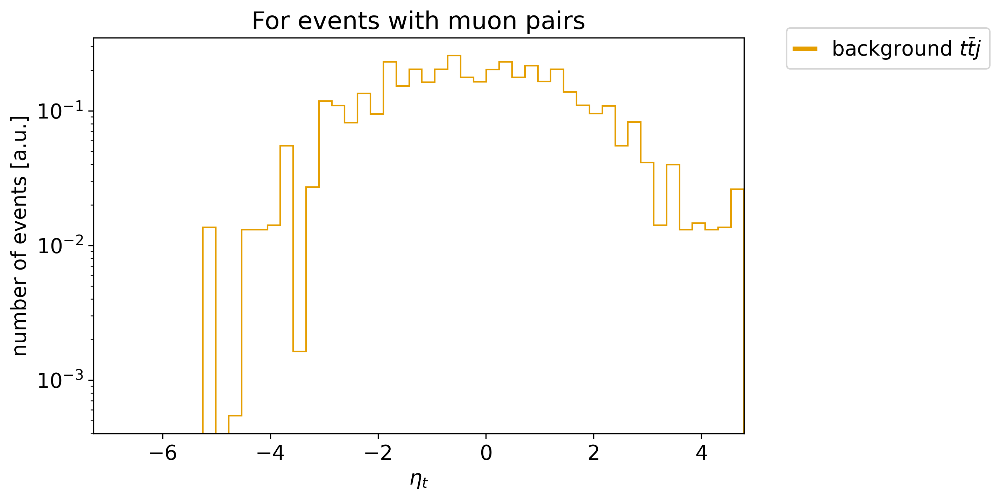

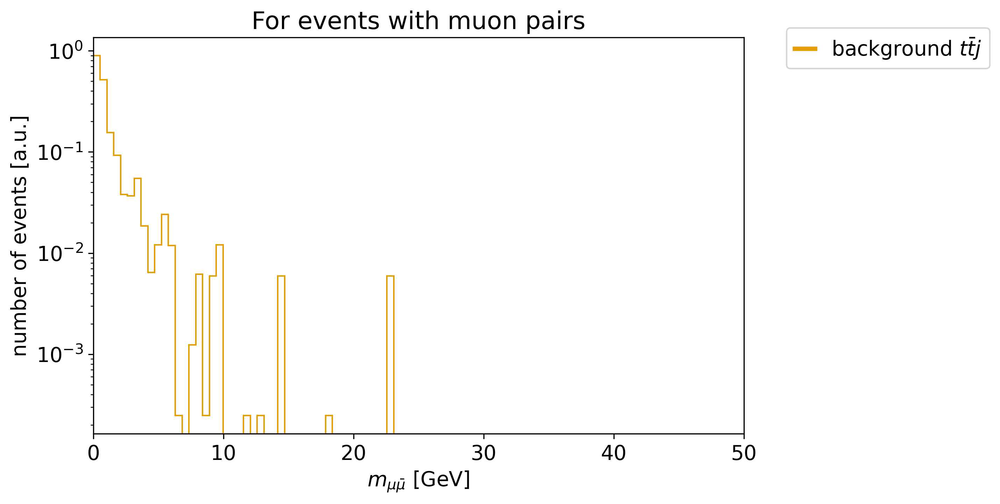

In [28]:
mypl.histcomp2(data("inv_mass",["antimuon","muon"],"ttj_pairs"),data("inv_mass",["antimuon","muon"],"ttj"),labels_masscheck,dirLabel["mmumu"],nbins=120,customXlim=[0,120],log_scale=True,title=title_pairs)

mypl.hist1d(data("pT",["muon"],"ttj_pairs"),labels_masscheck,dirLabel["pT_mu"],customXlim=[0,100],log_scale=True,title=title_pairs)

mypl.hist1d(data("eta",["muon"],"ttj_pairs"),labels_masscheck,dirLabel["eta_mu"],log_scale=True,title=title_pairs)

mypl.hist1d(data("oA",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["oA_muons"],log_scale =True,title=title_pairs)

#mypl.hist1d(data("y",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["y_mu"],log_scale = True,title=title_pairs)

mypl.hist1d(data("deltaR",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["deltaR_muons"],log_scale=True,customXlim=[0,5],title=title_pairs)

mypl.hist1d(data("pT",["top"],"ttj_pairs"),labels_masscheck,dirLabel["pT_t"],log_scale=True,title=title_pairs)

mypl.hist1d(data("eta",["top"],"ttj_pairs"),labels_masscheck,dirLabel["eta_t"],log_scale=True,title=title_pairs)

mypl.hist1d(data("inv_mass_from_angle",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["mmumu"],nbins=100,customXlim=[0,50],log_scale=True,title=title_pairs)


# Other plots

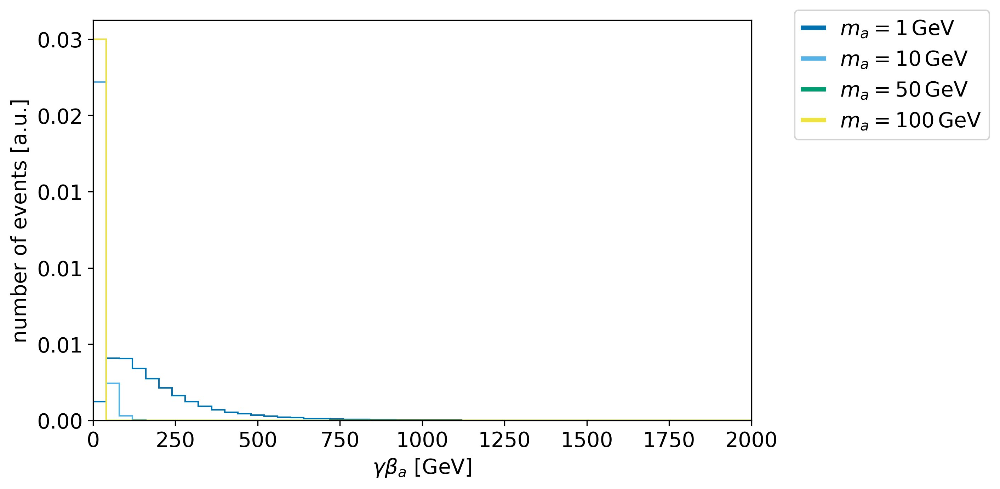

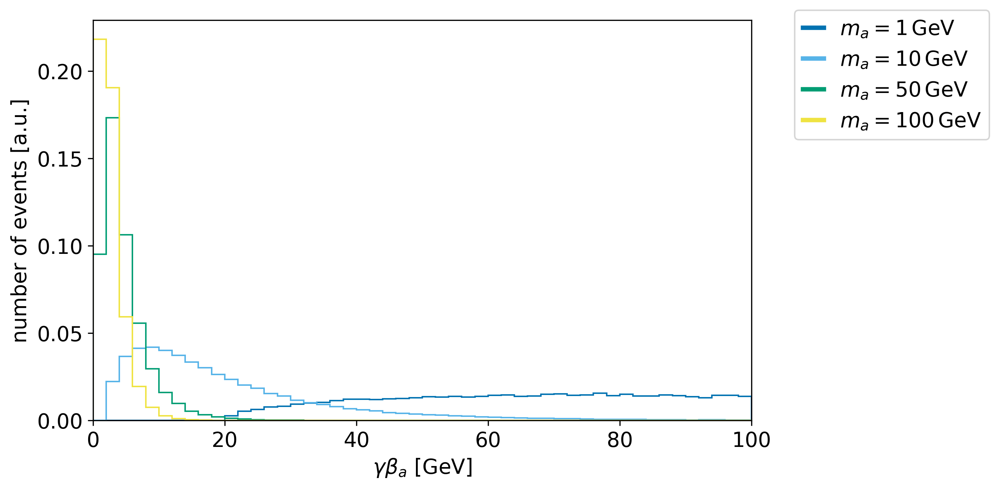

In [38]:
mypl.hist1d(data("boost",["alp"],"incl"),massLabels2,dirLabel["boost_a"],customXlim=[0,2000])
mypl.hist1d(data("boost",["alp"],"incl"),massLabels2,dirLabel["boost_a"],customXlim=[0,100])

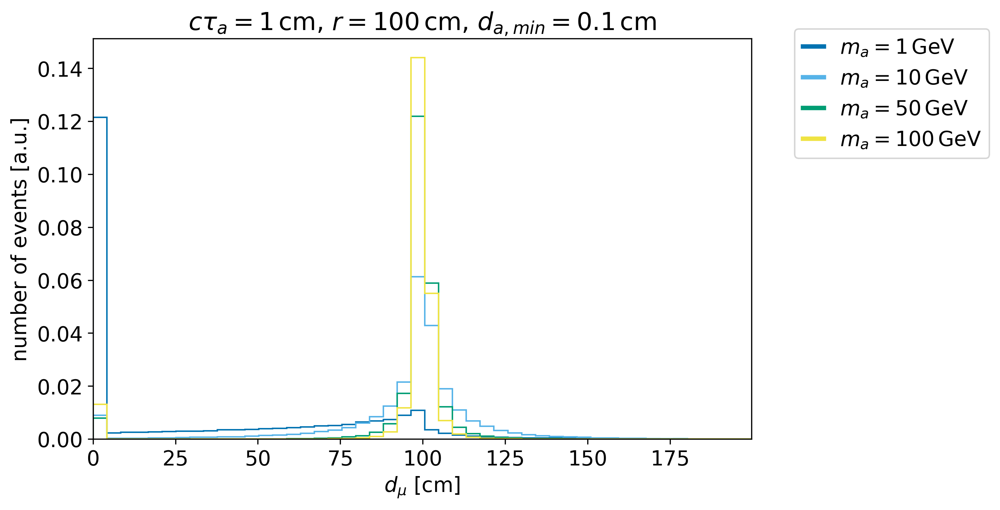

In [106]:
mypl.hist1d(data("track_from_ctau",["alp","muon"],"incl",radius=100,ctau=1,minimum_displacement=0.1),massLabels2,dirLabel["track_mu"],outputpath+"Tracklength_at_100_1_0p1.png", title=r"$c\tau_a=1\,$cm, $r=100\,$cm, $d_{a, min}=0.1\,$cm")

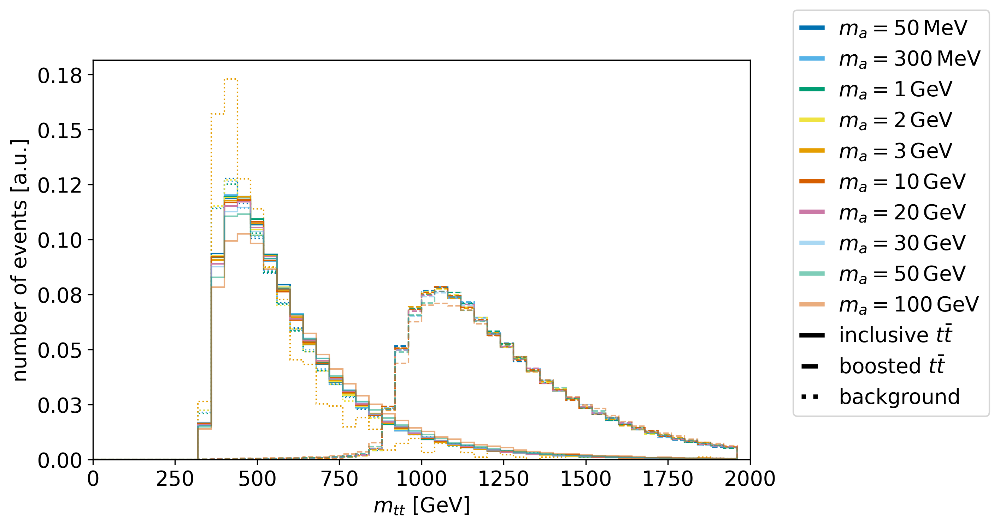

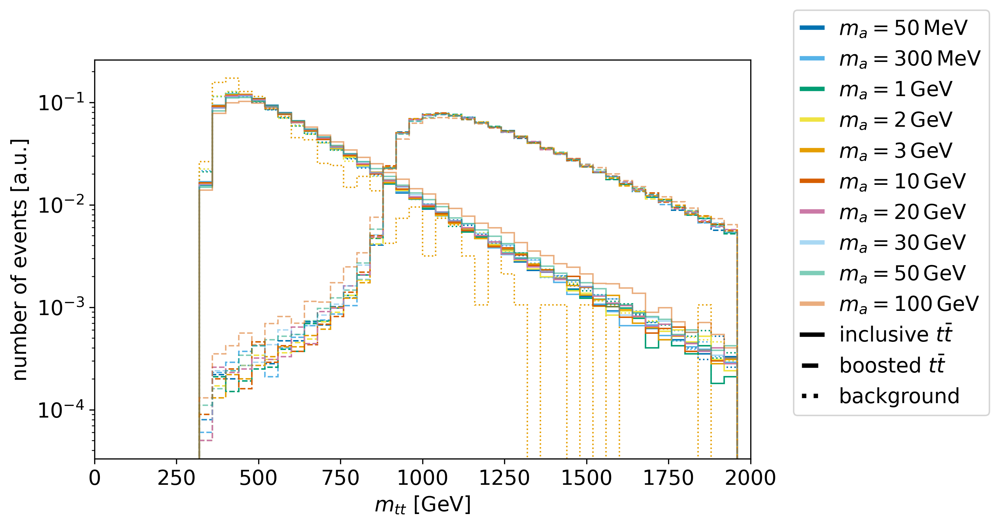

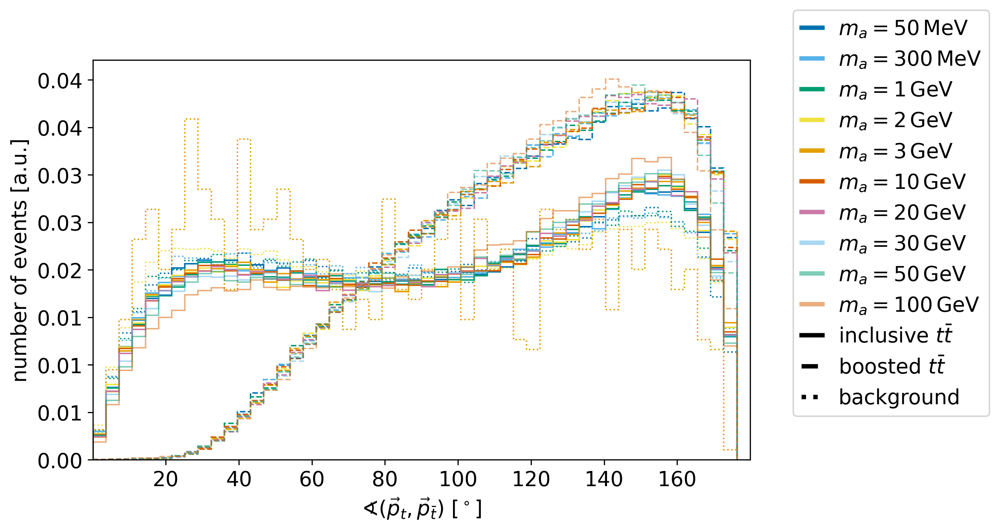

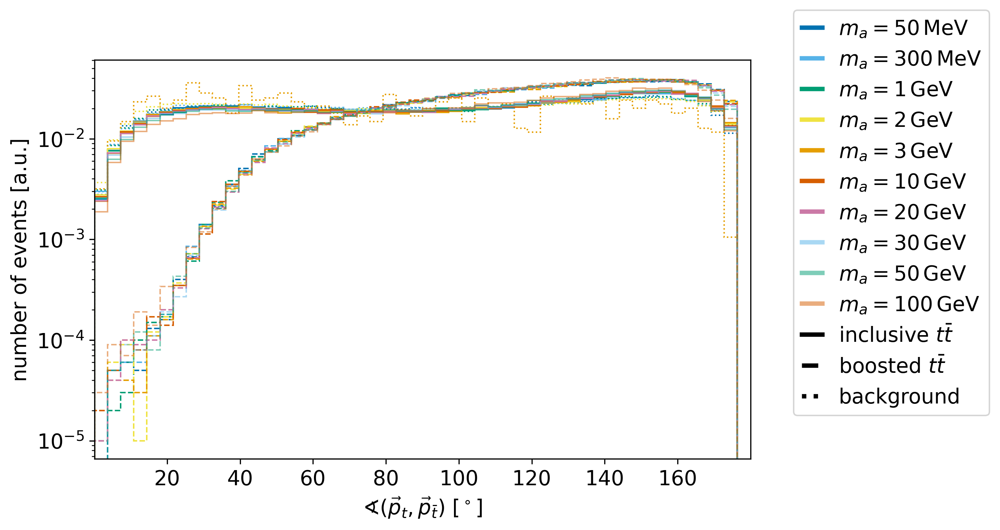

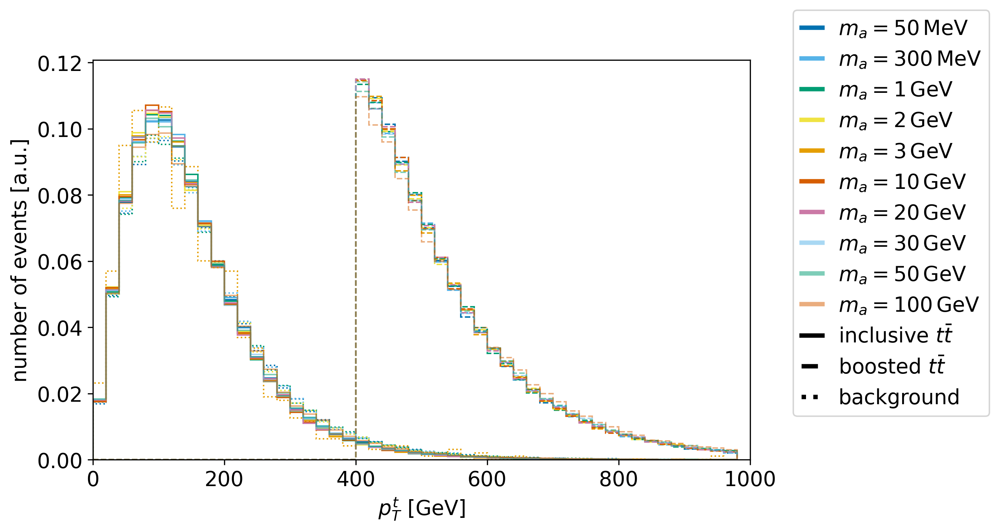

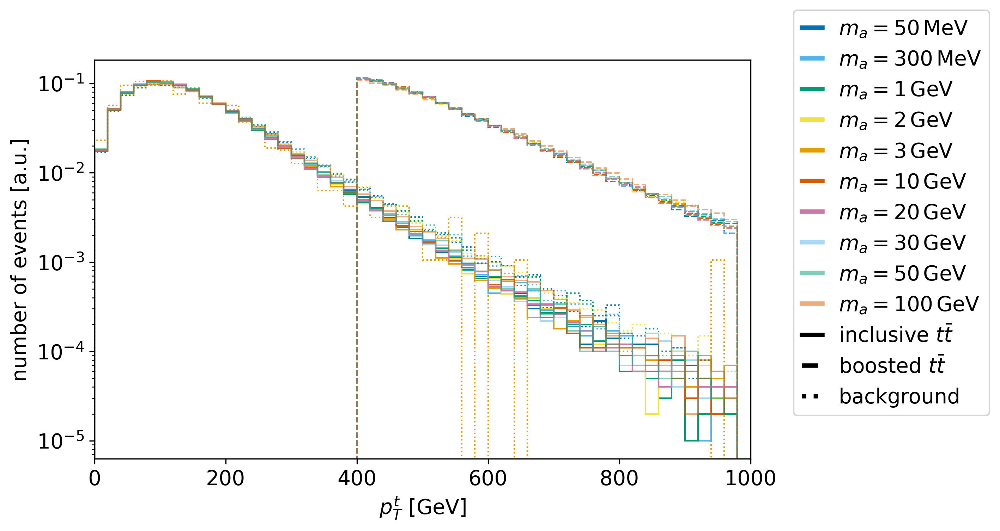

In [ ]:
# kinematics of the inclusive and boosted signal events and the ttmumu+ttj background events
mypl.hist1dcomp(data("inv_mass",["top","antitop"],"incl"), data("inv_mass",["top","antitop"],"boost"), data("inv_mass",["top","antitop"],"bkg"),massLabels,dirLabel["mtt"],outputpath+"mtt_cwb_ttj_lin.png",customXlim=[0,2000],customXlabels=labels_bkg, log_scale=False)
mypl.hist1dcomp(data("inv_mass",["top","antitop"],"incl"), data("inv_mass",["top","antitop"],"boost"), data("inv_mass",["top","antitop"],"bkg"),massLabels,dirLabel["mtt"],outputpath+"mtt_cwb_ttj_log.png",customXlim=[0,2000],customXlabels=labels_bkg, log_scale=True)
#mypl.hist1dcompden(data("inv_mass",["top","antitop"],"incl"),data("inv_mass",["top","antitop"],"bkg"),data("inv_mass",["top","antitop"],"ttj"),massLabels,dirLabel["mtt"],outputpath+"mtt_cwb_ttj_den.png",customXlim=[0,2000],customXlabels=labels_bkg)
mypl.hist1dcomp(data("oA",["top","antitop"],"incl"),data("oA",["top","antitop"],"boost"),data("oA",["top","antitop"],"bkg"),massLabels,dirLabel["oA_tat"],outputpath+"Angle_TopAntiTop_cwb_lin.png",customXlabels=labels_bkg)
mypl.hist1dcomp(data("oA",["top","antitop"],"incl"),data("oA",["top","antitop"],"boost"),data("oA",["top","antitop"],"bkg"),massLabels,dirLabel["oA_tat"],outputpath+"Angle_TopAntiTop_cwb_log.png",customXlabels=labels_bkg, log_scale = True)
#mypl.hist1dcomp(data("oA",["top","antitop"],"incl"),data("oA",["top","antitop"],"bkg"),data("oA",["top","antitop"],"ttj"),massLabels,dirLabel["oA_tat"],outputpath+"Angle_TopAntiTop_cwb_ttj.png",customXlabels=labels_bkg)
mypl.hist1dcomp(data("pT",["top"],"incl"),data("pT",["top"],"boost"),data("pT",["top"],"bkg"),massLabels,dirLabel["pT_t"],outputpath+"Top_pT_cwb_ttj_lin.png",customXlim=[0,1000],customXlabels=labels_bkg)
mypl.hist1dcomp(data("pT",["top"],"incl"),data("pT",["top"],"boost"),data("pT",["top"],"bkg"),massLabels,dirLabel["pT_t"],outputpath+"Top_pT_cwb_ttj_log.png",customXlim=[0,1000],customXlabels=labels_bkg, log_scale = True)
mypl.hist1dcomp(data("pT",["muon"],"incl"),data("pT",["muon"],"boost"),data("pT",["muon"],"bkg"),massLabels,dirLabel["pT_mu"],outputpath+"Muon_pT_cwb_lin.png",customXlim=[0,1000],customXlabels=labels_bkg)
mypl.hist1dcomp(data("pT",["muon"],"incl"),data("pT",["muon"],"boost"),data("pT",["muon"],"bkg"),massLabels,dirLabel["pT_mu"],outputpath+"Muon_pT_cwb_log.png",customXlim=[0,1000],customXlabels=labels_bkg, log_scale = True)
mypl.hist1dcomp(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"boost"),data("oA",["antimuon","muon"],"bkg"),massLabels,dirLabel["oA_muons"],outputpath+"Angle_Muons_cwb_lin.png",customXlabels=labels_bkg)
mypl.hist1dcomp(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"boost"),data("oA",["antimuon","muon"],"bkg"),massLabels,dirLabel["oA_muons"],outputpath+"Angle_Muons_cwb_log.png",customXlabels=labels_bkg, log_scale = True)